In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import datetime
import matplotlib as mpl
from matplotlib.lines import Line2D
from matplotlib import font_manager
from scipy import stats

font_dirs = [
    "../.local/share/fonts/otf/TexGyreHeros/"
]  # The path to the custom font file.
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
mpl.rcParams["font.family"] = ["TeX Gyre Heros", "sans-serif"]

In [2]:
# set a threshold on valid mutations (see analysis below at the protein level: `search hitchhiking`)
# this threshold is applied to only robertson dataset as Fabre et al. doesn't seem to have problems
VALID_VARIANT_AF = 0.02
bins = range(10, 112, 2)  # bin age
CHIP_THR_VAF = 0.02

In [3]:
def plot_trajectories_gene(ax, df, genes, colors):
    for gene, c in zip(genes, colors):
        df_per_gene = df.loc[df.Gene == gene, ["Age", "VAF", "Id"]]
        for id_ in df_per_gene.Id.unique():
            ax.plot(
                df_per_gene.loc[df_per_gene.Id == id_, "Age"],
                df_per_gene.loc[df_per_gene.Id == id_, "VAF"],
                color=c,
                marker=".",
                alpha=0.8,
            )
    ax.set_xlabel("Age (years)")
    ax.legend(
        handles=[
            Line2D([0], [0], color=c, lw=1, marker=".", label=g)
            for g, c in zip(genes, colors)
        ],
        frameon=True,
        fontsize=8,
    )
    return ax

## Fabre

In [4]:
fabre = pd.read_csv(
    "/mnt/c/Users/fra_t/Documents/PhD/hsc/fabre2022/ALLvariants_exclSynonymous_Xadj.txt",
    sep="\t",
)
# B) processing
# see https://gerstung-lab.github.io/ch-dynamics/Notebook_GrowthCoefficients_AgeAtOnset_PossibleAssociations.html for threshold
fabre["is_sequencing_artefact"] = fabre.VAF < 0.005
print(fabre.columns.to_list())
# drop donors that are excluded from the paper
# see https://github.com/josegcpa/clonal_dynamics/blob/158f670477a1c304252dae9f7682098b49cf04c5/Scripts/vaf_dynamics_functions.R#L81
# and https://figshare.com/articles/dataset/Data/15029118
donors2exclude = {26282, 12540, 3748, 3500, 3399, 4151, 3097, 24083, 3850}
tot_donors = fabre.SardID.unique().shape[0]
fabre.drop(index=fabre[fabre.SardID.isin(donors2exclude)].index, inplace=True)
assert tot_donors - len(donors2exclude) == fabre.SardID.unique().shape[0]
tot_donors = fabre.SardID.unique().shape[0]
tot_donors_valid = fabre.loc[~fabre.is_sequencing_artefact, "SardID"].unique().shape[0]
print(
    f"{tot_donors_valid} donors with valid variant over a total of {tot_donors} donors"
)
fabre["synonymous"] = False
print(f"{fabre.Gene.unique().shape[0]} genes")
print(f"[{fabre.Age.min()}-{fabre.Age.max()}] age interval")
fabre

['SardID', 'Gender', 'Phase', 'Age', 'Gene', 'CHR', 'START', 'END', 'REF', 'ALT', 'MUTcount_Xadj', 'WTcount', 'TOTALcount', 'VAF', 'Type', 'AAChange.refGene', 'is_sequencing_artefact']
384 donors with valid variant over a total of 385 donors
54 genes
[54.57-103.1] age interval


,SardID,Gender,Phase,Age,Gene,CHR,START,END,REF,ALT,MUTcount_Xadj,WTcount,TOTALcount,VAF,Type,AAChange.refGene,is_sequencing_artefact,synonymous
0,260,M,1,61.02,ASXL1,20,31023231.0,31023231.0,G,T,2.0,1578.0,1580.0,0.0013,stopgain,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False
1,260,M,2,64.02,ASXL1,20,31023231.0,31023231.0,G,T,1.0,1676.0,1677.0,0.0006,stopgain,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False
2,260,M,3,67.75,ASXL1,20,31023231.0,31023231.0,G,T,0.0,1266.0,1266.0,0.0000,stopgain,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False
3,260,M,4,71.09,ASXL1,20,31023231.0,31023231.0,G,T,1.0,1460.0,1461.0,0.0007,stopgain,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False
4,260,M,5,75.36,ASXL1,20,31023231.0,31023231.0,G,T,22.0,1516.0,1538.0,0.0143,stopgain,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4282,25087,M,5,74.40,ZRSR2,X,15840874.0,15840874.0,T,C,117.0,266.0,500.0,0.2340,nonsynonymous_SNV,ZRSR2:NM_005089:exon11:c.T958C:p.C320R,False,False
4283,33151,M,1,63.83,ZRSR2,X,15808631.0,15808631.0,G,A,0.0,555.0,555.0,0.0000,nonsynonymous_SNV,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,True,False
4284,33151,M,2,66.63,ZRSR2,X,15808631.0,15808631.0,G,A,2.5,380.0,385.0,0.0065,nonsynonymous_SNV,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,False,False
4285,33151,M,4,73.34,ZRSR2,X,15808631.0,15808631.0,G,A,0.0,451.0,451.0,0.0000,nonsynonymous_SNV,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,True,False


In [5]:
# normalise columns to merge with robertson later on
fabre["cohort"] = "Sard"
fabre["SardID"] = fabre["SardID"].astype(str)
fabre["SardID"] = "SardID_" + fabre.SardID
fabre.rename(columns={"AAChange.refGene": "AAChange", "SardID": "Id"}, inplace=True)
fabre.drop(
    columns=["Phase", "Type", "Gender"] + fabre.columns[5:13].to_list(), inplace=True
)
fabre

,Id,Age,Gene,VAF,AAChange,is_sequencing_artefact,synonymous,cohort
0,SardID_260,61.02,ASXL1,0.0013,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard
1,SardID_260,64.02,ASXL1,0.0006,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard
2,SardID_260,67.75,ASXL1,0.0000,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard
3,SardID_260,71.09,ASXL1,0.0007,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard
4,SardID_260,75.36,ASXL1,0.0143,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,False,False,Sard
...,...,...,...,...,...,...,...,...
4282,SardID_25087,74.40,ZRSR2,0.2340,ZRSR2:NM_005089:exon11:c.T958C:p.C320R,False,False,Sard
4283,SardID_33151,63.83,ZRSR2,0.0000,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,True,False,Sard
4284,SardID_33151,66.63,ZRSR2,0.0065,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,False,False,Sard
4285,SardID_33151,73.34,ZRSR2,0.0000,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,True,False,Sard


In [6]:
# I dont get the same data as in Fig1c of Fabre
# https://gerstung-lab.github.io/ch-dynamics/Notebook_GrowthCoefficients_AgeAtOnset_PossibleAssociations.html
# THIS IS WRONG!
def fig1c(df, ax):
    t = (
        df[["VAF", "Age_binned", "Id"]]
        .groupby(["Age_binned", "Id"])
        .count()
        .reset_index()
    )
    breaks = [0, 1, 2, 3, 4, 5, 100]
    breaks = pd.IntervalIndex.from_breaks(breaks, closed="left")
    t["VAF_binned"] = pd.cut(t.VAF, bins=breaks)
    assert not t.VAF_binned.isna().any()
    t_crossed = pd.crosstab(
        index=t["Age_binned"], columns=t["VAF_binned"], normalize="index"
    )
    t_crossed.plot(kind="barh", stacked=True, colormap="BuPu", ax=ax)
    ax.set_ylabel("Age (years)")
    ax.set_ylabel("Prevalence")
    ax.set_xlim([0, 1])
    ax.legend(
        title="No. of\nmutations",
        labels=[b.left for b in breaks],
        fontsize=12,
        loc="upper left",
        bbox_to_anchor=(1, 1),
        frameon=False,
    )
    return ax

/tmp/ipykernel_19901/1236198874.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(["Age_binned", "Id"])


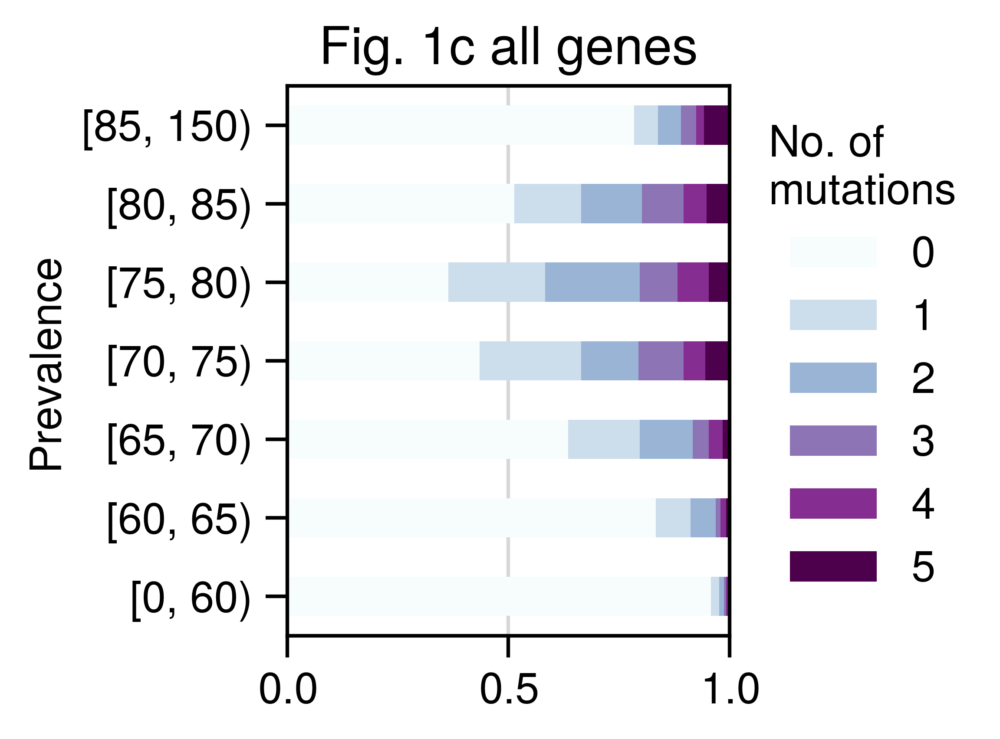

/tmp/ipykernel_19901/1236198874.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(["Age_binned", "Id"])


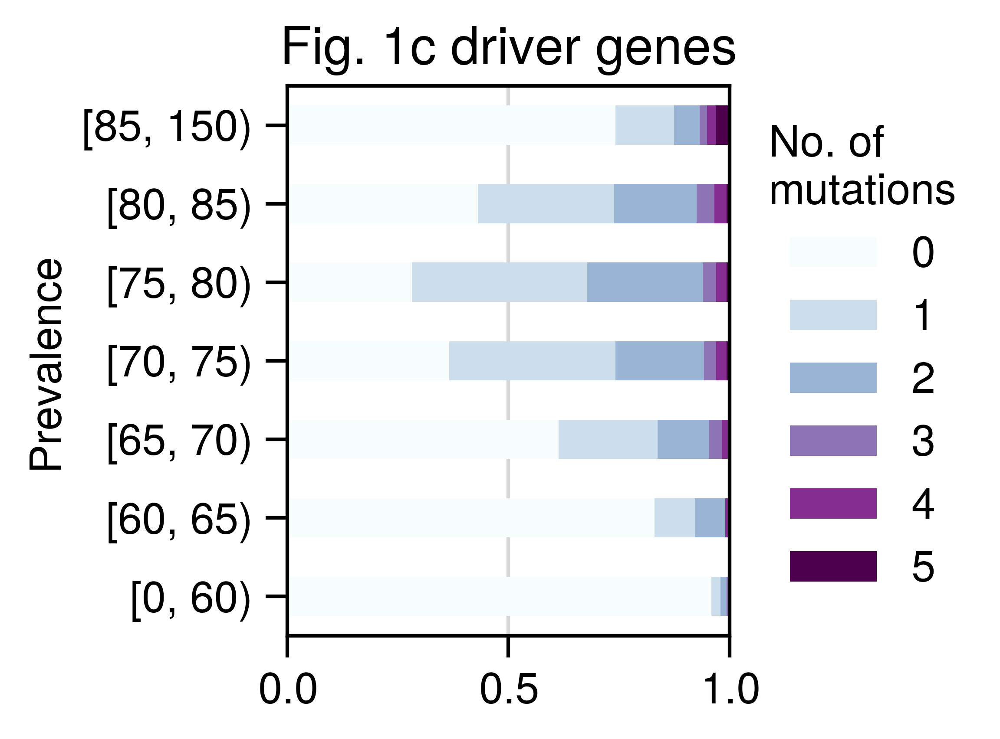

/tmp/ipykernel_19901/679890544.py:49: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(temp.reset_index(), x="Id", y="Gene", palette="Dark2", ax=ax)


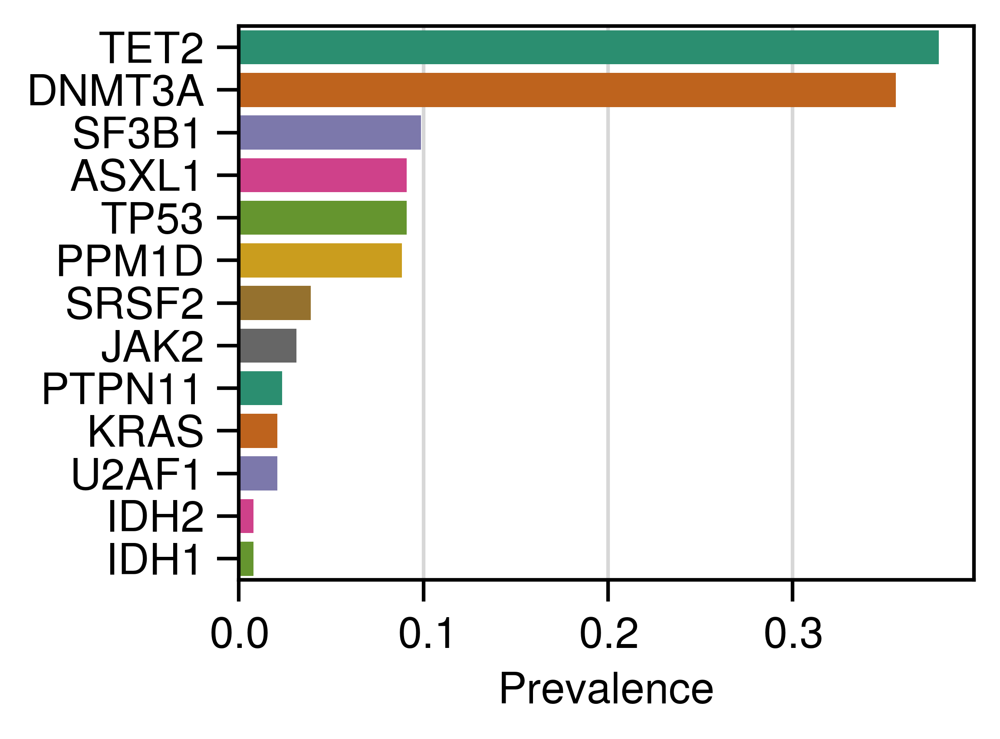

In [7]:
# reproduce fig 1c and 1d to check that I have the correct data
# driver genes CBL BRCC3 CTCF GNB1
genes = """DNMT3A
TET2
TP53
PPM1D
SF3B1
ASXL1
JAK2
SRSF2
KRAS
U2AF1
IDH1
IDH2
PTPN11""".split(
    "\n"
)
breaks = pd.IntervalIndex.from_breaks([0, 60, 65, 70, 75, 80, 85, 150], closed="left")
fabre["Age_binned"] = pd.cut(fabre.Age, bins=breaks)

# fig 1c
fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="tight")
ax = fig1c(fabre.loc[~fabre.is_sequencing_artefact, :], ax)
ax.set_title("Fig. 1c all genes")
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="tight")
ax = fig1c(
    fabre.loc[
        (~fabre.is_sequencing_artefact) & (fabre.Gene.isin(genes)), :
    ].drop_duplicates(subset=["Gene", "Age", "Id"]),
    ax,
)
ax.set_title("Fig. 1c driver genes")
plt.show()

# fig 1d
temp = (
    fabre.loc[
        (~fabre.is_sequencing_artefact) & (fabre.Gene.isin(genes)), ["Id", "Gene"]
    ]
    .drop_duplicates(subset=["Id", "Gene"])
    .groupby("Gene")
    .count()
    .sort_values(by="Id", ascending=False)
)
temp /= fabre.Id.unique().shape[0]
fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="tight")
sns.barplot(temp.reset_index(), x="Id", y="Gene", palette="Dark2", ax=ax)
ax.set_xlabel("Prevalence")
ax.set_ylabel("")
ax.tick_params(which="major", axis="y")
# ax.set_title("Fig. 1d top panel", fontsize=10)
plt.savefig("prev_genes.svg")
plt.show()

fabre.drop(columns=["Age_binned"], inplace=True)

In [8]:
fabre[fabre.Id == "SardID_12467"]

,Id,Age,Gene,VAF,AAChange,is_sequencing_artefact,synonymous,cohort
1229,SardID_12467,93.69,DNMT3A,0.0355,"DNMT3A:NM_001320893:exon18:c.G2189A:p.R730H,DN...",False,False,Sard
1230,SardID_12467,98.32,DNMT3A,0.0408,"DNMT3A:NM_001320893:exon18:c.G2189A:p.R730H,DN...",False,False,Sard
1231,SardID_12467,101.45,DNMT3A,0.0389,"DNMT3A:NM_001320893:exon18:c.G2189A:p.R730H,DN...",False,False,Sard
3670,SardID_12467,93.69,TET2,0.0290,"TET2:NM_001127208:exon3:c.C2746T:p.Q916X,TET2:...",False,False,Sard
3671,SardID_12467,93.69,TET2,0.0040,"TET2:NM_001127208:exon3:c.C2662T:p.Q888X,TET2:...",True,False,Sard
3672,SardID_12467,93.69,TET2,0.0028,TET2:NM_001127208:exon11:c.T5704C:p.Y1902H,True,False,Sard
3673,SardID_12467,98.32,TET2,0.0226,"TET2:NM_001127208:exon3:c.C2746T:p.Q916X,TET2:...",False,False,Sard
3674,SardID_12467,98.32,TET2,0.0094,"TET2:NM_001127208:exon3:c.C2662T:p.Q888X,TET2:...",False,False,Sard
3675,SardID_12467,98.32,TET2,0.0013,TET2:NM_001127208:exon11:c.T5704C:p.Y1902H,True,False,Sard
3676,SardID_12467,101.45,TET2,0.0302,"TET2:NM_001127208:exon3:c.C2746T:p.Q916X,TET2:...",False,False,Sard


## Roberston et al. 2022 Nature medicine
Get the data from [here](https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE178936), use only `1PCT` because we are interested in VAF > 0.01.
Indeed, the other tables `2PCT` are filtered versions of the tables `1PCT`, where only variants with VAF > 0.02 are kept.

Use both synonymous and non-synonymous tables.

To get the age of the donors, we need to do a bit of work. In the paper, they do not discriminate between the cohort `LBC1936` and the cohort `LBC1921` but those two are different.
To assign the average age to the correct donors, we can use the column `Participiant_ID`.

Found 6 with chemio i.e. VAF > 0.4
Age
70    1470
73    1556
76    1475
79    1376
82     103
85    2062
88    2022
91    1901
Name: count, dtype: int64
98.40% of entries with VAF lower than 0.02
53.87% percentage of outliers?
69 unique genes
82 donors
28 donors without any valid variant
[70-91] age interval
54 donors with valid variant over a total of 82 donors


,PreferredSymbol,type,HGVSp,protein_substitution,HGVSc,base_substitution,DP,AO,UAO,AF,...,X95MDAF,Variant_Classification,synonymous,Min_Outlier_PValue,TYPE,cohort,Age,is_sequencing_artefact,is_outlier,clone frequency
0,ATRX,snp,NP_000480.2:p.Asp818Glu,p.Asp818Glu,NM_000489.3:c.2454C>G,c.2454C>G,1997,21,5,0.0105,...,0.010516,Missense_Mutation,False,NaN,NaN,LBC21,85,True,False,0.0210
1,ATRX,snp,NP_000480.2:p.Asp818Glu,p.Asp818Glu,NM_000489.3:c.2454C>G,c.2454C>G,1724,12,1,0.0070,...,0.011601,Missense_Mutation,False,NaN,NaN,LBC21,88,True,False,0.0140
2,DDX41,snp,NP_057306.2:p.Ser405Arg,p.Ser405Arg,NM_016222.2:c.1213A>C,c.1213A>C,876,4,4,0.0046,...,0.021689,Missense_Mutation,False,NaN,NaN,LBC21,85,True,True,0.0092
3,DDX41,snp,NP_057306.2:p.Ser405Arg,p.Ser405Arg,NM_016222.2:c.1213A>C,c.1213A>C,880,11,4,0.0125,...,0.021591,Missense_Mutation,False,NaN,NaN,LBC21,88,True,False,0.0250
4,KMT2A,snp,NP_005924.2:p.Val46Ile,p.Val46Ile,NM_005933.3:c.136G>A,c.136G>A,629,4,2,0.0064,...,0.022258,Missense_Mutation,False,NaN,NaN,LBC21,85,True,True,0.0128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13712,DNMT3A,snp,NP_072046.2:p.Gly113=,p.Gly113=,NM_022552.4:c.339G>C,c.339G>C,1092,4,2,0.0037,...,0.019231,RNA,True,0.567744,SNP,LBC36,73,True,True,0.0074
13713,STAG2,snp,NP_006594.3:p.Thr624=,p.Thr624=,NM_006603.4:c.1872A>G,c.1872A>G,6287,72,51,0.0115,...,0.015111,Silent,True,0.138294,SNP,LBC36,70,True,True,0.0230
13714,STAG2,snp,NP_006594.3:p.Thr624=,p.Thr624=,NM_006603.4:c.1872A>G,c.1872A>G,5941,63,51,0.0106,...,0.015149,Silent,True,0.337939,SNP,LBC36,73,True,True,0.0212
13715,KMT2A,snp,NP_005924.2:p.Pro51=,p.Pro51=,NM_005933.3:c.153C>G,c.153C>G,444,6,5,0.0135,...,0.038288,5'Flank,True,0.035319,SNP,LBC36,70,True,True,0.0270


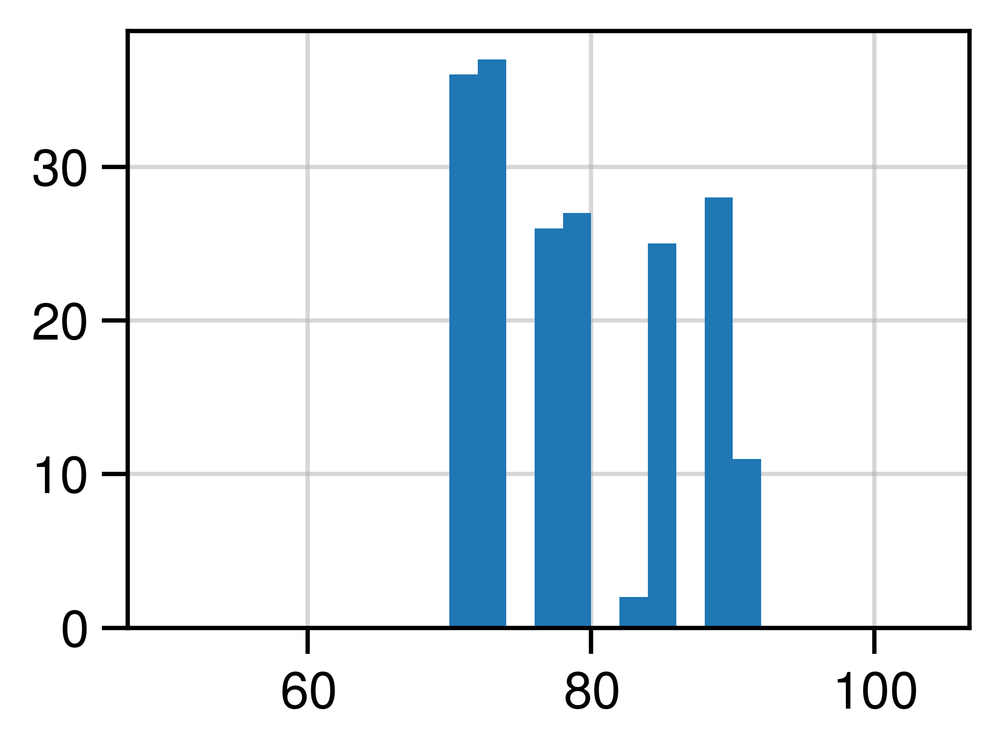

In [9]:
# A) load data
# 1. synonymous
data_synonymous = pd.read_csv(
    "/mnt/c/Users/fra_t/Documents/PhD/hsc/robertson2022/GSE178936_LBC_ARCHER.1PCT_VAF.Feb22.synonymous.tsv",
    sep="\t",
)
data_synonymous["synonymous"] = True
# 2. non-synonymous
robertson = pd.read_csv(
    "/mnt/c/Users/fra_t/Documents/PhD/hsc/robertson2022/GSE178936_LBC_ARCHER.1PCT_VAF.Feb22.non-synonymous.tsv",
    sep="\t",
)
robertson["synonymous"] = False
# 3. concat
robertson = pd.concat([robertson, data_synonymous], axis=0)
robertson.reset_index(inplace=True, drop=True)

# B) processing
robertson["cohort"] = robertson.participant_id.str.extract(r"CHIP_(.+)_.*").astype(
    "category"
)
# waves start at timepoint 0 and increase by 3 years at every timepoint
mapping = {i: ele for i, ele in enumerate((range(0, 3 * 5, 3)), 1)}
robertson["Age"] = robertson.wave.map(mapping)
robertson.loc[robertson.cohort == "LBC21", "Age"] += 79
robertson.loc[robertson.cohort == "LBC36", "Age"] += 70
robertson.dropna(subset="HGVSp", inplace=True)
# drop patients with chemio (see Robertson et al. 2022 Fig1H)
robertson[robertson.PreferredSymbol == "JAK2"].sort_values(by="AF", ascending=False)
# find the two participants that received the chemio based on the VAF of JAK2
# this will remove data that have mutations on many genes such as TP53, KMT2A, DNMT3A and NOTCH1
idx2drop = robertson[
    (robertson.PreferredSymbol == "JAK2") & (robertson.AF > 0.4)
].participant_id.to_list()
robertson.drop(
    index=robertson[robertson.participant_id.isin(idx2drop)].index,
    inplace=True,
)
print(f"Found {len(idx2drop)} with chemio i.e. VAF > 0.4")
print(robertson.Age.value_counts().sort_index())
# assume that = means synonymous
robertson["synonymous"] = robertson["synonymous"].where(
    ~robertson["HGVSp"].str.endswith("="), True
)
# set artefact based on the paper and the figures shown later on
robertson["is_sequencing_artefact"] = robertson.AF < VALID_VARIANT_AF
print(
    f"{robertson.is_sequencing_artefact.sum() / robertson.shape[0]:.2%} of entries with VAF lower than {VALID_VARIANT_AF}"
)
robertson["is_outlier"] = robertson.AF_Outlier_Pvalue >= 0.05  # not sure about this
print(f"{robertson.is_outlier.sum() / robertson.shape[0]:.2%} percentage of outliers?")
print(f"{robertson.PreferredSymbol.unique().shape[0]} unique genes")
robertson["clone frequency"] = robertson.AF * 2
print(f"{robertson.participant_id.unique().shape[0]} donors")
print(
    f"{robertson.participant_id.unique().shape[0] - robertson.loc[~robertson.is_sequencing_artefact, 'participant_id'].unique().shape[0]} donors without any valid variant"
)
print(f"[{robertson.Age.min()}-{robertson.Age.max()}] age interval")
robertson[~robertson.is_sequencing_artefact].Age.hist(bins=range(50, 105, 2))
tot_donors = robertson.participant_id.unique().shape[0]
tot_donors_valid = (
    robertson.loc[~robertson.is_sequencing_artefact, "participant_id"].unique().shape[0]
)
print(
    f"{tot_donors_valid} donors with valid variant over a total of {tot_donors} donors"
)
robertson

In [10]:
# normalise columns to merge with fabre
robertson.rename(
    columns={
        "PreferredSymbol": "Gene",
        "AF": "VAF",
        "participant_id": "Id",
        "HGVSp": "AAChange",
    },
    inplace=True,
)
robertson.drop(
    columns=robertson.columns[3:9].to_list()
    + robertson.columns[11:39].to_list()
    + ["TYPE", "Min_Outlier_PValue", "is_outlier", "type", "wave", "clone frequency"],
    inplace=True,
)
robertson

,Gene,AAChange,VAF,Id,synonymous,cohort,Age,is_sequencing_artefact
0,ATRX,NP_000480.2:p.Asp818Glu,0.0105,CHIP_LBC21_001,False,LBC21,85,True
1,ATRX,NP_000480.2:p.Asp818Glu,0.0070,CHIP_LBC21_001,False,LBC21,88,True
2,DDX41,NP_057306.2:p.Ser405Arg,0.0046,CHIP_LBC21_001,False,LBC21,85,True
3,DDX41,NP_057306.2:p.Ser405Arg,0.0125,CHIP_LBC21_001,False,LBC21,88,True
4,KMT2A,NP_005924.2:p.Val46Ile,0.0064,CHIP_LBC21_001,False,LBC21,85,True
...,...,...,...,...,...,...,...,...
13712,DNMT3A,NP_072046.2:p.Gly113=,0.0037,CHIP_LBC36_043,True,LBC36,73,True
13713,STAG2,NP_006594.3:p.Thr624=,0.0115,CHIP_LBC36_043,True,LBC36,70,True
13714,STAG2,NP_006594.3:p.Thr624=,0.0106,CHIP_LBC36_043,True,LBC36,73,True
13715,KMT2A,NP_005924.2:p.Pro51=,0.0135,CHIP_LBC36_043,True,LBC36,70,True


## The lifeline dataset
Publication [link](https://www.cell.com/cancer-cell/fulltext/S1535-6108(23)00132-0).

In [11]:
vanZenter_pheno = pd.read_csv(
    "/mnt/c/Users/fra_t/Documents/PhD/hsc/vanZeventer2023/phenotype_dataset.csv",
    sep=";",
)
vanZenter_pheno.rename(
    columns={
        "date_diff_baseline_FU": "FU",
        "date_diff_FU_thirdvisit": "thirdvisit",
        "age": "baseline",
        "indiv_ID": "Id",
    },
    inplace=True,
)

In [12]:
vanZenter = pd.read_csv(
    "/mnt/c/Users/fra_t/Documents/PhD/hsc/vanZeventer2023/variant_dataset.csv",
    sep=";",
)
vanZenter_pheno = pd.read_csv(
    "/mnt/c/Users/fra_t/Documents/PhD/hsc/vanZeventer2023/phenotype_dataset.csv",
    sep=";",
)
vanZenter_pheno.rename(
    columns={
        "date_diff_baseline_FU": "FU",
        "date_diff_FU_thirdvisit": "thirdvisit",
        "age": "baseline",
        "indiv_ID": "Id",
    },
    inplace=True,
)
vanZenter_pheno["FU"] = vanZenter_pheno["baseline"] + vanZenter_pheno["FU"] / 12
vanZenter_pheno["thirdvisit"] = (
    vanZenter_pheno["FU"] + vanZenter_pheno["thirdvisit"] / 12
)
for col in ["FU", "thirdvisit"]:
    vanZenter_pheno[col] = vanZenter_pheno[col].round(2)
vanZenter_pheno.drop(
    columns=[
        "anemia",
        "erythrocytosis",
        "included_thirdvisit",
        "thrombocytopenia",
        "thrombocytosis",
        "neutropenia",
        "leukocytosis",
    ],
    inplace=True,
)
vanZenter_pheno = pd.melt(
    vanZenter_pheno,
    id_vars=["Id", "sex"],
    value_vars=["baseline", "FU", "thirdvisit"],
    value_name="Age",
)
vanZenter_pheno.dropna(inplace=True)
vanZenter.rename(
    columns={
        "VAF_baseline": "baseline",
        "VAF_FU": "FU",
        "VAF_thirdvisit": "thirdvisit",
        "indiv_ID": "Id",
        "gene": "Gene",
        "protein_change": "AAChange",
    },
    inplace=True,
)
vanZenter = pd.melt(
    vanZenter,
    id_vars=["Id", "Gene", "AAChange", "variant_class"],
    value_vars=["baseline", "FU", "thirdvisit"],
    value_name="VAF",
)
vanZenter.dropna(inplace=True)
vanZenter.VAF /= 100
vanZenter = pd.merge(
    right=vanZenter,
    left=vanZenter_pheno,
    on=["Id", "variable"],
    how="right",
    validate="one_to_many",
)
vanZenter["cohort"] = "lifeline"
vanZenter["is_sequencing_artefact"] = vanZenter.VAF < 0.005
vanZenter["synonymous"] = vanZenter.variant_class == "Synonymous"
vanZenter.drop(columns=["variant_class", "variable", "sex"], inplace=True)
vanZenter.drop(index=vanZenter[vanZenter.VAF >= 0.6].index, inplace=True)
print(
    f"Unique donors {vanZenter.Id.unique().shape[0]}, genes {vanZenter.Gene.unique().shape[0]}"
)
vanZenter

Unique donors 1502, genes 25


,Id,Age,Gene,AAChange,VAF,cohort,is_sequencing_artefact,synonymous
0,2589,67.00,ASXL1,Gln588Ter,0.110,lifeline,False,False
1,3122,67.00,ASXL1,Glu635ArgfsTer15,0.049,lifeline,False,False
2,3359,63.00,ASXL1,Glu635ArgfsTer15,0.049,lifeline,False,False
3,237,63.00,ASXL1,Glu635ArgfsTer15,0.013,lifeline,False,False
4,1399,78.00,ASXL1,Gly646TrpfsTer12,0.260,lifeline,False,False
...,...,...,...,...,...,...,...,...
3988,348,75.75,TP53,Ser241Ala,0.012,lifeline,False,False
3989,3329,77.75,TP53,Ile254Asn,0.011,lifeline,False,False
3990,3273,75.17,TP53,Gly266Val,0.013,lifeline,False,False
3991,299,73.92,U2AF1,Arg156His,0.011,lifeline,False,False


<Axes: >

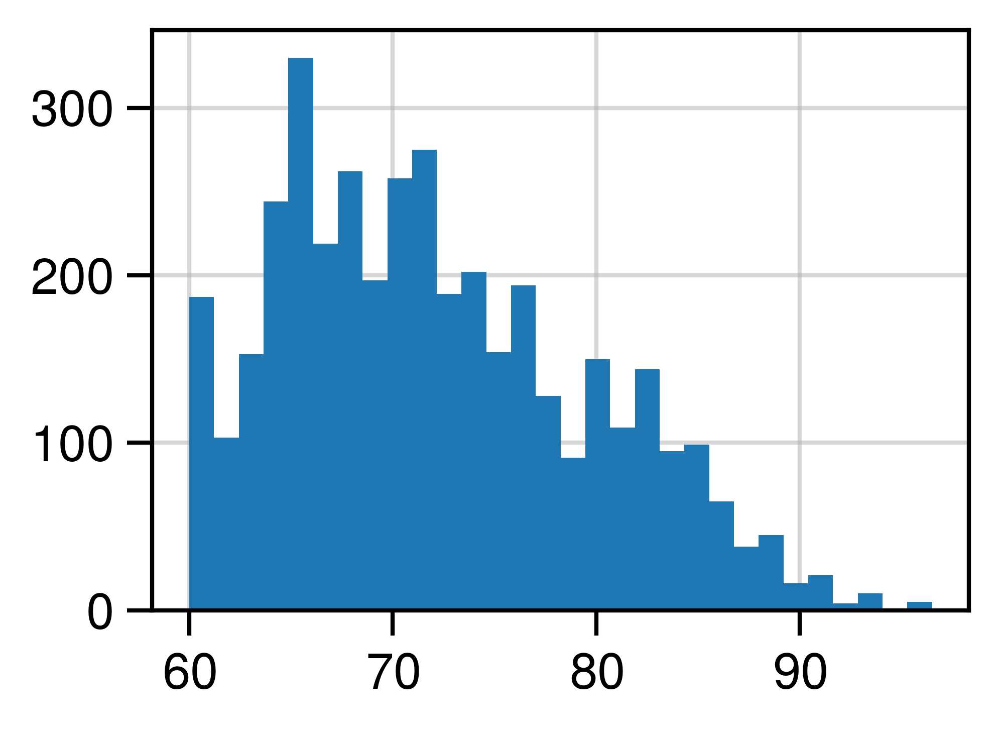

In [13]:
vanZenter.Age.hist(bins=30)

## Concat the datasets

In [14]:
data = pd.concat([fabre, robertson, vanZenter], axis=0)
data.reset_index(inplace=True, drop=True)
data.cohort = data.cohort.astype("category")
data["Age_binned"] = pd.cut(data.Age, bins=bins).map(lambda ele: ele.mid).astype(int)
data.dropna(subset="VAF", inplace=True)
assert (
    data.loc[data.cohort.str.startswith("LBC"), "Age_binned"].unique().shape[0]
    == data.loc[data.cohort.str.startswith("LBC"), "Age"].unique().shape[0]
)
entries = data.shape[0]
data.Age_binned = data.Age_binned.map(round).astype(int)
data.drop_duplicates(subset=["Id", "Age_binned", "AAChange"], inplace=True)
print(
    f"after binning age we have {data.shape[0]} entries: I have dropped {entries - data.shape[0]} mutations"
)
data.rename(columns={"Age": "Age_unbinned"}, inplace=True)
data.rename(columns={"Age_binned": "Age"}, inplace=True)
print(data.dtypes)
print(f"{data.Id.unique().shape[0]} donors")
print(f"{data.Gene.unique().shape[0]} genes")
print(f"{data[~data.is_sequencing_artefact].shape[0]} valid mutations")
data

after binning age we have 19889 entries: I have dropped 42 mutations
Id                          object
Age_unbinned               float64
Gene                        object
VAF                        float64
AAChange                    object
is_sequencing_artefact        bool
synonymous                    bool
cohort                    category
Age                          int64
dtype: object
1923 donors
78 genes
6460 valid mutations


,Id,Age_unbinned,Gene,VAF,AAChange,is_sequencing_artefact,synonymous,cohort,Age
0,SardID_260,61.02,ASXL1,0.0013,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,61
1,SardID_260,64.02,ASXL1,0.0006,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,65
2,SardID_260,67.75,ASXL1,0.0000,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,67
3,SardID_260,71.09,ASXL1,0.0007,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,71
4,SardID_260,75.36,ASXL1,0.0143,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,False,False,Sard,75
...,...,...,...,...,...,...,...,...,...
20122,348,75.75,TP53,0.0120,Ser241Ala,False,False,lifeline,75
20123,3329,77.75,TP53,0.0110,Ile254Asn,False,False,lifeline,77
20124,3273,75.17,TP53,0.0130,Gly266Val,False,False,lifeline,75
20125,299,73.92,U2AF1,0.0110,Arg156His,False,False,lifeline,73


## Uniformise the AA
Count the number of variants accross the two datasets. For now I'm missing the genes.

In [15]:
import re
from Bio.SeqUtils import seq1

variant_re = re.compile(r"p\.[A-Za-z]+\d+.*")

In [16]:
# robertson
aa_robertson = data.loc[
    data.cohort.isin({"LBC21", "LBC36"}),
    ["Gene", "AAChange", "cohort"],
]
aa_robertson = pd.concat(
    [
        aa_robertson,
        aa_robertson.AAChange.str.split(r"p\.", expand=True)
        .iloc[:, -1]
        .str.extract(
            r"(?P<initial>[A-Za-z]+)(?P<position>\d+)(?P<final>[A-Za-z=]+)", expand=True
        ),
    ],
    axis=1,
)
aa_vanZeventer = data.loc[
    data.cohort == "lifeline",
    ["Gene", "AAChange", "cohort"],
]
aa_vanZeventer = pd.concat(
    [
        aa_vanZeventer.AAChange.str.extract(
            r"(?P<initial>[A-Za-z]+)(?P<position>\d+)(?P<final>[A-Za-z=]+)", expand=True
        ),
        aa_vanZeventer,
    ],
    axis=1,
)
for aa in [aa_robertson, aa_vanZeventer]:
    aa.dropna(inplace=True)
    aa.initial = aa.initial.map(seq1)
    aa.final = aa.final.where(
        (aa.final == "=")
        | (aa.final.str.contains("fs"))
        | (aa.final.str.contains("del")),
        aa.final.map(seq1),
    )
    # frameshift deletion
    aa.final = aa.final.where(~aa.final.str.contains("fs"), "fs")
    aa.final = aa.final.where(~aa.final.str.contains("del"), "del")
    aa["AAChange_standard"] = (
        aa.Gene + "_p." + aa.initial + aa.position.astype("str") + aa.final
    )
    aa.drop(columns=["initial", "position", "final"], inplace=True)
aa_robertson

,Gene,AAChange,cohort,AAChange_standard
4175,ATRX,NP_000480.2:p.Asp818Glu,LBC21,ATRX_p.D818E
4176,ATRX,NP_000480.2:p.Asp818Glu,LBC21,ATRX_p.D818E
4177,DDX41,NP_057306.2:p.Ser405Arg,LBC21,DDX41_p.S405R
4178,DDX41,NP_057306.2:p.Ser405Arg,LBC21,DDX41_p.S405R
4179,KMT2A,NP_005924.2:p.Val46Ile,LBC21,KMT2A_p.V46I
...,...,...,...,...
16135,DNMT3A,NP_072046.2:p.Gly113=,LBC36,DNMT3A_p.G113=
16136,STAG2,NP_006594.3:p.Thr624=,LBC36,STAG2_p.T624=
16137,STAG2,NP_006594.3:p.Thr624=,LBC36,STAG2_p.T624=
16138,KMT2A,NP_005924.2:p.Pro51=,LBC36,KMT2A_p.P51=


In [17]:
aa_fabre = data.loc[
    data.cohort == "Sard",
    ["Gene", "AAChange", "cohort"],
].dropna()
aa_fabre["AAChange_standard"] = aa_fabre.AAChange.str.split(":", expand=False).map(
    lambda ele: ele[-1]
)
aa_fabre.AAChange_standard = aa_fabre.Gene + "_" + aa_fabre.AAChange_standard
aa_fabre

,Gene,AAChange,cohort,AAChange_standard
0,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,Sard,ASXL1_p.E906X
1,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,Sard,ASXL1_p.E906X
2,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,Sard,ASXL1_p.E906X
3,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,Sard,ASXL1_p.E906X
4,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,Sard,ASXL1_p.E906X
...,...,...,...,...
4170,ZRSR2,ZRSR2:NM_005089:exon11:c.T958C:p.C320R,Sard,ZRSR2_p.C320R
4171,ZRSR2,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,Sard,ZRSR2_p.E5K
4172,ZRSR2,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,Sard,ZRSR2_p.E5K
4173,ZRSR2,ZRSR2:NM_005089:exon1:c.G13A:p.E5K,Sard,ZRSR2_p.E5K


In [18]:
aa_all = pd.concat(
    [
        aa_vanZeventer[["AAChange", "AAChange_standard", "cohort"]],
        aa_fabre[["AAChange", "AAChange_standard", "cohort"]],
        aa_robertson[["AAChange", "AAChange_standard", "cohort"]],
    ],
    axis=0,
).drop_duplicates(subset=["AAChange", "cohort"])
before = data.shape[0]
data = pd.merge(
    left=data,
    right=aa_all,
    how="left",
    on=["AAChange", "cohort"],
    validate="many_to_one",
)
assert data.shape[0] == before
data

,Id,Age_unbinned,Gene,VAF,AAChange,is_sequencing_artefact,synonymous,cohort,Age,AAChange_standard
0,SardID_260,61.02,ASXL1,0.0013,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,61,ASXL1_p.E906X
1,SardID_260,64.02,ASXL1,0.0006,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,65,ASXL1_p.E906X
2,SardID_260,67.75,ASXL1,0.0000,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,67,ASXL1_p.E906X
3,SardID_260,71.09,ASXL1,0.0007,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,71,ASXL1_p.E906X
4,SardID_260,75.36,ASXL1,0.0143,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,False,False,Sard,75,ASXL1_p.E906X
...,...,...,...,...,...,...,...,...,...,...
19884,348,75.75,TP53,0.0120,Ser241Ala,False,False,lifeline,75,TP53_p.S241A
19885,3329,77.75,TP53,0.0110,Ile254Asn,False,False,lifeline,77,TP53_p.I254N
19886,3273,75.17,TP53,0.0130,Gly266Val,False,False,lifeline,75,TP53_p.G266V
19887,299,73.92,U2AF1,0.0110,Arg156His,False,False,lifeline,73,U2AF1_p.R156H


In [19]:
data.loc[
    (~data.is_sequencing_artefact) & (data.AAChange_standard.str.startswith("JAK2")),
    ["Id", "AAChange_standard"],
].drop_duplicates().Id.tolist()

['SardID_847',
 'SardID_1904',
 'SardID_2141',
 'SardID_3200',
 'SardID_4435',
 'SardID_4547',
 'SardID_11184',
 'SardID_12395',
 'SardID_18419',
 'SardID_22109',
 'SardID_24850',
 'SardID_25087',
 'CHIP_LBC21_010',
 'CHIP_LBC36_004',
 'CHIP_LBC36_007',
 'CHIP_LBC36_022',
 'CHIP_LBC36_026',
 1935,
 2485,
 2009,
 2990,
 464,
 1765,
 58,
 1650,
 1428,
 2949,
 784,
 1491,
 451,
 2068,
 796,
 1233,
 2888,
 432,
 3253,
 550,
 587,
 2486,
 39,
 754,
 982,
 2205,
 1541,
 739,
 2271,
 2891,
 659,
 1049,
 2229,
 648,
 1994,
 3168,
 2508,
 2233,
 1885,
 3229,
 1666,
 1783,
 736,
 2203,
 2069,
 2382,
 2781,
 1972,
 2837,
 1695,
 1375]

In [20]:
data.loc[
    ~data.is_sequencing_artefact, ["Id", "AAChange_standard"]
].drop_duplicates().AAChange_standard.value_counts().head(20)

AAChange_standard
JAK2_p.V617F      67
DNMT3A_p.R882H    49
ASXL1_p.G646fs    33
SRSF2_p.P95H      26
SF3B1_p.K700E     26
DNMT3A_p.R882C    21
TET2_p.I1873T     20
DNMT3A_p.Y735C    20
SF3B1_p.K666N     20
DNMT3A_p.P904L    19
DNMT3A_p.W860R    15
DNMT3A_p.W305*    15
DNMT3A_p.V657M    14
DNMT3A_p.R635Q    14
DNMT3A_p.R736H    14
ASXL1_p.E635fs    12
DNMT3A_p.S770L    12
DNMT3A_p.R635W    12
DNMT3A_p.R736C    11
DNMT3A_p.R729W    10
Name: count, dtype: int64

In [21]:
data.loc[~data.is_sequencing_artefact, ["Id", "AAChange_standard", "VAF"]].groupby(
    ["Id", "AAChange_standard"]
).count().squeeze().sort_values(ascending=False)

Id            AAChange_standard
SardID_30656  TET2_p.F681fs        5
SardID_3200   JAK2_p.V617F         5
SardID_693    TET2_p.C1289F        5
SardID_5946   TET2_p.G1861V        5
SardID_5656   BCOR_p.D782N         5
                                  ..
SardID_95     STAG2_p.E143D        1
SardID_869    SMC3_p.K461M         1
29            DNMT3A_p.R736C       1
27            TET2_p.S1638fs       1
25            DNMT3A_p.K433del     1
Name: VAF, Length: 3398, dtype: int64

In [22]:
data[data.AAChange_standard == "RAD21_p.L388="]

,Id,Age_unbinned,Gene,VAF,AAChange,is_sequencing_artefact,synonymous,cohort,Age,AAChange_standard
4055,CHIP_LBC21_002,85.0,RAD21,0.0082,NP_006256.1:p.Leu388=,True,True,LBC21,85,RAD21_p.L388=
4056,CHIP_LBC21_002,88.0,RAD21,0.0074,NP_006256.1:p.Leu388=,True,True,LBC21,87,RAD21_p.L388=
4057,CHIP_LBC21_002,91.0,RAD21,0.0106,NP_006256.1:p.Leu388=,True,True,LBC21,91,RAD21_p.L388=
4221,CHIP_LBC21_004,85.0,RAD21,0.0111,NP_006256.1:p.Leu388=,True,True,LBC21,85,RAD21_p.L388=
4222,CHIP_LBC21_004,88.0,RAD21,0.0076,NP_006256.1:p.Leu388=,True,True,LBC21,87,RAD21_p.L388=
...,...,...,...,...,...,...,...,...,...,...
12034,CHIP_LBC36_038,79.0,RAD21,0.0108,NP_006256.1:p.Leu388=,True,True,LBC36,79,RAD21_p.L388=
12321,CHIP_LBC36_042,70.0,RAD21,0.0135,NP_006256.1:p.Leu388=,True,True,LBC36,69,RAD21_p.L388=
12322,CHIP_LBC36_042,73.0,RAD21,0.0108,NP_006256.1:p.Leu388=,True,True,LBC36,73,RAD21_p.L388=
12323,CHIP_LBC36_042,76.0,RAD21,0.0099,NP_006256.1:p.Leu388=,True,True,LBC36,75,RAD21_p.L388=


In [23]:
# check that RAD21_p.L388= is syn
assert data.loc[data.AAChange_standard == "RAD21_p.L388=", "synonymous"].all()

['SardID_3200', 'CHIP_LBC36_026', 'SardID_847', 'CHIP_LBC36_007', 'SardID_25087', 'CHIP_LBC36_022', 'SardID_2141', 'SardID_22109', 'SardID_12395', 58, 'SardID_1904', 1935, 'CHIP_LBC21_010', 2485, 'SardID_11184', 2990, 464, 2009, 'SardID_4435', 784, 1491, 451, 2068, 1765, 1650, 1428, 2949, 796, 1233, 2888, 432, 2486, 587, 550, 3253, 1994, 3168, 2508, 2203, 39, 754, 982, 2205, 1541, 739, 2271, 2891, 659, 1049, 2229, 648]


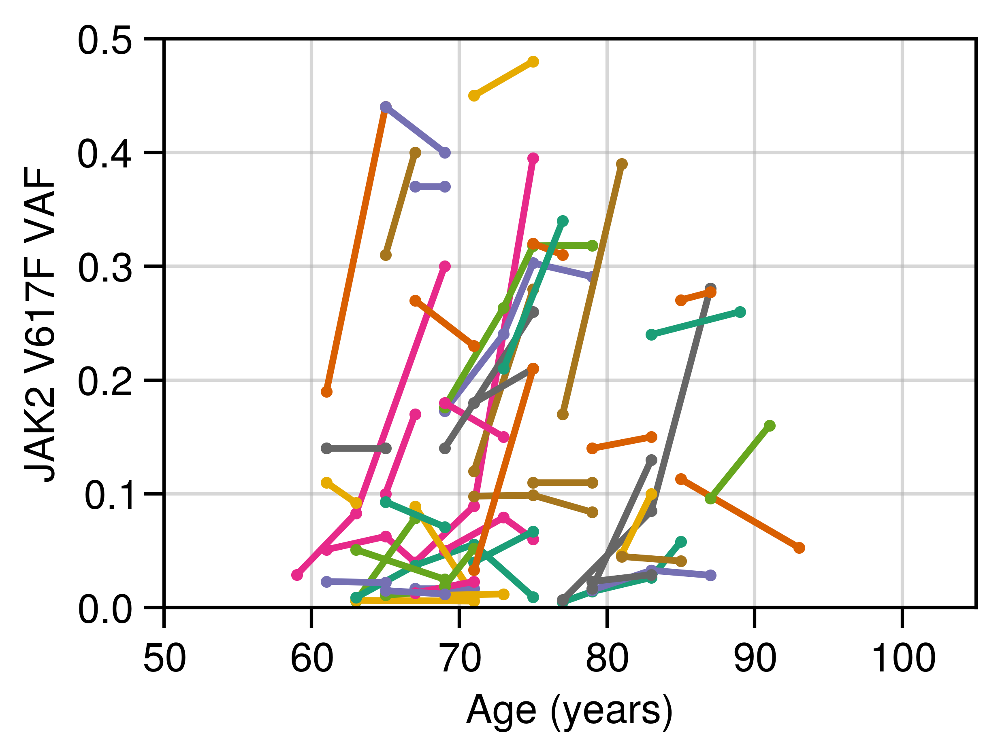

['SardID_1172', 'SardID_4240', 'SardID_4669', 'SardID_2842', 'SardID_12467', 2056, 623, 1722, 'SardID_23386', 2812, 2533, 1609, 2882, 3351, 1530, 51, 91, 1278, 1888, 2755, 2423, 2648, 1766, 1444, 2497, 1283, 2486, 749, 2402, 3019, 1219, 2155, 3012, 1793, 1943, 1799, 1699, 1509]


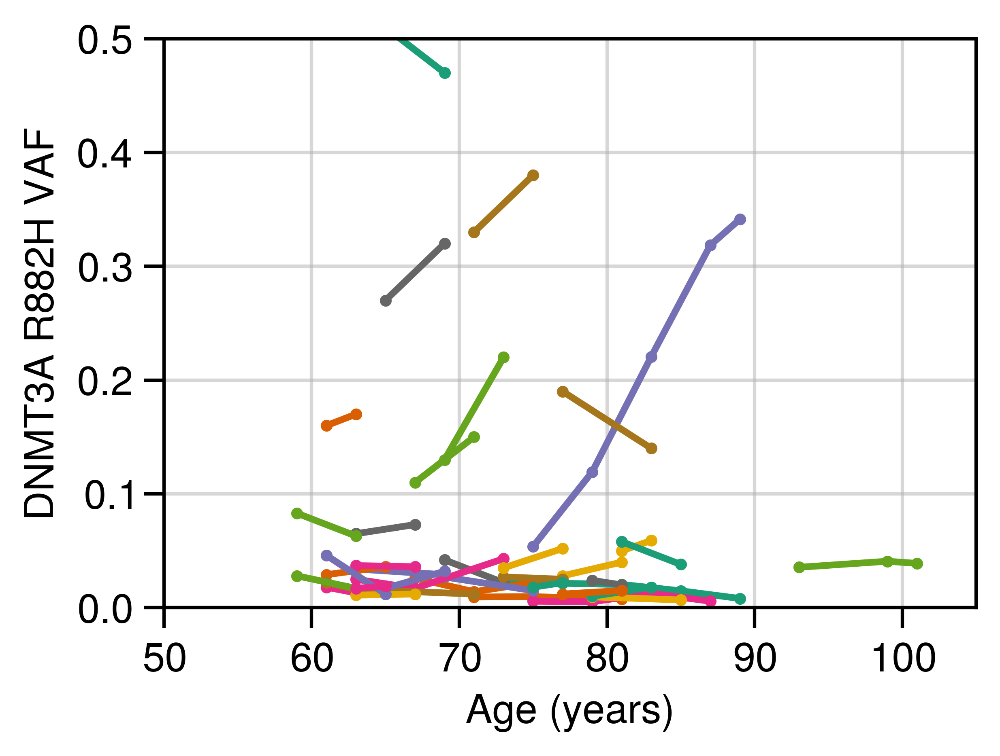

['SardID_11449', 'SardID_260', 901, 2186, 3071, 2319, 1016, 1615, 219, 2563, 2495, 3313, 1610, 3105, 1153, 551]


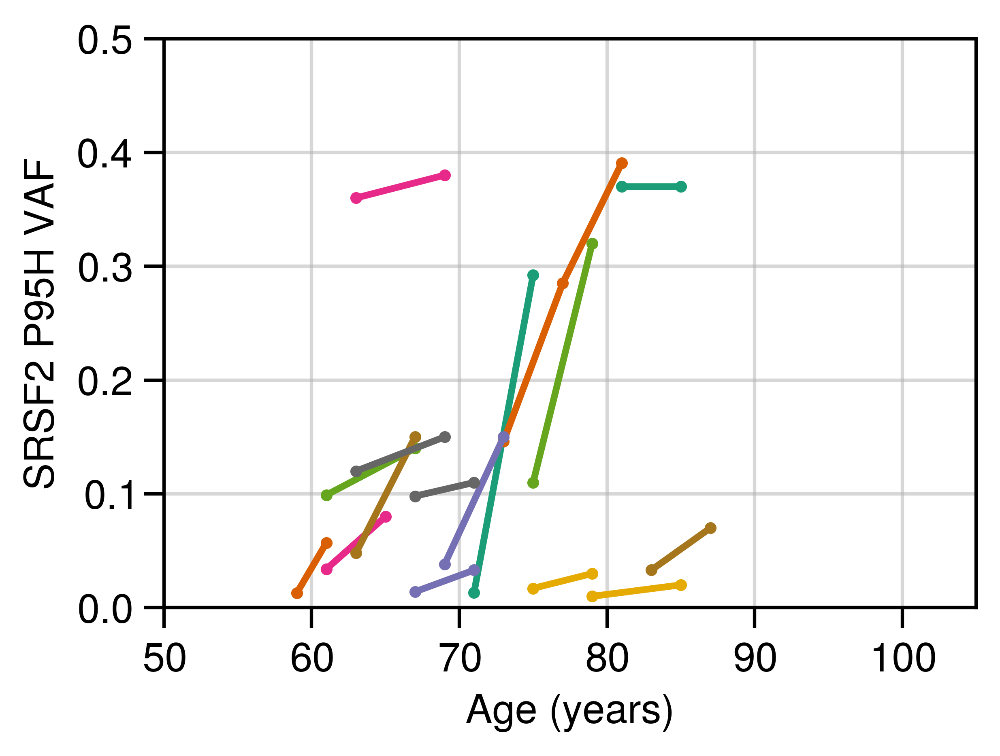

['SardID_2259', 'SardID_3877', 'SardID_4434', 'SardID_4546', 'SardID_32469', 'SardID_4319', 'SardID_35629', 'SardID_12793', 'SardID_13752', 'SardID_12493', 621, 2832, 225, 3147, 2525]


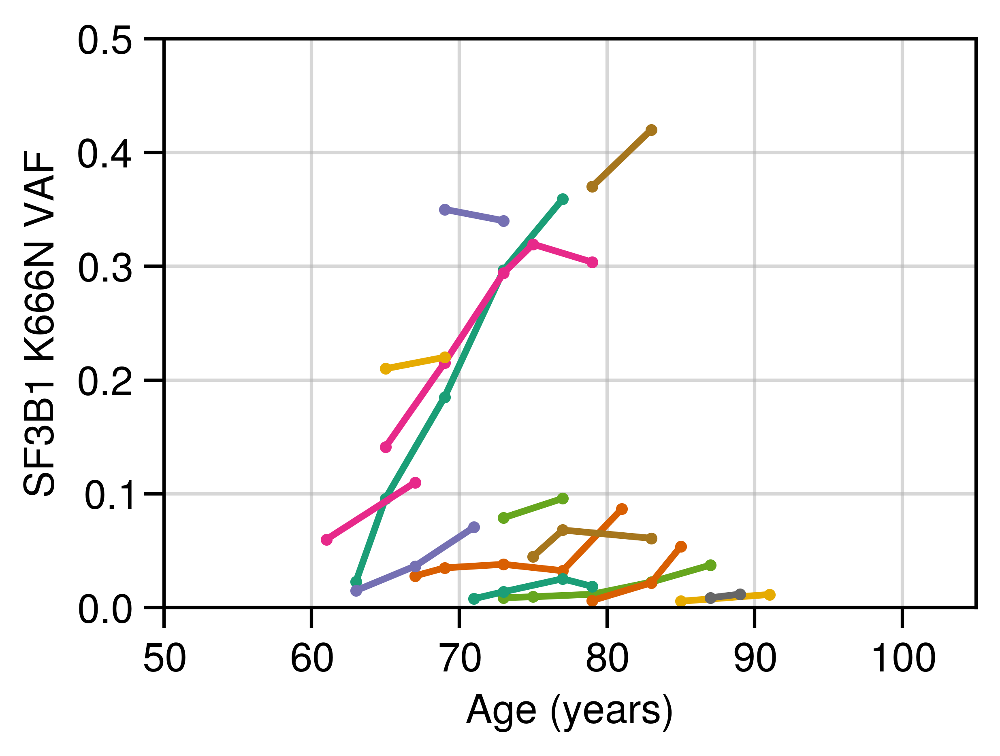

['SardID_38451', 'SardID_26841', 'SardID_2259', 'SardID_1905', 1912, 2020, 1880, 2606, 1497, 2576, 1302, 2698]


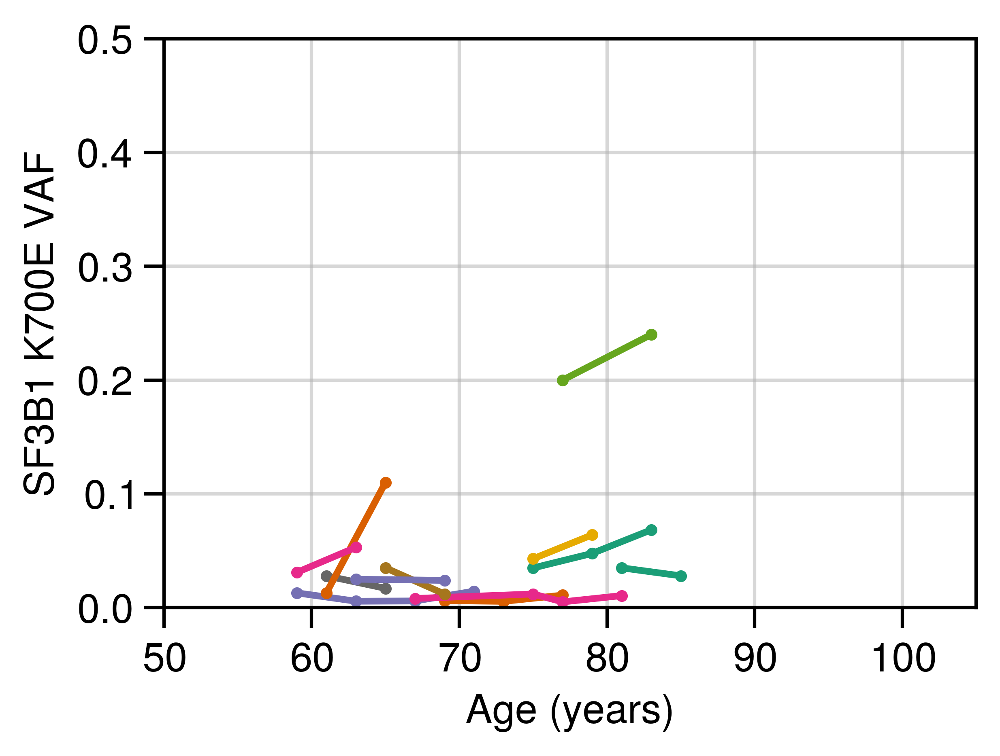

In [24]:
for mut in [
    "JAK2_p.V617F",
    "DNMT3A_p.R882H",
    "SRSF2_p.P95H",
    "SF3B1_p.K666N",
    "SF3B1_p.K700E",
]:
    # select donors with at least one datapoints in
    data_mut = data[(data.AAChange_standard == mut) & (~data.is_sequencing_artefact)]
    donors_at_least_2_data = (
        data_mut["Id"].value_counts()[data_mut["Id"].value_counts() > 1].index.tolist()
    )
    print(donors_at_least_2_data)
    fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="constrained")
    sns.lineplot(
        data=data_mut[data_mut.Id.isin(donors_at_least_2_data)],
        x="Age",
        y="VAF",
        hue="Id",
        marker=".",
        lw=2,
        markersize=7,
        markeredgewidth=0,
        legend=False,
        ax=ax,
        palette="Dark2",
    )
    ax.set_ylabel(f"{mut.replace('_p.', ' ')} VAF")
    ax.set_xlabel("Age (years)")
    ax.set_ylim([0, 0.5])
    ax.set_xlim([50, 105])
    plt.savefig(f"{mut}_vaf.svg")
    plt.show()

1036    DNMT3A_p.R882H
1037    DNMT3A_p.R882H
1038    DNMT3A_p.R882H
1039    DNMT3A_p.R882H
1040    DNMT3A_p.R882H
2770     STAT3_p.G618R
2771     STAT3_p.G618R
2772     STAT3_p.G618R
2773     STAT3_p.G618R
2774     STAT3_p.G618R
Name: AAChange_standard, dtype: object


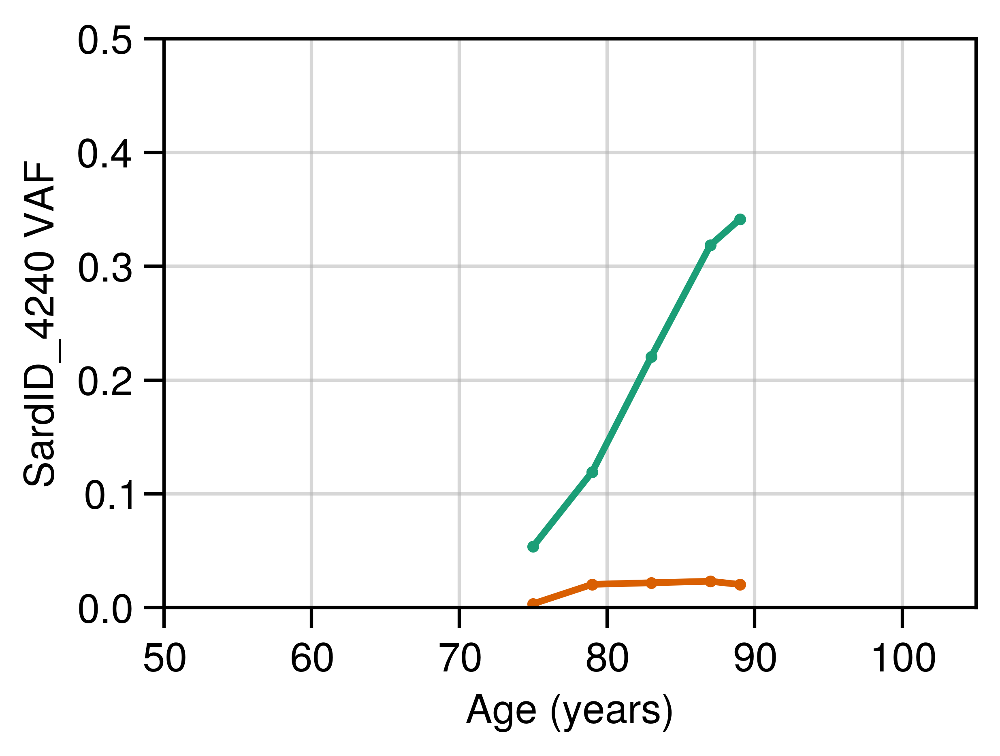

In [25]:
# the clone DNMT3A that escapes… what are the co-existing mutations?
dnmt3a_escaping = data[
    (data.Age > 80)
    & (data.Gene == "DNMT3A")
    & (data.AAChange_standard.str.contains("R882H"))
    & (data.VAF > 0.2)
].Id.unique()
assert dnmt3a_escaping.shape[0] == 1
dnmt3a_escaping = data[data.Id.isin(dnmt3a_escaping)]
print(dnmt3a_escaping.AAChange_standard)
fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="constrained")
sns.lineplot(
    data=dnmt3a_escaping,
    x="Age",
    y="VAF",
    hue="Gene",
    marker=".",
    lw=2,
    markersize=7,
    markeredgewidth=0,
    legend=False,
    ax=ax,
    palette="Dark2",
)
ax.set_ylabel(f"{dnmt3a_escaping.Id.iloc[0]} VAF")
ax.set_xlabel("Age (years)")
ax.set_ylim([0, 0.5])
ax.set_xlim([50, 105])
plt.savefig(f"dnmt3a_escaping_vaf.svg")
plt.show()

22 donors with JAK2 clones with VAF >= 0.2
SardID_3200 JAK2 JAK2_p.V617F #a6cee3
SardID_3200 JAK2 JAK2_p.V617F #a6cee3
SardID_3200 JAK2 JAK2_p.V617F #a6cee3
SardID_3200 JAK2 JAK2_p.V617F #a6cee3
SardID_22109 CREBBP CREBBP_p.Q935P #1f78b4
SardID_22109 JAK2 JAK2_p.V617F #1f78b4
SardID_22109 JAK2 JAK2_p.V617F #1f78b4
SardID_22109 TP53 TP53_p.C85X #1f78b4
CHIP_LBC21_010 JAK2 JAK2_p.V617F #b2df8a
CHIP_LBC21_010 JAK2 JAK2_p.V617F #b2df8a
CHIP_LBC36_007 JAK2 JAK2_p.V617F #fb9a99
CHIP_LBC36_007 JAK2 JAK2_p.V617F #fb9a99
CHIP_LBC36_007 JAK2 JAK2_p.V617F #fb9a99
CHIP_LBC36_007 JAK2 JAK2_p.V617F #fb9a99
CHIP_LBC36_026 JAK2 JAK2_p.V617F #e31a1c
CHIP_LBC36_026 JAK2 JAK2_p.V617F #e31a1c
CHIP_LBC36_026 JAK2 JAK2_p.V617F #e31a1c
CHIP_LBC36_026 JAK2 JAK2_p.V617F #e31a1c
1935 JAK2 JAK2_p.V617F #fdbf6f
1935 JAK2 JAK2_p.V617F #fdbf6f
464 JAK2 JAK2_p.V617F #ff7f00
464 JAK2 JAK2_p.V617F #ff7f00
1491 JAK2 JAK2_p.V617F #cab2d6
1491 JAK2 JAK2_p.V617F #cab2d6
2068 JAK2 JAK2_p.V617F #6a3d9a
2068 JAK2 JAK2_p.V617

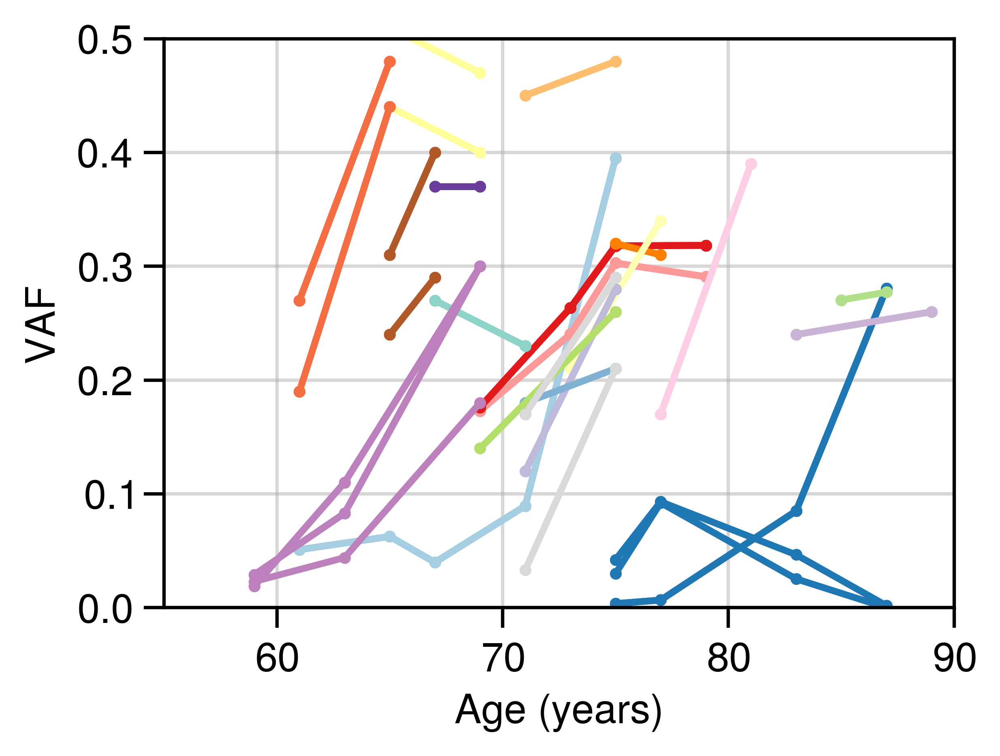

In [26]:
# get all donors with JAK2 V617F VAF > 0.15
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

thr = 0.2

big_jak2_clones = data[
    (data.Gene == "JAK2")
    & (data.AAChange_standard.str.contains("V617F"))
    & (data.VAF >= thr)
].Id.unique()
colors = [
    "#a6cee3",
    "#1f78b4",
    "#b2df8a",
    "#33a02c",
    "#fb9a99",
    "#e31a1c",
    "#fdbf6f",
    "#ff7f00",
    "#cab2d6",
    "#6a3d9a",
    "#ffff99",
    "#b15928",
    "#8dd3c7",
    "#ffffb3",
    "#bebada",
    "#fb8072",
    "#80b1d3",
    "#f46d43",
    "#b3de69",
    "#fccde5",
    "#d9d9d9",
    "#bc80bd",
    "#ccebc5",
    "#ffed6f",
]
print(f"{big_jak2_clones.shape[0]} donors with JAK2 clones with VAF >= {thr}")
assert len(colors) >= big_jak2_clones.shape[0]
legends = []
fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="constrained")
for donor, c in zip(big_jak2_clones, colors):
    for g in data.loc[
        (data.Id == donor) & (data.VAF >= 0.05), ["AAChange_standard", "Gene"]
    ].itertuples():

        toplot = data[
            (data.Id == donor) & (data.AAChange_standard == g.AAChange_standard)
        ]
        if toplot.shape[0] > 1:
            print(donor, g.Gene, g.AAChange_standard, c)
            legends.append((g.Gene, c))
            sns.lineplot(
                data=toplot,
                x="Age",
                y="VAF",
                marker=".",
                lw=2,
                markersize=7,
                markeredgewidth=0,
                legend=True,
                ax=ax,
                estimator=None,
                color=c,
            )
# ax.set_ylabel(f"{dnmt3a_escaping[0]} VAF")
ax.set_xlabel("Age (years)")
ax.set_ylim([0, 0.5])
ax.set_xlim([55, 90])
legend_elements = [
    Line2D(
        [0],
        [0],
        color=c,
        lw=4,
        label=l,
    )
    for l, c in sorted(list(set(legends)), key=lambda x: x[1])
]
# ax.legend(handles=legend_elements, loc='right', fontsize="x-small")
plt.savefig(f"donors_vaf_with_big_jak2_clones.svg")
plt.show()

In [27]:
today = datetime.date.today().strftime("%d_%m_%Y")
# get blood conditions
vanZenter_pheno = pd.read_csv(
    "/mnt/c/Users/fra_t/Documents/PhD/hsc/vanZeventer2023/phenotype_dataset.csv",
    sep=";",
)

pd.merge(
    right=vanZenter_pheno[
        [
            "indiv_ID",
            "anemia",
            "erythrocytosis",
            "thrombocytopenia",
            "thrombocytosis",
            "neutropenia",
            "leukocytosis",
        ]
    ],
    left=data,
    right_on="indiv_ID",
    left_on="Id",
    how="left",
    validate="many_to_one",
).drop(columns="indiv_ID").to_csv(
    f"fabre_robertson_vanzeventer_cleaned_{bins.step}_binwidth_{today}.csv", index=False
)
pd.read_csv(
    f"fabre_robertson_vanzeventer_cleaned_{bins.step}_binwidth_{today}.csv"
).columns

Index(['Id', 'Age_unbinned', 'Gene', 'VAF', 'AAChange',
       'is_sequencing_artefact', 'synonymous', 'cohort', 'Age',
       'AAChange_standard', 'anemia', 'erythrocytosis', 'thrombocytopenia',
       'thrombocytosis', 'neutropenia', 'leukocytosis'],
      dtype='object')

## Analysis

### Descriptive

In [28]:
# how many donors?
print(f"{data.Id.unique().shape[0]} donors")
# how many donors at different age bins?
print(data[["Age", "Id"]].drop_duplicates().Age.value_counts().sort_index())
# how many genes?
print(f"{data["Gene"].unique().shape} unique genes")
print(f"{data["AAChange_standard"].unique().shape} unique mutations")
print(f"Age range: [{data['Age_unbinned'].min()}-{data['Age_unbinned'].max()}]")
print(f"Age binned: [{data['Age'].unique()}]")

1923 donors
Age
55       7
57      14
59      85
61     187
63     275
65     373
67     396
69     402
71     389
73     408
75     351
77     315
79     286
81     232
83     186
85     202
87     113
89      49
91      49
93      16
95       3
97       1
99       2
101      2
103      1
Name: count, dtype: int64
(78,) unique genes
(3572,) unique mutations
Age range: [54.57-103.1]
Age binned: [[ 61  65  67  71  75  69  93  95 101  55  59  63  79  81  77  85  73  83
  87  89 103  91  57  99  97]]


               Id  AAChange
1846  SardID_4547        12
               Id  Age   Gene
171   SardID_4547   71   BCOR
1732  SardID_4547   71   JAK2
2330  SardID_4547   71  RAD21
2633  SardID_4547   71   SMC3
3197  SardID_4547   71   TET2
3198  SardID_4547   71   TET2
3199  SardID_4547   71   TET2
3200  SardID_4547   71   TET2
3201  SardID_4547   71   TET2
3202  SardID_4547   71   TET2
3203  SardID_4547   71   TET2
3204  SardID_4547   71   TET2


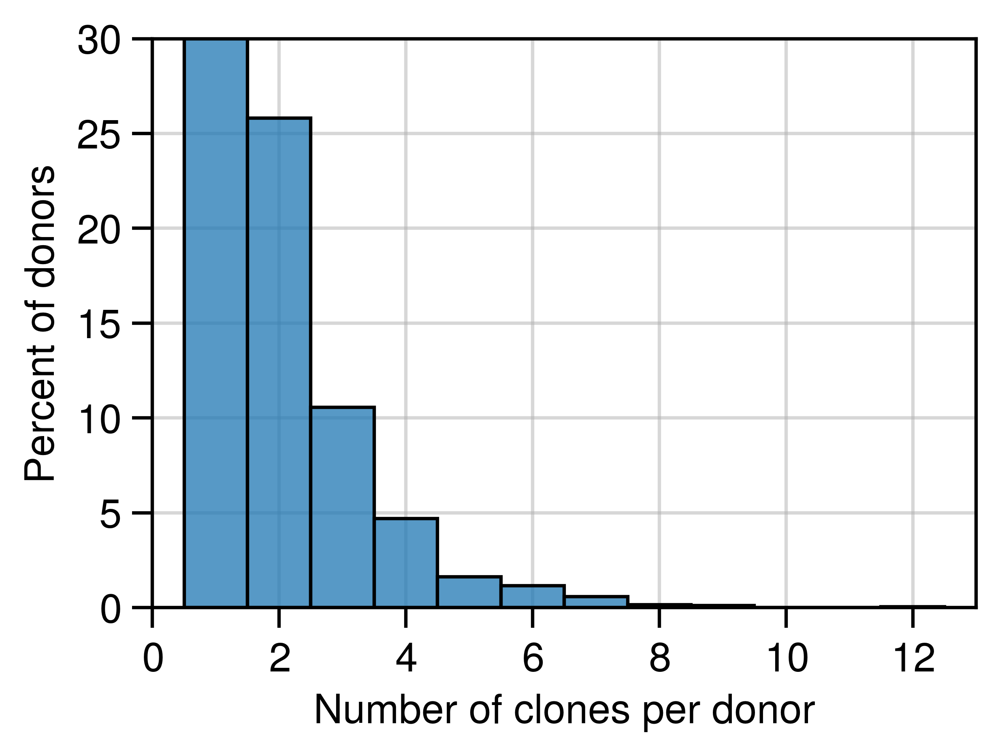

            Id
AAChange      
1         1046
2          489
3          200
4           89
5           31
6           22
7           11
8            3
9            2
12           1
                Id
AAChange          
1         0.552270
2         0.258184
3         0.105597
4         0.046990
5         0.016367
6         0.011616
7         0.005808
8         0.001584
9         0.001056
12        0.000528


In [29]:
# how many mutations per donors?
mutations_per_donor = (
    data.loc[~data.is_sequencing_artefact, ["Id", "AAChange"]]
    .drop_duplicates()
    .groupby("Id")
    .count()
    .reset_index()
)
donor_with_max_mut = mutations_per_donor[
    mutations_per_donor.AAChange == mutations_per_donor.AAChange.max()
]
print(donor_with_max_mut)
print(
    data[data.Id == donor_with_max_mut.Id.squeeze()].drop_duplicates(
        subset=["Id", "AAChange"]
    )[["Id", "Age", "Gene"]]
)
fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="constrained")
sns.histplot(
    data=mutations_per_donor,
    x="AAChange",
    stat="percent",
    discrete=True,
)
# ax.set_yscale("log")
ax.set_xlim([0, 13])
ax.set_ylim([0, 30])
ax.set_xticks(range(0, 14, 2))
ax.set_xlabel("Number of clones per donor")
ax.set_ylabel("Percent of donors")
plt.savefig(f"nb_mutations_per_donor.svg")
plt.show()
# percentages and counts
print(mutations_per_donor.groupby("AAChange").count())
print(mutations_per_donor.groupby("AAChange").count() / mutations_per_donor.shape[0])

['IDH1_p.R132H' 'SRSF2_p.95_103del' 'TET2_p.Q1825X' 'TET2_p.I1873T'
 'JAK2_p.V617F']
18798    JAK2_p.V617F
Name: AAChange_standard, dtype: object


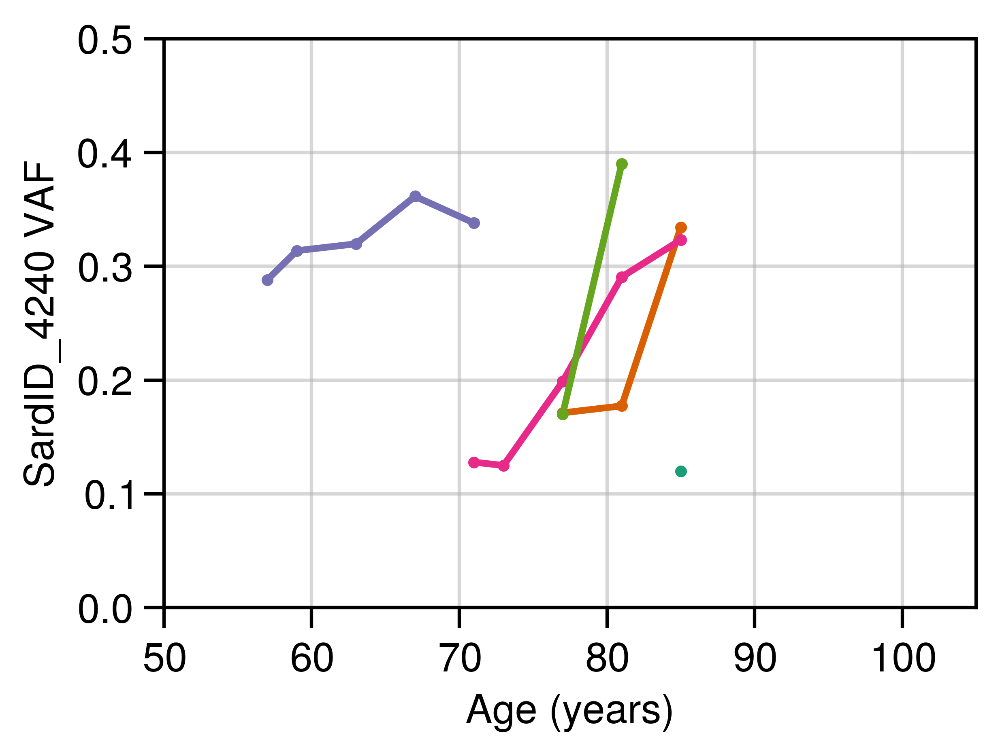

In [30]:
donors_with_max_mut = mutations_per_donor[mutations_per_donor.AAChange > 7]
donor_with_max_mut_df = data[(data.Id.isin(donors_with_max_mut.Id)) & (data.VAF >= 0.1)]
print(donor_with_max_mut_df.AAChange_standard.unique())
print(
    donor_with_max_mut_df.loc[
        donor_with_max_mut_df.VAF == donor_with_max_mut_df.VAF.max(),
        "AAChange_standard",
    ]
)
fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="constrained")
sns.lineplot(
    data=donor_with_max_mut_df,
    x="Age",
    y="VAF",
    hue="AAChange_standard",
    marker=".",
    lw=2,
    markersize=7,
    markeredgewidth=0,
    legend=False,
    ax=ax,
    palette="Dark2",
)
ax.set_ylabel(f"{dnmt3a_escaping.Id.iloc[0]} VAF")
ax.set_xlabel("Age (years)")
ax.set_ylim([0, 0.5])
ax.set_xlim([50, 105])
plt.savefig(f"dnmt3a_escaping_vaf.svg")
plt.show()

In [31]:
donor_with_max_mut_df.drop_duplicates(subset=["AAChange_standard"])

,Id,Age_unbinned,Gene,VAF,AAChange,is_sequencing_artefact,synonymous,cohort,Age,AAChange_standard
1694,SardID_2444,84.43,IDH1,0.1198,"IDH1:NM_001282386:exon4:c.G395A:p.R132H,IDH1:N...",False,False,Sard,85,IDH1_p.R132H
2681,SardID_2444,77.65,SRSF2,0.1712,SRSF2:NM_001195427:exon1:c.284_307del:p.95_103...,False,False,Sard,77,SRSF2_p.95_103del
3162,SardID_4319,56.51,TET2,0.2881,TET2:NM_001127208:exon11:c.C5473T:p.Q1825X,False,False,Sard,57,TET2_p.Q1825X
3197,SardID_4547,70.69,TET2,0.1278,TET2:NM_001127208:exon11:c.T5618C:p.I1873T,False,False,Sard,71,TET2_p.I1873T
17001,648,78.00,JAK2,0.1700,Val617Phe,False,False,lifeline,77,JAK2_p.V617F


In [32]:
chip_donors = (
    data.loc[data.VAF >= CHIP_THR_VAF, ["Id", "Age"]]
    .sort_values(by=["Id", "Age"])
    .drop_duplicates(subset="Id", keep="first")
)
chip_donors.Age.value_counts().cumsum() / data.Id.unique().shape[0]

Age
69    0.068643
67    0.133645
65    0.189288
63    0.243890
61    0.297452
71    0.349454
73    0.400936
75    0.439938
79    0.475299
81    0.506500
77    0.536661
85    0.561102
83    0.582943
59    0.603744
87    0.613105
89    0.616745
91    0.618825
93    0.620385
57    0.621425
95    0.621945
Name: count, dtype: float64

/tmp/ipykernel_19901/2834573963.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(temp.reset_index(), x="Id", y="Gene", palette="Dark2", ax=ax)


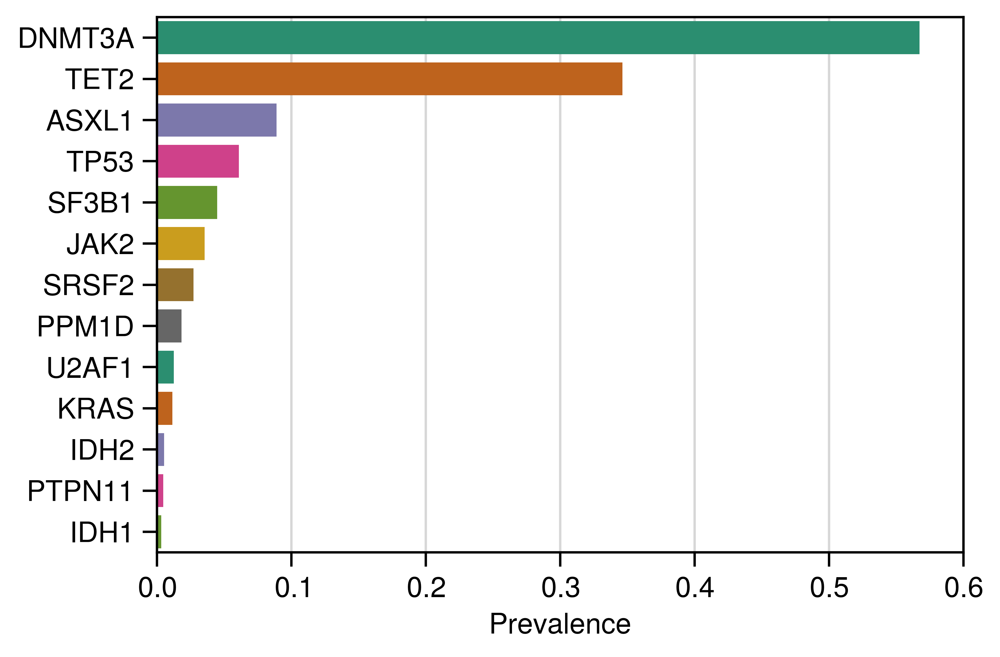

/tmp/ipykernel_19901/2834573963.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(temp.reset_index(), x="Id", y="Gene", palette="Dark2", ax=ax)


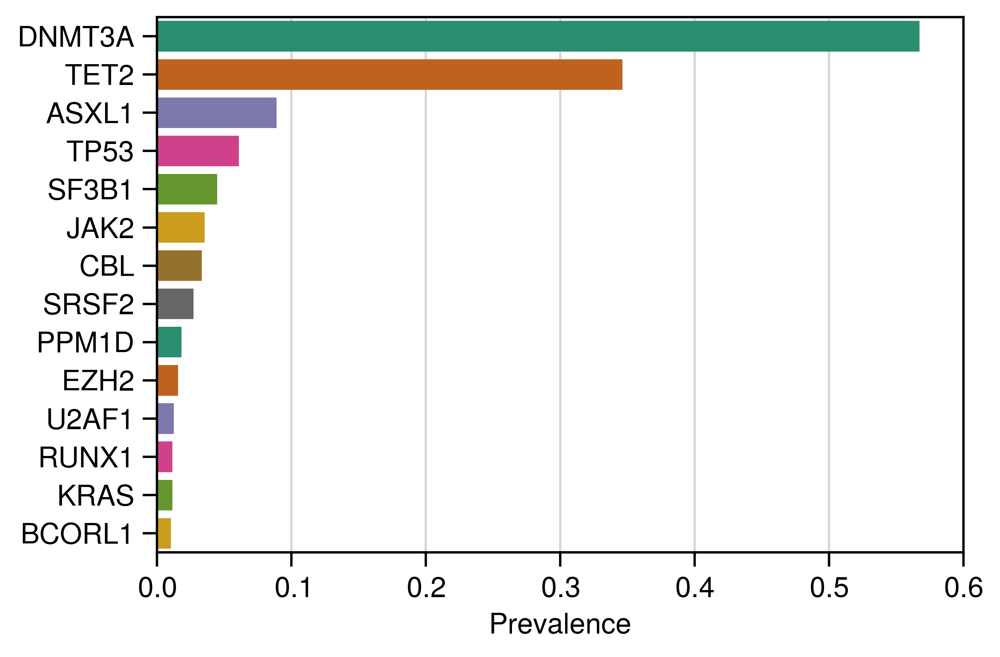

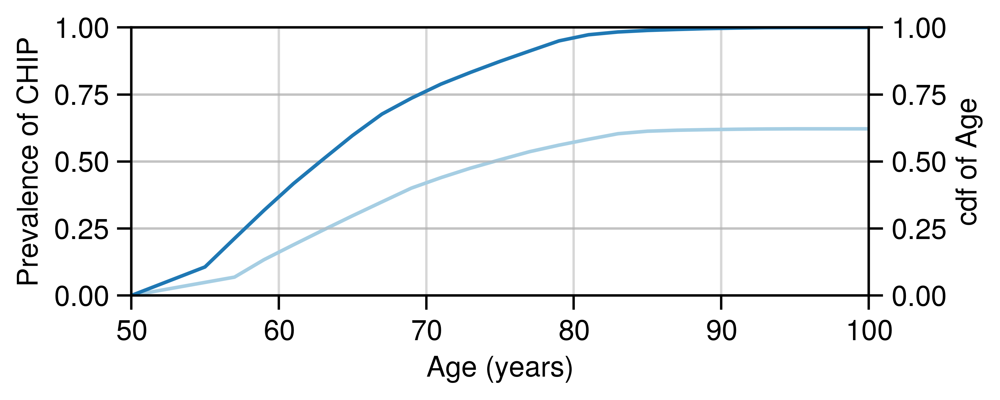

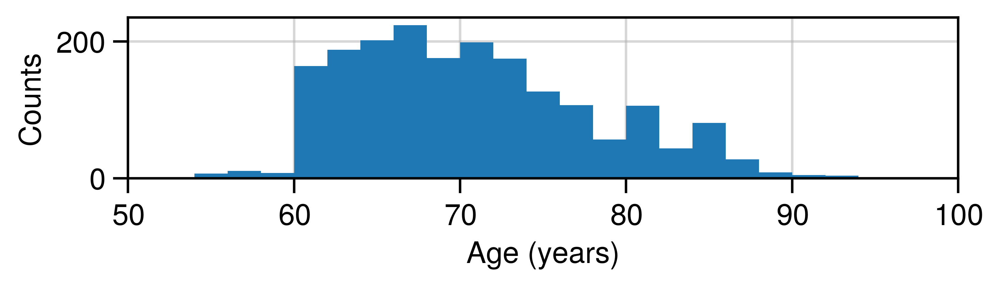

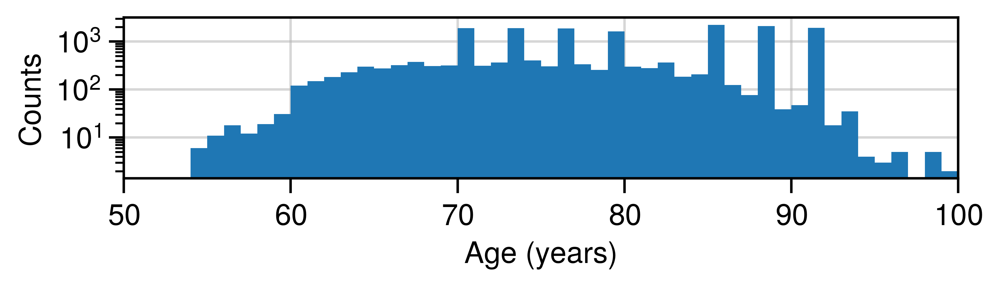

In [33]:
temp = (
    data.loc[(~data.is_sequencing_artefact) & (data.Gene.isin(genes)), ["Id", "Gene"]]
    .drop_duplicates(subset=["Id", "Gene"])
    .groupby("Gene")
    .count()
    .sort_values(by="Id", ascending=False)
)
temp /= data.Id.unique().shape[0]
fig, ax = plt.subplots(1, 1, figsize=(6, 4), layout="tight")
sns.barplot(temp.reset_index(), x="Id", y="Gene", palette="Dark2", ax=ax)
ax.set_xlabel("Prevalence")
ax.set_ylabel("")
ax.tick_params(which="major", axis="y")
ax.set_xlim([0, 0.6])
plt.savefig("prev_genes.svg")
plt.show()

temp = (
    data.loc[~data.is_sequencing_artefact, ["Id", "Gene"]]
    .drop_duplicates(subset=["Id", "Gene"])
    .groupby("Gene")
    .count()
    .sort_values(by="Id", ascending=False)
    .head(len(genes) + 1)
)
temp /= data.Id.unique().shape[0]
fig, ax = plt.subplots(1, 1, figsize=(6, 4), layout="tight")
sns.barplot(temp.reset_index(), x="Id", y="Gene", palette="Dark2", ax=ax)
ax.set_xlabel("Prevalence")
ax.set_ylabel("")
ax.tick_params(which="major", axis="y")
ax.set_xlim([0, 0.6])
plt.savefig("prev_genes_most_mutated.svg")
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(6, 2.5), layout="tight")
xlim = [50, 100]
chip_donors = (
    data.loc[data.VAF >= CHIP_THR_VAF, ["Id", "Age"]]
    .sort_values(by=["Id", "Age"])
    .drop_duplicates(subset="Id", keep="first")
).sort_values(by="Age")
chip_proportion = (
    chip_donors.Age.value_counts().cumsum() / data.Id.unique().shape[0]
).tolist()
# ugly thing to make the line go up to the xlim
ax.plot(
    [xlim[0]] + chip_donors.Age.unique().tolist() + [xlim[-1]],
    [0] + chip_proportion + [chip_proportion[-1]],
    c="#a6cee3",
)
ax.set_xlim(xlim)
ax.set_ylim([0, 1])
ax.set_ylabel("Prevalence of CHIP")
ax.set_xlabel("Age (years)")

ax2 = ax.twinx()
age_at_detection = (
    data[["Id", "Age"]]
    .sort_values(by=["Id", "Age"])
    .drop_duplicates(subset="Id", keep="first")
).sort_values(by="Age")
assert (
    age_at_detection.shape[0] == data.Id.unique().shape[0]
), f"{age_at_detection.shape[0]} vs {data.Id.unique().shape[0]}"
ax2.set_ylabel("cdf of Age")
ax2.set_ylim([0, 1])
ax2.plot(
    [xlim[0]] + age_at_detection.Age.sort_values().unique().tolist() + [xlim[-1]],
    [0]
    + (
        age_at_detection.Age.value_counts().cumsum() / data.Id.unique().shape[0]
    ).tolist()
    + [1],
    c="#1f78b4",
)
plt.savefig("prev_CHIP.svg")
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(5.5, 1.5), layout="constrained")
ax.hist(data.drop_duplicates("Id").Age_unbinned, bins=bins)
ax.set_ylabel("Counts")
ax.set_xlabel("Age (years)")
ax.set_xlim([50, 100])
plt.savefig("age_hist.svg")
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(5.5, 1.5), layout="constrained")
ax.hist(data.Age_unbinned, bins=range(50, 105, 1))
ax.set_ylabel("Counts")
ax.set_xlabel("Age (years)")
ax.set_xlim([50, 100])
ax.set_yscale("log")
plt.savefig("age_muts_hist.svg")
plt.show()

In [34]:
donors_no_chip = (
    (data[["Id", "VAF"]].groupby("Id").max() < CHIP_THR_VAF).sum().squeeze()
)
tot_donors = data.Id.unique().shape[0]
ratio = donors_no_chip / tot_donors
print(f"{donors_no_chip} donors over {tot_donors} tot ({ratio:.2%}) have no CHIP")

727 donors over 1923 tot (37.81%) have no CHIP


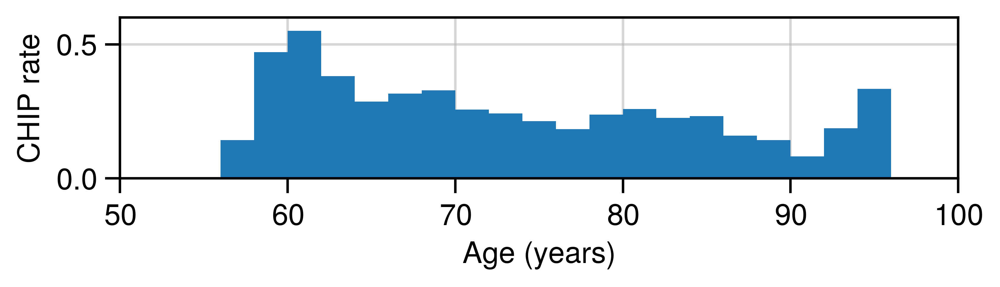

In [35]:
# the number of donors with and without CHIP

chip_rate = (
    chip_donors.Age.value_counts()
    / data[["Id", "Age"]]
    .sort_values(["Id", "Age"])
    .drop_duplicates(keep="first")
    .Age.value_counts()
).fillna(0)
fig, ax = plt.subplots(1, 1, figsize=(5.5, 1.5), layout="constrained")
ax.bar(chip_rate.index, chip_rate, width=bins.step)
ax.set_ylabel("CHIP rate")
ax.set_xlabel("Age (years)")
ax.set_xlim([50, 100])
ax.set_ylim([0, 0.6])
plt.savefig("prop_CHIP.svg")
plt.show()

In [36]:
# even though DNMT3A is the most mutated gene, it has many low presence variants
# whereas JAK2 has a prevalence below 10% at the gene level, but has
# only 1 mutation JAK2_p.V617F
print(
    data.loc[
        (data.Gene == "JAK2") & (~data.is_sequencing_artefact), "AAChange_standard"
    ].unique()
)
data.loc[
    (~data.is_sequencing_artefact) & (data.Gene.isin(genes)),
    ["Id", "AAChange_standard"],
].drop_duplicates(subset=["Id", "AAChange_standard"]).groupby(
    "AAChange_standard"
).count().sort_values(
    by="Id", ascending=False
).head(
    20
)

['JAK2_p.V617F' 'JAK2_p.K539L']


,Id
AAChange_standard,
JAK2_p.V617F,67
DNMT3A_p.R882H,49
ASXL1_p.G646fs,33
SRSF2_p.P95H,26
SF3B1_p.K700E,26
DNMT3A_p.R882C,21
TET2_p.I1873T,20
SF3B1_p.K666N,20
DNMT3A_p.Y735C,20


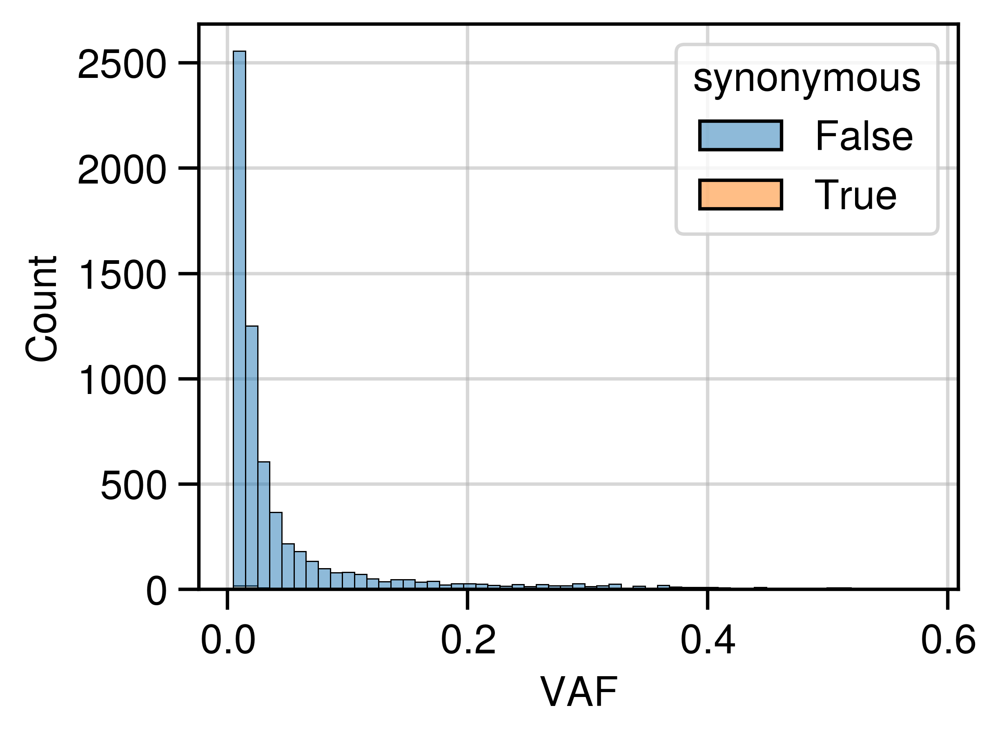

VAF                                                         \
           count      mean       std    min       25%      50%      75%   
cohort                                                                    
LBC21       64.0  0.068456  0.073881  0.020  0.024275  0.03885  0.09325   
LBC36      128.0  0.141391  0.117434  0.020  0.035075  0.10530  0.25130   
Sard      2283.0  0.032709  0.059920  0.005  0.007300  0.01180  0.02620   
lifeline  3985.0  0.060550  0.092330  0.010  0.014000  0.02300  0.05600   

                  
             max  
cohort            
LBC21     0.4481  
LBC36     0.4671  
Sard      0.4387  
lifeline  0.5800

In [37]:
fig, ax = plt.subplots(1, 1, figsize=(4, 3))
sns.histplot(
    data[~data.is_sequencing_artefact], x="VAF", hue="synonymous", ax=ax, binwidth=0.01
)
plt.show()

# LBC21 are older donors
data.loc[~data.is_sequencing_artefact, ["VAF", "cohort"]].groupby(
    "cohort", observed=False
).describe()

In [38]:
# the most present genes at patient level?
data.loc[~data.is_sequencing_artefact, ["Id", "Gene", "VAF"]].groupby(
    ["Id", "Gene"]
).count().sort_values(by="VAF", ascending=False).reset_index().Gene.value_counts()

Gene
DNMT3A     1091
TET2        666
ASXL1       171
TP53        117
SF3B1        86
JAK2         68
CBL          64
SRSF2        52
PPM1D        35
EZH2         30
U2AF1        24
KRAS         22
RUNX1        22
BCORL1       20
NOTCH1       19
CUX1         18
GNAS         17
CTCF         14
STAT3        14
CREBBP       14
BRCC3        14
MYD88        14
KDM6A        13
NRAS         12
BCOR         11
IDH2         10
KMT2A        10
GNB1          9
PTPN11        9
KIT           8
SMC3          8
ETNK1         8
SMC1A         8
RAD21         7
U2AF2         7
PRPF40B       7
CALR          7
IDH1          6
WT1           6
STAG2         6
ETV6          6
ZRSR2         6
PHF6          6
CSF3R         5
CEBPA         5
BRAF          5
JAK3          4
PTEN          4
SETBP1        4
SF1           4
MPL           3
CDKN2A        3
NF1           3
GATA2         3
FLT3          3
SF3A1         3
PIGA          2
MYC           1
LUC7L2        1
CBLC          1
Name: count, dtype: int64

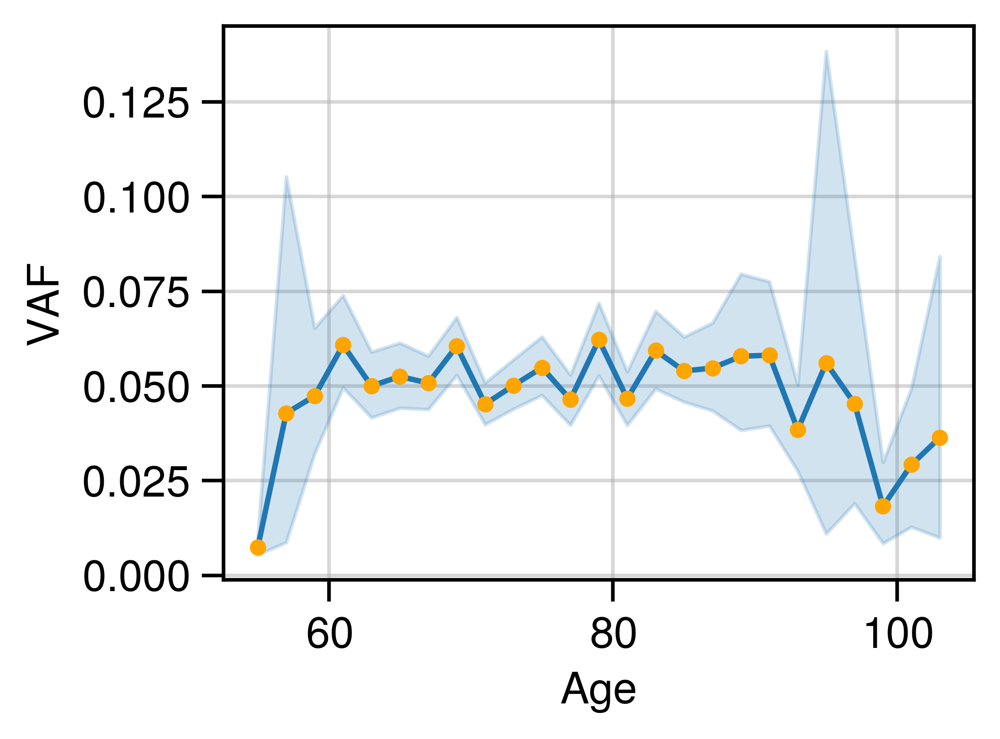

VAF                                                                 
     count      mean       std     min       25%      50%       75%     max
Age                                                                        
55     6.0  0.007408  0.003352  0.0053  0.005400  0.00565  0.008038  0.0137
57     9.0  0.042833  0.092270  0.0055  0.007000  0.01130  0.017500  0.2881
59    99.0  0.046971  0.083803  0.0053  0.012000  0.01900  0.032000  0.5300
61   234.0  0.060408  0.096621  0.0050  0.013000  0.02300  0.056250  0.5200
63   372.0  0.049569  0.085017  0.0051  0.013000  0.01930  0.044000  0.5800
65   474.0  0.052297  0.089620  0.0051  0.013000  0.01900  0.045600  0.5500
67   566.0  0.050656  0.082198  0.0050  0.012000  0.01900  0.042000  0.5600
69   540.0  0.060212  0.090052  0.0050  0.013000  0.02200  0.062000  0.5800
71   588.0  0.045032  0.070420  0.0050  0.011475  0.01800  0.041250  0.4900
73   578.0  0.049787  0.078950  0.0051  0.011500  0.02000  0.043000  0.5300
75   519.0  0.054704  0.087933  0.0050  0.011000  0.01900  0.046000  0.5500
77   520.0  0.046096  0.077204  0.0050  0.010700  0.01600  0.038250  0.5200
79   438.0  0.061831  0.099538  0.0050  0.011075  0.01975  0.046425  0.5100
81   412.0  0.046551  0.076360  0.0050  0.010975  0.01800  0.040200  0.5000
83   351.0  0.059135  0.097566  0.0050  0.011000  0.01900  0.047500  0.5300
85   352.0  0.054015  0.083185  0.0050  0.011875  0.02100  0.053200  0.5200
87   178.0  0.054286  0.078951  0.0050  0.011200  0.02310  0.061750  0.4400
89    88.0  0.057848  0.098369  0.0050  0.010650  0.01700  0.037025  0.4800
91    67.0  0.056500  0.079407  0.0051  0.011600  0.02250  0.066250  0.3926
93    42.0  0.038433  0.039848  0.0054  0.013400  0.02240  0.047725  0.1700
95     7.0  0.056086  0.106454  0.0063  0.011000  0.01100  0.028350  0.2966
97     3.0  0.045333  0.034210  0.0190  0.026000  0.03300  0.058500  0.0840
99     5.0  0.018260  0.014176  0.0050  0.009400  0.01350  0.022600  0.0408
101    6.0  0.029250  0.025602  0.0064  0.010600  0.02340  0.036725  0.0748
103    6.0  0.036417  0.057127  0.0055  0.009225  0.01635  0.019875  0.1524

In [39]:
# increasing VAF at first, then decreasing
fig, ax = plt.subplots(1, 1, layout="tight", figsize=(4, 3))
sns.lineplot(
    data.loc[(~data.is_sequencing_artefact) & (~data.synonymous), ["VAF", "Age"]],
    x="Age",
    y="VAF",
    marker=".",
    markersize=5,
    markeredgewidth=2,
    markeredgecolor="orange",
    markerfacecolor="orange",
)
plt.show()
data.loc[~data.is_sequencing_artefact, ["VAF", "Age"]].groupby("Age").describe()

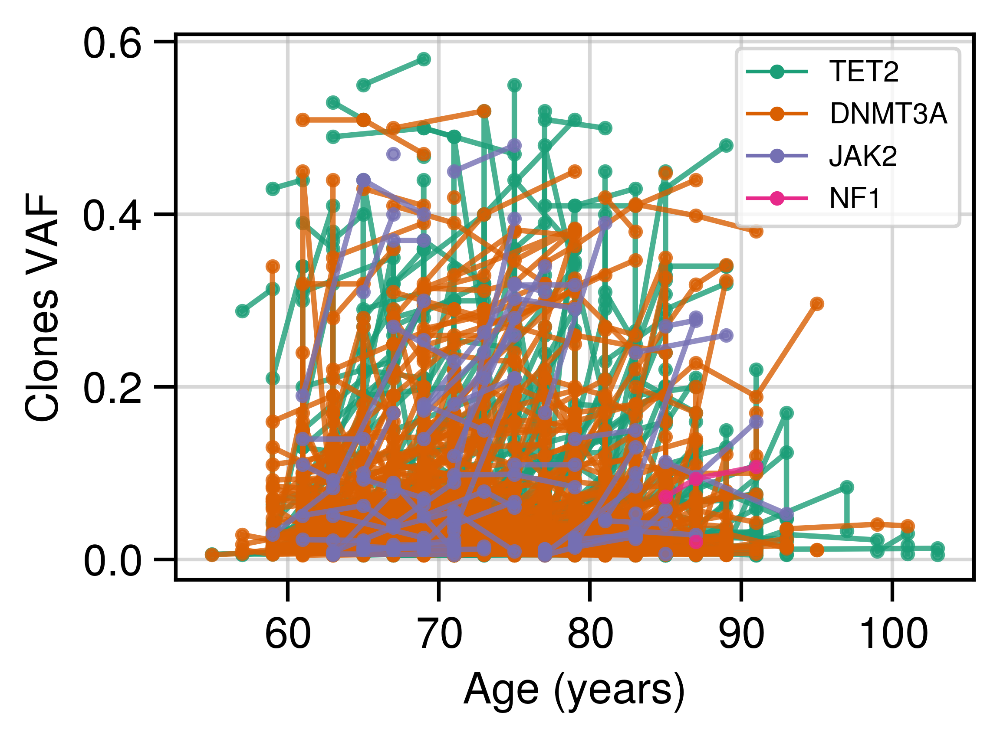

In [40]:
genes = ["TET2", "DNMT3A", "JAK2", "NF1"]
colors = mpl.colormaps["Dark2"].colors[: len(genes)]
fig, ax = plt.subplots(1, 1, figsize=(4, 3), layout="tight")
ax = plot_trajectories_gene(
    ax, data[(~data.is_sequencing_artefact) & (~data.synonymous)], genes, colors
)
ax.set_ylabel("Clones VAF")
plt.savefig("genes_trajectories_fabre_robertson_merged.png", dpi=600)
plt.show()

### Largest clones

In [41]:
# we now find the max VAF per donor irrespective of binned age
largest_clones = data[["Id", "VAF"]].groupby("Id").max().reset_index()
largest_clones["is_largest_clone"] = True
data = pd.merge(
    left=largest_clones,
    right=data,
    on=["Id", "VAF"],
    how="right",
    validate="one_to_many",
)
data.is_largest_clone = data.is_largest_clone.fillna(0).astype(bool)
# there are some clones with exactly the same VAF
data.is_largest_clone = ~data[data.is_largest_clone].duplicated(subset=["Id", "VAF"])
data.is_largest_clone = data.is_largest_clone.fillna(0).astype(bool)
assert data.is_largest_clone.sum() == data.Id.unique().shape[0]
data

,Id,VAF,is_largest_clone,Age_unbinned,Gene,AAChange,is_sequencing_artefact,synonymous,cohort,Age,AAChange_standard
0,SardID_260,0.0013,False,61.02,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,61,ASXL1_p.E906X
1,SardID_260,0.0006,False,64.02,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,65,ASXL1_p.E906X
2,SardID_260,0.0000,False,67.75,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,67,ASXL1_p.E906X
3,SardID_260,0.0007,False,71.09,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,True,False,Sard,71,ASXL1_p.E906X
4,SardID_260,0.0143,False,75.36,ASXL1,ASXL1:NM_015338:exon12:c.G2716T:p.E906X,False,False,Sard,75,ASXL1_p.E906X
...,...,...,...,...,...,...,...,...,...,...,...
19884,348,0.0120,True,75.75,TP53,Ser241Ala,False,False,lifeline,75,TP53_p.S241A
19885,3329,0.0110,False,77.75,TP53,Ile254Asn,False,False,lifeline,77,TP53_p.I254N
19886,3273,0.0130,False,75.17,TP53,Gly266Val,False,False,lifeline,75,TP53_p.G266V
19887,299,0.0110,True,73.92,U2AF1,Arg156His,False,False,lifeline,73,U2AF1_p.R156H


In [42]:
# for each donor, get the largest frequency by binned age.
# Then, aggregate per age to compute some stats on those data
# largest clone per patient
largest_clones = (
    data.loc[
        ~data.is_sequencing_artefact,
        ["Id", "VAF", "Age"],
    ]
    .groupby(["Id", "Age"])
    .max()
).reset_index()
# largest_clones["Largest clone frequency"] = 2 * largest_clones.AF
largest_clones["is_largest_clone_per_bin"] = True
# largest_clones.drop(columns="AF", inplace=True)
shape_bf_merge = data.shape
print(shape_bf_merge)
data = pd.merge(
    left=data,
    right=largest_clones,
    how="left",
    on=["Id", "Age", "VAF"],
    validate="many_to_one",
)
print(data.shape)
assert data.shape[0] == shape_bf_merge[0]
data["is_largest_clone_per_bin"] = data.is_largest_clone_per_bin.fillna(0).astype(bool)

(19889, 11)
(19889, 12)


In [43]:
def compute_spearmanr_vs_age(df, col1):
    return stats.spearmanr(
        df[[col1, "Age"]].groupby("Age").mean().reset_index(), axis=0
    )

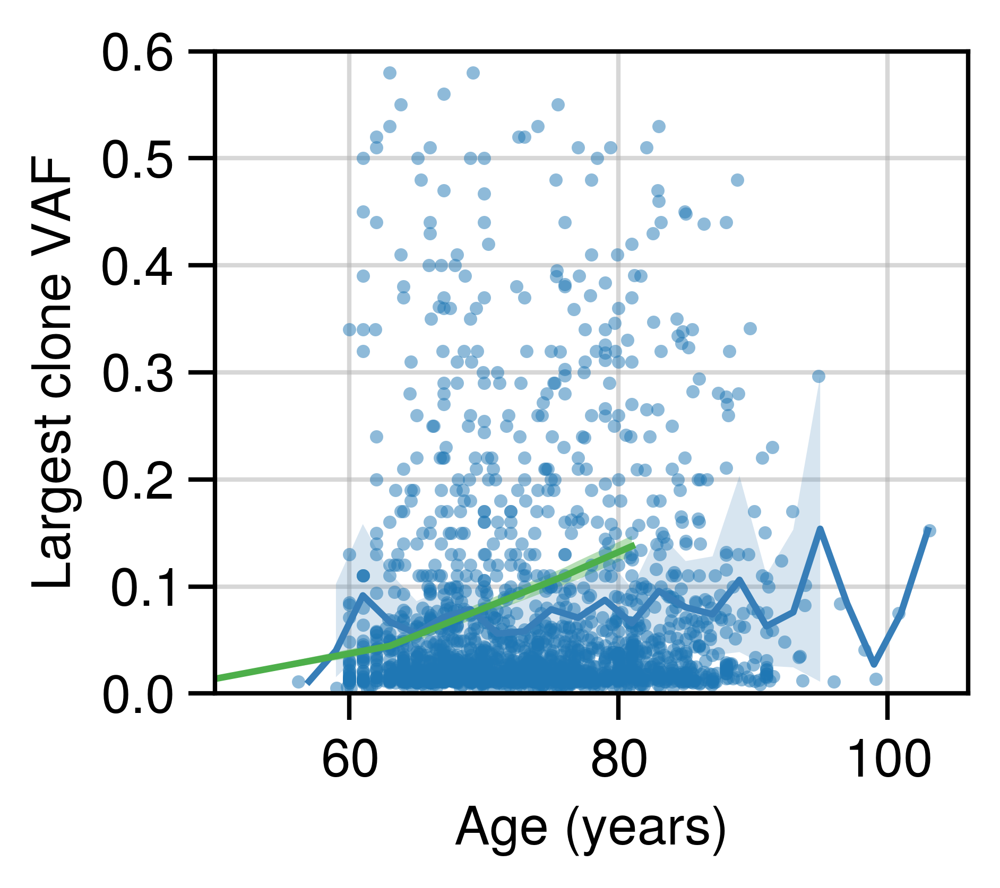

In [44]:
# VAF in fn of age
fig, ax = plt.subplots(1, 1, figsize=(3.3, 2.95), layout="tight")
data.loc[data.is_largest_clone, ["Id", "Age_unbinned", "VAF"]].plot(
    x="Age_unbinned",
    y="VAF",
    ls="",
    marker=".",
    ax=ax,
    alpha=0.5,
    markeredgewidth=0,
    legend=False,
)
sns.lineplot(
    data.loc[data.is_largest_clone, ["Id", "Age", "VAF"]],
    x="Age",
    y="VAF",
    color="#377eb8",
    legend=False,
    marker=None,
    ax=ax,
    estimator="mean",
    errorbar=("ci", 99.99),
    n_boot=10_000,
    err_kws={"edgecolor": None},
)

ax.set_xlabel("Age (years)")
ax.set_ylabel("Largest clone VAF")
ax.set_ylim([0, 0.6])
ax.set_xlim([50, 106])
# compute the correlation between age and average VAF
res = compute_spearmanr_vs_age(data, "VAF")
"""
ax.text(
    x=0.78, y=0.8, s=f"R={res.statistic:.2f}\np={res.pvalue:.2f}", transform=ax.transAxes
)
"""
# from the sims and mitchell
cf = pd.read_csv("./cf_posterior.csv")
vaf_mitchell = cf["mean_sim_max_cf"] / 2
vaf_sim_min = cf["mean_sim_max_cf_ci_low"] / 2
vaf_sim_max = cf["mean_sim_max_cf_ci_high"] / 2
ages_mitchell = cf["Age"]
ax.fill_between(
    ages_mitchell, vaf_sim_min, vaf_sim_max, alpha=0.4, color="#4daf4a", edgecolor=None
)
ax.plot(ages_mitchell, vaf_mitchell, c="#4daf4a")
plt.savefig("largest_clone_avg_fabre_robertson_merged.png", dpi=600)
plt.show()

In [45]:
data.loc[
    (data.is_largest_clone) & (data.VAF > 0.45), ["Id", "Age_unbinned"]
].sort_values(by="Age_unbinned")

,Id,Age_unbinned
17027,3041,61.00
16425,2712,62.00
17028,2361,62.00
16959,1813,63.00
17200,2551,63.00
19248,233,63.83
18070,1275,65.08
19245,587,65.33
16907,2486,66.00
18782,2069,67.00


In [46]:
data.loc[data.VAF > 0.45].Gene.unique()

array(['TET2', 'ASXL1', 'CALR', 'DNMT3A', 'EZH2', 'NRAS', 'RUNX1', 'TP53',
       'WT1', 'JAK2', 'U2AF1'], dtype=object)

In [47]:
data.loc[data.is_largest_clone, ["Id", "Age"]].groupby("Age").count()

,Id
Age,
57,1
59,28
61,71
63,106
65,167
67,205
69,175
71,153
73,163


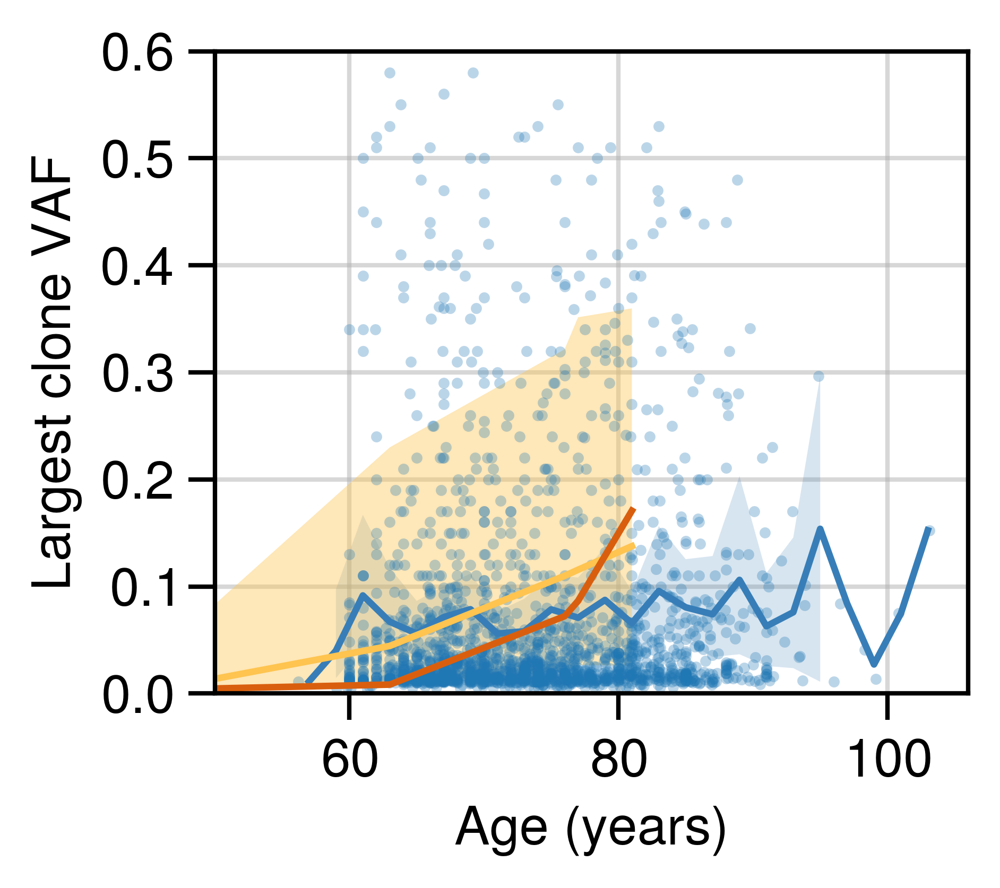

In [48]:
# VAF in fn of age
fig, ax = plt.subplots(1, 1, figsize=(3.3, 2.95), layout="tight")
data.loc[data.is_largest_clone, ["Id", "Age_unbinned", "VAF"]].plot(
    x="Age_unbinned",
    y="VAF",
    ls="",
    marker=".",
    ax=ax,
    alpha=0.3,
    markersize=5,
    markeredgewidth=0,
    legend=False,
)
sns.lineplot(
    data.loc[data.is_largest_clone, ["Id", "Age", "VAF"]],
    x="Age",
    y="VAF",
    color="#377eb8",
    legend=False,
    marker=None,
    ax=ax,
    estimator="mean",
    errorbar=("ci", 99.99),
    n_boot=10_000,
    err_kws={"edgecolor": None},
)
ax.set_xlabel("Age (years)")
ax.set_ylabel("Largest clone VAF")
ax.set_ylim([0, 0.6])
ax.set_xlim([50, 106])

# from the sims and mitchell
cf = pd.read_csv("./cf_posterior.csv")
vaf_mitchell = cf["mean_sim_max_cf"] / 2
vaf_sim_min = cf["min_sim_max_cf"] / 2
vaf_sim_max = cf["max_sim_max_cf"] / 2
ages_mitchell = cf["Age"]
ax.fill_between(
    ages_mitchell, vaf_sim_min, vaf_sim_max, alpha=0.4, color="#fec44f", edgecolor=None
)
"""
grouped = data.loc[data.is_largest_clone, ["Age", "VAF"]].groupby("Age")
ax.fill_between(
    grouped.min().index.to_list(), grouped.min().squeeze(), grouped.max().squeeze(), alpha=0.4, color="#377eb8", edgecolor=None
)
"""
ax.plot(ages_mitchell, vaf_mitchell, c="#fec44f")
# mitchell data
from io import StringIO

# TODO put this in mitchell.py in package hscpy
# source: https://raw.githubusercontent.com/emily-mitchell/normal_haematopoiesis/23d221e8d125d78c1e8bcbe05d41d0f3594b0cfb/7_phylofit/input/expanded_clades.csv
clones = pd.read_csv(
    StringIO(
        """
donor_id,donor_info,variant_ID,number_samples,cf,driver
KX001,29 M,Clade1,4,0.9803922,no known driver
KX002,38 M,Clade1,5,1.3774105,no known driver
SX001,48 M,Clade1,3,0.826446281,no known driver
AX001,63 M,Clade1,6,1.66205,no known driver
KX007,75 M,CREBBP p.N2111S,10,3.1746032,CREBBP
KX007,75 M,Clade1,9,2.8571429,no known driver
KX007,75 M,Clade2,8,2.5396825,no known driver
KX007,75 M,Clade6,6,1.9047619,no known driver
KX007,75 M,Clade5,6,1.9047619,no known driver
KX007,75 M,Clade4,6,1.9047619,no known driver
KX007,75 M,Clade3,6,1.9047619,no known driver
KX007,75 M,Clade9,5,1.5873016,no known driver
KX007,75 M,Clade8,5,1.5873016,no known driver
KX007,75 M,DNMT3A p.G699S,5,1.5873016,DNMT3A
KX007,75 M,Clade7,5,1.5873016,no known driver
KX007,75 M,DNMT3A p.K826R,5,1.5873016,DNMT3A
KX007,75 M,Clade14,4,1.2698413,no known driver
KX007,75 M,Clade13,4,1.2698413,no known driver
KX007,75 M,DNMT3A p.D768Y,4,1.2698413,DNMT3A
KX007,75 M,Clade12,4,1.2698413,no known driver
KX007,75 M,Clade11,4,1.2698413,no known driver
KX007,75 M,Clade10,4,1.2698413,no known driver
KX008,76 F,Clade1 ,53,14.4414169,no known driver
KX008,76 F,Clade2,29,7.9019074,no known driver
KX008,76 F,Clade4,15,4.0871935,no known driver
KX008,76 F,Clade3,15,4.0871935,no known driver
KX008,76 F,Clade5,14,3.8147139,no known driver
KX008,76 F,Clade6,8,2.1798365,no known driver
KX008,76 F,Clade8,6,1.6348774,no known driver
KX008,76 F,Clade7,6,1.6348774,no known driver
KX008,76 F,Clade9,5,1.3623978,no known driver
KX008,76 F,Clade10,5,1.3623978,no known driver
KX008,76 F,Clade12,4,1.0899183,no known driver
KX008,76 F,Clade11,4,1.0899183,no known driver
KX004,77 F,DNMT3A_p.?,78,17.2949002,DNMT3A
KX004,77 F,Clade1 ,46,10.1995565,no known driver
KX004,77 F,DNMT3A_P904L,27,5.9866962,DNMT3A
KX004,77 F,DNMT3A_F752S,23,5.0997783,DNMT3A
KX004,77 F,Clade2,16,3.5476718,no known driver
KX004,77 F,Clade3,13,2.8824834,no known driver
KX004,77 F,Clade5,12,2.6607539,no known driver
KX004,77 F,Clade4,12,2.6607539,no known driver
KX004,77 F,DNMT3A_G843S,11,2.4390244,DNMT3A
KX004,77 F,Clade6,9,1.9955654,no known driver
KX004,77 F,CBL_C404Y,6,1.3303769,CBL
KX004,77 F,DNMT3A_R309G,6,1.3303769,DNMT3A
KX004,77 F,Clade8,5,1.1086475,no known driver
KX004,77 F,DNMT3A_E477fs*14,5,1.1086475,DNMT3A
KX004,77 F,Clade7,5,1.1086475,no known driver
KX003,81 M,Clade1,112,34.146342,no known driver
KX003,81 M,Clade2,10,3.048781,no known driver
KX003,81 M,SETD2 p.L981V,9,2.743902,SETD2
KX003,81 M,Clade3,9,2.743902,no known driver
KX003,81 M,Clade4,8,2.439024,no known driver
KX003,81 M,Clade6,6,1.829268,no known driver
KX003,81 M,Clade5,6,1.829268,no known driver
KX003,81 M,Clade7,5,1.52439,no known driver
KX003,81 M,NOTCH2 p.S1888L,5,1.52439,no known driver
KX003,81 M,DNMT3A p.R659H,4,1.219512,DNMT3A
KX003,81 M,Clade9,4,1.219512,no known driver
KX003,81 M,Clade8,4,1.219512,no known driver
KX003,81 M,Clade10,4,1.219512,no known driver
"""
    )
)
clones = pd.concat(
    [clones, clones.donor_info.str.extract(r"(?P<age>[0-9]+)\s(?P<gender>[MF])")],
    axis=1,
)
clones.drop(
    columns={"donor_info", "variant_ID", "number_samples", "driver"}, inplace=True
)
clones.drop(
    index=clones[clones.donor_id == "KX007"].index, inplace=True
)  # uploaded twice same donor
clones.age = clones.age.astype(int)
ax.plot(
    clones.age.unique(),
    clones[["age", "cf"]].groupby("age").max().to_numpy().ravel() / 200,
    color="#d95f0e",
)
plt.savefig("largest_clone_mitchell_fabre_robertson_merged.svg", dpi=600)
plt.show()

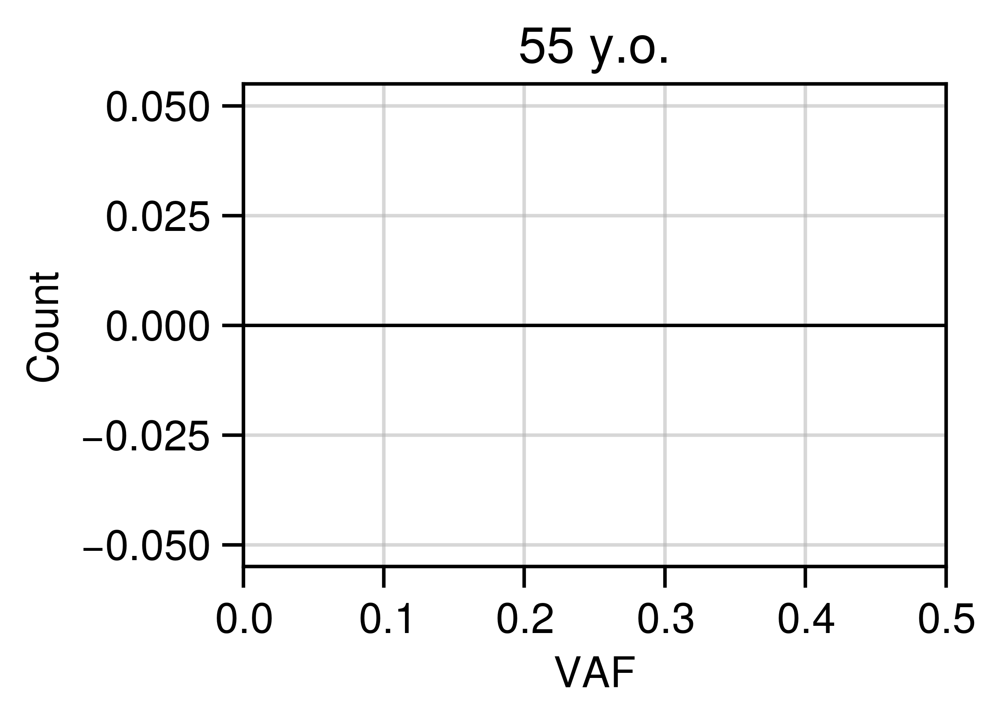

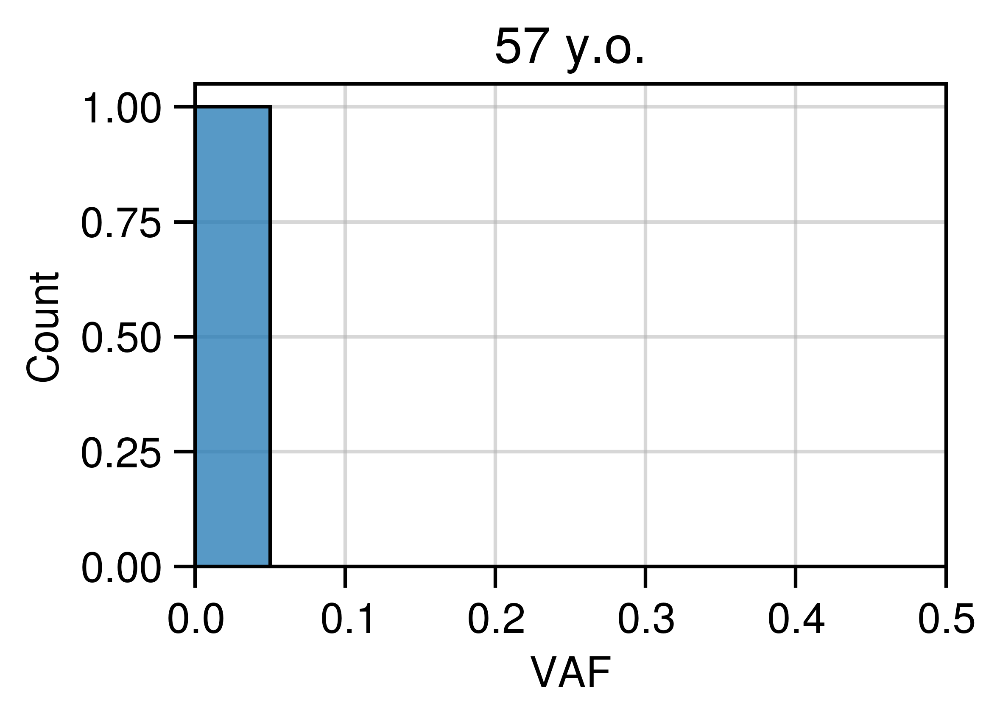

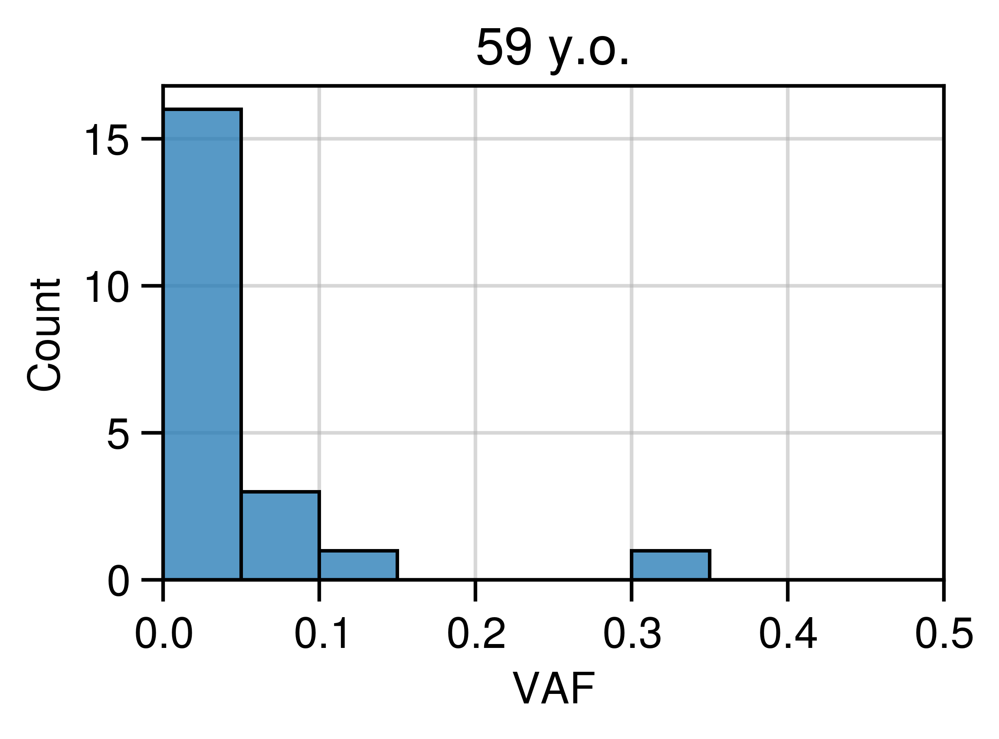

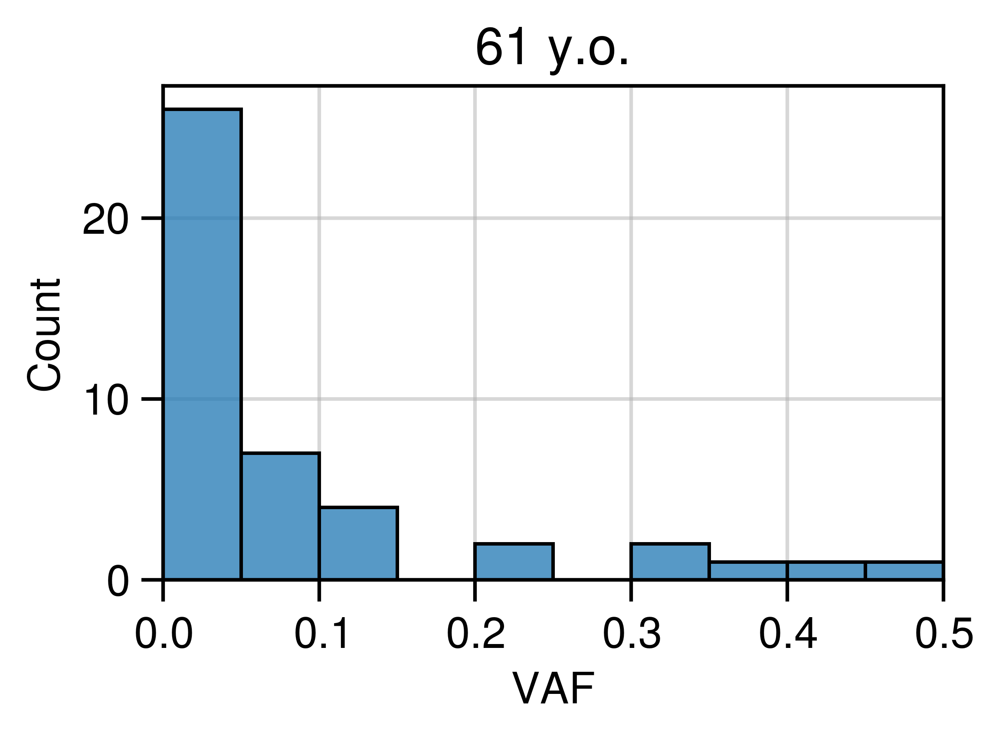

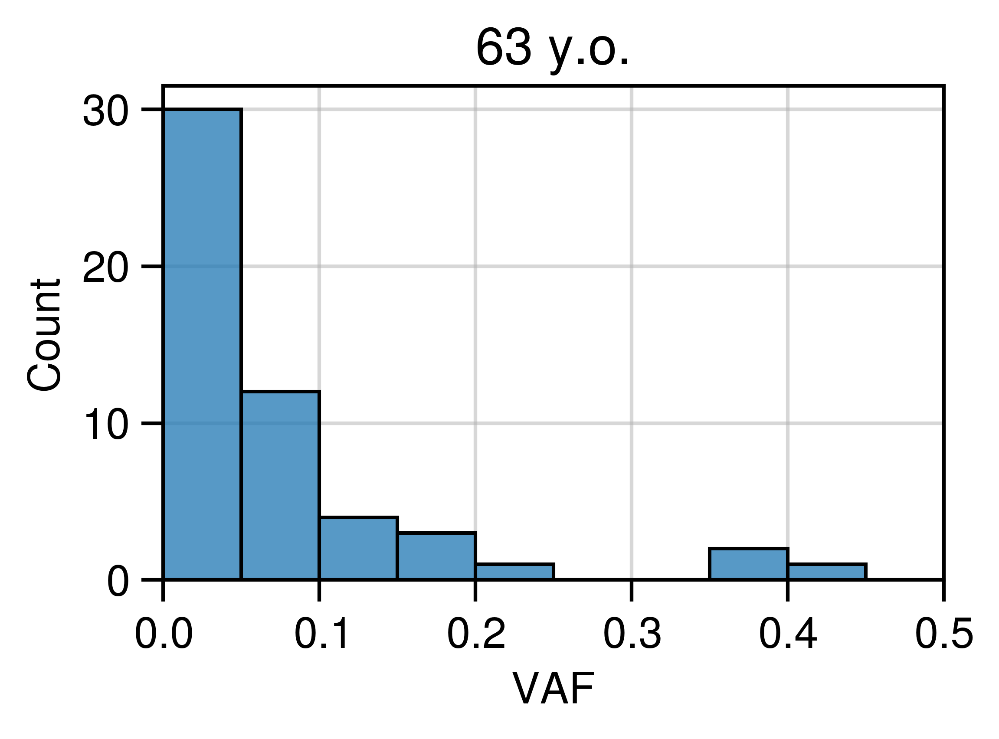

...

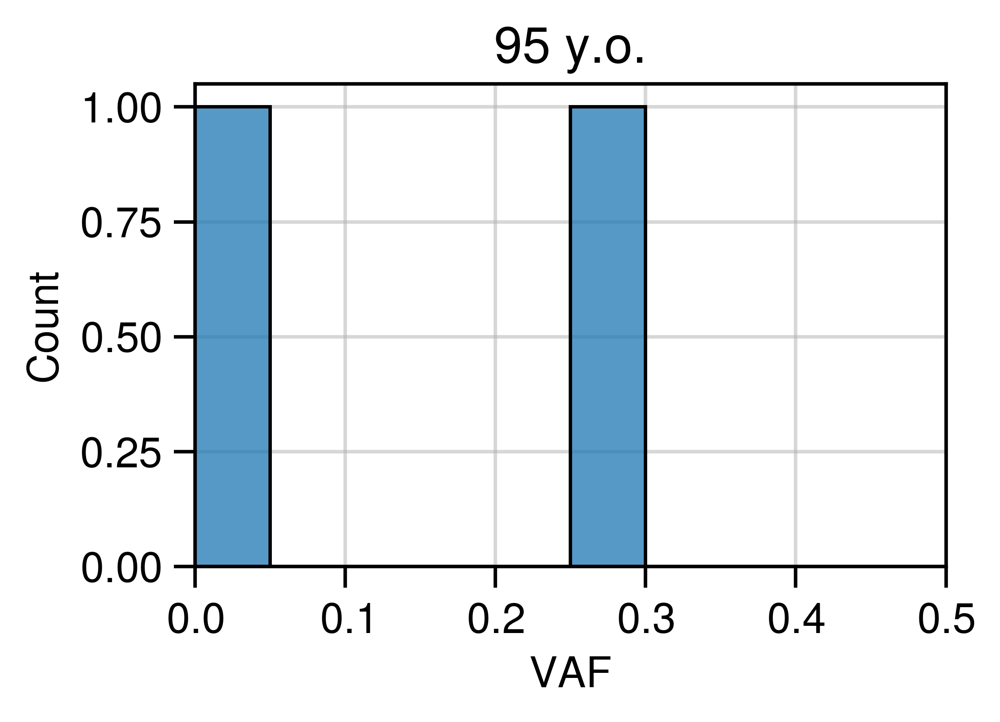

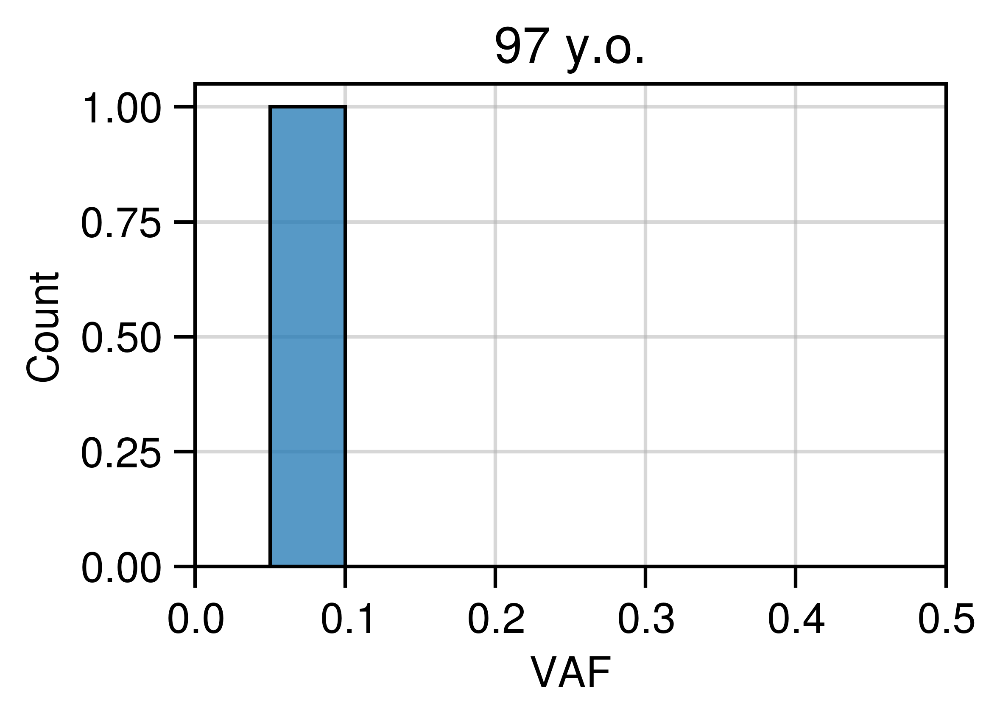

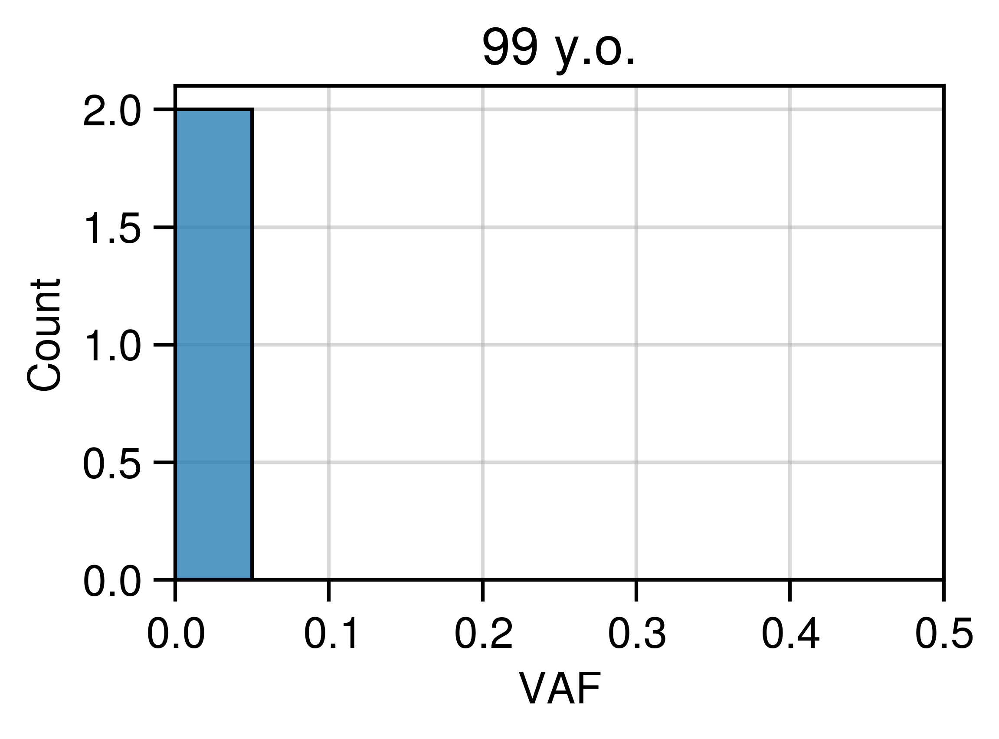

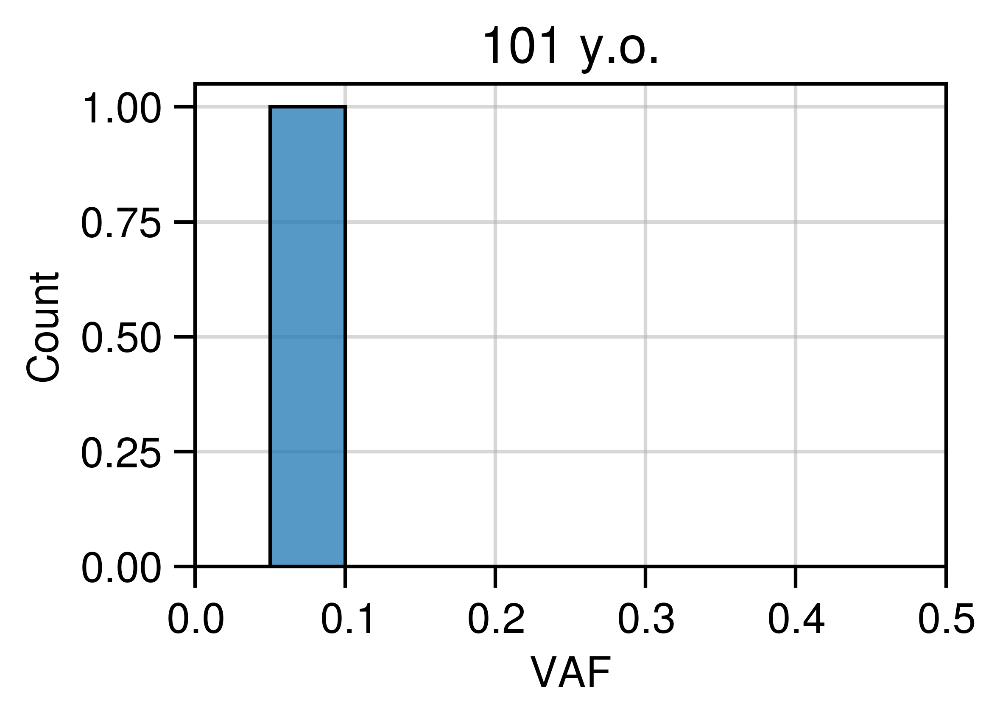

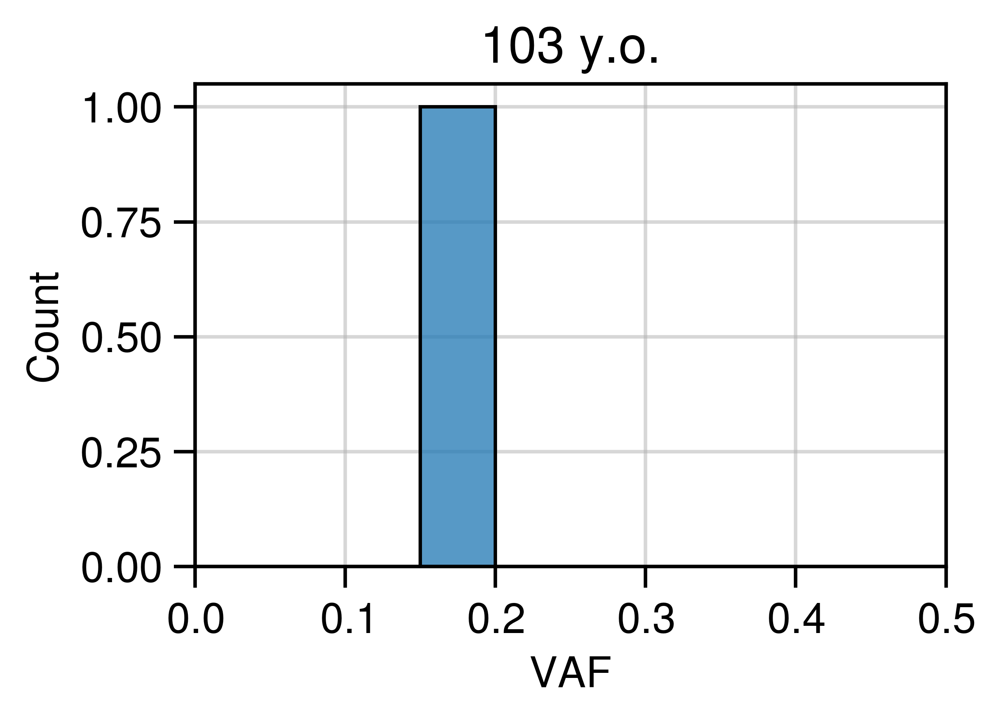

In [49]:
for age in sorted(data.Age.unique()):
    fig, ax = plt.subplots(1, 1, layout="tight", figsize=(4, 3))
    data_age = data.loc[
        (data.Age == age) & (data.is_largest_clone), ["VAF"]
    ].drop_duplicates()
    sns.histplot(data_age, x="VAF", bins=np.arange(0, 1.1, 0.05), ax=ax)
    ax.set_xlim([0, 0.5])
    ax.set_title(f"{age} y.o.")
    ax.set_xlabel("VAF")
    # plt.savefig(f"largest_clone_distr_per_timepoint_robertson_{age}years.svg")
    plt.show()

/home/francesco/venvs/hsc-exploratory/lib/python3.13/site-packages/IPython/core/pylabtools.py:170: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  fig.canvas.print_figure(bytes_io, **kw)


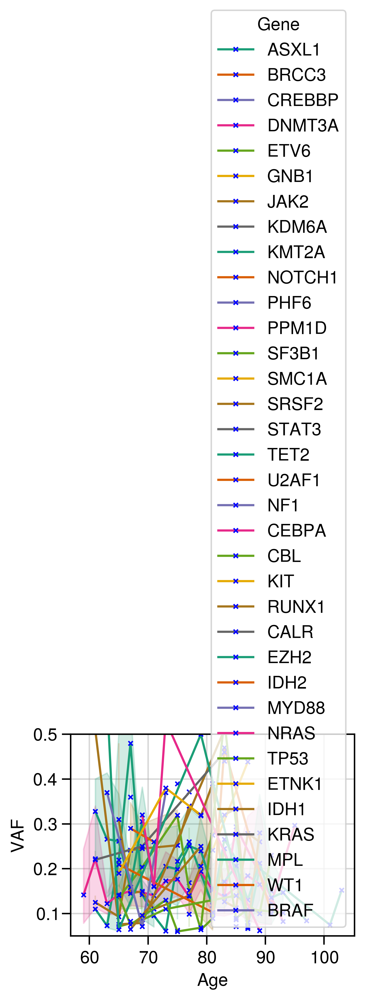

In [50]:
# largest clone per donor
fig, ax = plt.subplots(1, 1, layout="tight")
g = sns.lineplot(
    data.loc[
        (data.is_largest_clone) & (data.VAF >= 0.06),
        ["VAF", "Age", "Id", "Gene"],
    ],
    x="Age",
    y="VAF",
    hue="Gene",
    errorbar=("ci", 95),
    # legend=False,
    palette="Dark2",
    ax=ax,
    marker="x",
    markersize=3,
    markeredgewidth=1,
    markeredgecolor="blue",
)
# sns.move_legend(g, "upper left", bbox_to_anchor=(1, 1), title="Gene", fontsize=8)
ax.set_ylim([0.05, 0.5])
plt.show()

### Number of clones

In [51]:
detected_clones = (
    data.loc[
        :,
        # data.VAF >= 0.01,
        ["VAF", "Age", "Id"],
    ]
    .groupby(["Id", "Age"])
    .count()
)
detected_clones.rename(columns={"VAF": "Detected clones with artefacts"}, inplace=True)
detected_clones.reset_index(inplace=True)
data = pd.merge(
    left=data,
    right=detected_clones,
    how="left",
    on=["Id", "Age"],
    validate="many_to_one",
)
data["Detected clones with artefacts"] = (
    data["Detected clones with artefacts"].fillna(0).astype(int)
)
detected_clones.drop(columns=["Id"]).groupby("Age").describe()

Detected clones with artefacts                                         \
                             count       mean        std  min   25%   50%   
Age                                                                         
55                             7.0   2.428571   0.534522  2.0  2.00   2.0   
57                            14.0   2.142857   1.791310  1.0  1.00   2.0   
59                            85.0   1.541176   1.107904  1.0  1.00   1.0   
61                           187.0   1.545455   0.979257  1.0  1.00   1.0   
63                           275.0   1.607273   1.017341  1.0  1.00   1.0   
65                           373.0   1.506702   0.866387  1.0  1.00   1.0   
67                           396.0   1.727273   1.182730  1.0  1.00   1.0   
69                           402.0   5.179104  24.004421  1.0  1.00   1.0   
71                           389.0   1.989717   1.419633  1.0  1.00   2.0   
73                           408.0   5.497549  24.147682  1.0  1.00   2.0   
75                           351.0   6.131054  25.696802  1.0  1.00   2.0   
77                           315.0   2.295238   1.642918  1.0  1.00   2.0   
79                           286.0   6.678322  28.370754  1.0  1.00   2.0   
81                           232.0   2.715517   4.004988  1.0  1.00   2.0   
83                           186.0   2.327957   1.554409  1.0  1.00   2.0   
85                           202.0  12.074257  27.074054  1.0  1.00   2.0   
87                           113.0  19.424779  34.533319  1.0  1.00   3.0   
89                            49.0   2.204082   1.554290  1.0  1.00   2.0   
91                            49.0  39.959184  44.458763  1.0  2.00  27.0   
93                            16.0   3.312500   1.537043  1.0  2.75   3.0   
95                             3.0   3.000000   1.000000  2.0  2.50   3.0   
97                             1.0   3.000000        NaN  3.0  3.00   3.0   
99                             2.0   3.500000   2.121320  2.0  2.75   3.5   
101                            2.0   4.000000   1.414214  3.0  3.50   4.0   
103                            1.0   7.000000        NaN  7.0  7.00   7.0   

                   
       75%    max  
Age                
55    3.00    3.0  
57    2.00    8.0  
59    2.00    8.0  
61    2.00    7.0  
63    2.00    8.0  
65    2.00    7.0  
67    2.00    9.0  
69    2.00  445.0  
71    3.00   12.0  
73    3.00  449.0  
75    3.00  445.0  
77    3.00   12.0  
79    3.00  445.0  
81    3.00   38.0  
83    3.00    7.0  
85    5.00  181.0  
87   11.00  182.0  
89    3.00    7.0  
91   72.00  180.0  
93    4.00    7.0  
95    3.50    4.0  
97    3.00    3.0  
99    4.25    5.0  
101   4.50    5.0  
103   7.00    7.0

In [52]:
detected_clones = (
    data.loc[
        # (~data.is_sequencing_artefact) & (data.VAF >= 0.01),
        ~data.is_sequencing_artefact,
        ["VAF", "Age", "Id"],
    ]
    .groupby(["Id", "Age"])
    .count()
)
detected_clones.rename(columns={"VAF": "Detected clones"}, inplace=True)
detected_clones.reset_index(inplace=True)
data = pd.merge(
    left=data,
    right=detected_clones,
    how="left",
    on=["Id", "Age"],
    validate="many_to_one",
)
data["Detected clones"] = data["Detected clones"].fillna(0).astype(int)
detected_clones.drop(columns=["Id"]).groupby("Age").describe()

Detected clones                                               
              count      mean       std  min   25%  50%   75%  max
Age                                                               
55              5.0  1.200000  0.447214  1.0  1.00  1.0  1.00  2.0
57              7.0  1.285714  0.487950  1.0  1.00  1.0  1.50  2.0
59             79.0  1.253165  0.542273  1.0  1.00  1.0  1.00  3.0
61            173.0  1.352601  0.653663  1.0  1.00  1.0  2.00  5.0
63            263.0  1.414449  0.730536  1.0  1.00  1.0  2.00  6.0
65            353.0  1.342776  0.601901  1.0  1.00  1.0  2.00  4.0
67            381.0  1.485564  0.816234  1.0  1.00  1.0  2.00  7.0
69            371.0  1.455526  0.731559  1.0  1.00  1.0  2.00  5.0
71            359.0  1.637883  0.961442  1.0  1.00  1.0  2.00  8.0
73            372.0  1.553763  0.957204  1.0  1.00  1.0  2.00  9.0
75            309.0  1.679612  1.002078  1.0  1.00  1.0  2.00  6.0
77            293.0  1.774744  1.112096  1.0  1.00  1.0  2.00  7.0
79            258.0  1.697674  0.994965  1.0  1.00  1.0  2.00  7.0
81            216.0  1.907407  1.197183  1.0  1.00  2.0  2.00  9.0
83            184.0  1.907609  1.129411  1.0  1.00  1.5  3.00  6.0
85            173.0  2.034682  1.367802  1.0  1.00  2.0  3.00  9.0
87             97.0  1.835052  1.077037  1.0  1.00  1.0  2.00  6.0
89             48.0  1.833333  1.058569  1.0  1.00  1.5  2.00  5.0
91             35.0  1.914286  1.442454  1.0  1.00  1.0  2.50  6.0
93             16.0  2.625000  1.147461  1.0  2.00  3.0  3.00  5.0
95              3.0  2.333333  1.527525  1.0  1.50  2.0  3.00  4.0
97              1.0  3.000000       NaN  3.0  3.00  3.0  3.00  3.0
99              2.0  2.500000  2.121320  1.0  1.75  2.5  3.25  4.0
101             2.0  3.000000  2.828427  1.0  2.00  3.0  4.00  5.0
103             1.0  6.000000       NaN  6.0  6.00  6.0  6.00  6.0

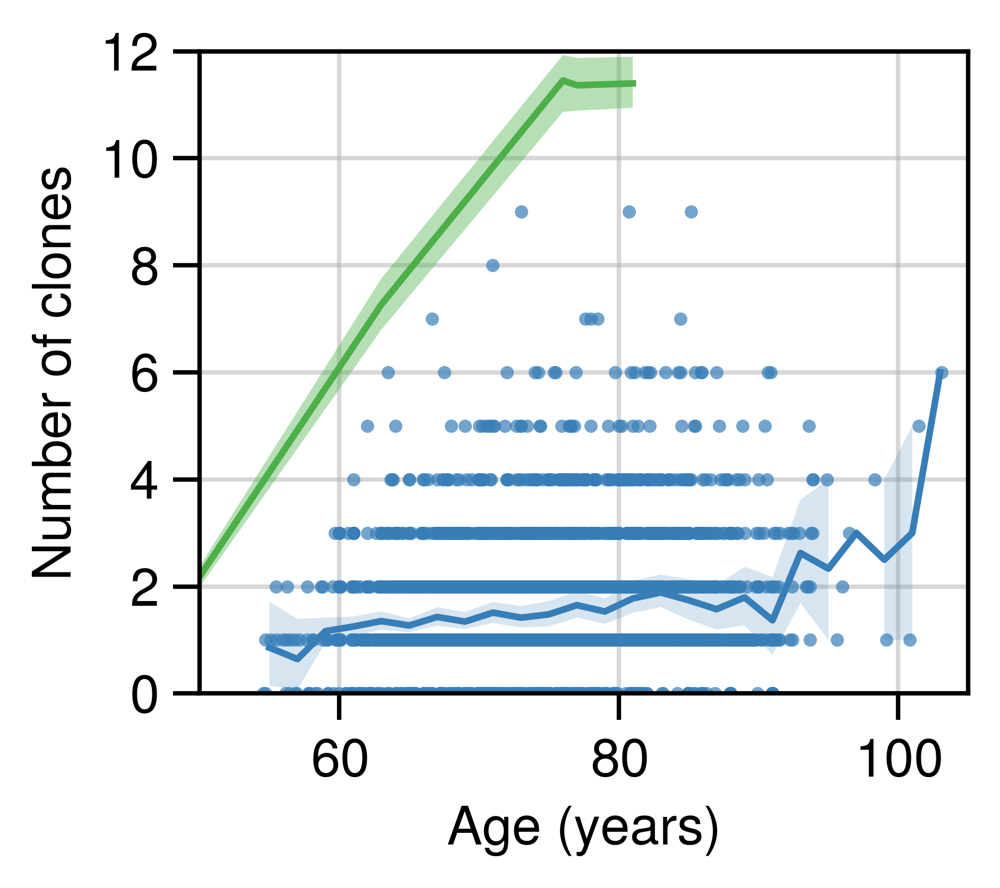

In [54]:
fig, ax = plt.subplots(1, 1, figsize=(3.3, 2.95), layout="tight")
sns.lineplot(
    data[["Id", "Age", "Detected clones"]].drop_duplicates(),
    x="Age",
    y="Detected clones",
    legend=False,
    color="#377eb8",
    ax=ax,
    estimator="mean",
    errorbar=("ci", 99.99),
    n_boot=10_000,
    err_kws={"edgecolor": None},
)

data[["Id", "Age_unbinned", "Detected clones"]].drop_duplicates().plot(
    x="Age_unbinned",
    y="Detected clones",
    ls="",
    marker=".",
    ax=ax,
    legend=False,
    alpha=0.7,
    color="#377eb8",
    markeredgewidth=0,
)

ax.set_ylabel("Number of clones")
ax.set_xlabel("Age (years)")
res = compute_spearmanr_vs_age(data, "Detected clones")
"""
ax.text(
    x=0.05,
    y=0.8,
    s=f"R={res.statistic:.2f}\np={res.pvalue:.2f}",
    transform=ax.transAxes,
    fontsize=12,
)
"""
# from the sims and mitchell
clones_mitchell = pd.read_csv("./clones_posterior.csv")
ax.fill_between(
    clones_mitchell["age"],
    clones_mitchell["mean_sim_clones_ci_low"],
    clones_mitchell["mean_sim_clones_ci_high"],
    alpha=0.4,
    color="#4daf4a",
    edgecolor=None,
)
ax.plot(clones_mitchell["age"], clones_mitchell["mean_sim_clones"], c="#4daf4a")
ax.set_ylim([0, 12])
ax.set_xlim([50, 105])
plt.savefig("expanded_clones_fabre_robertson_merged.png", dpi=600)
plt.show()

0.26235672728085346


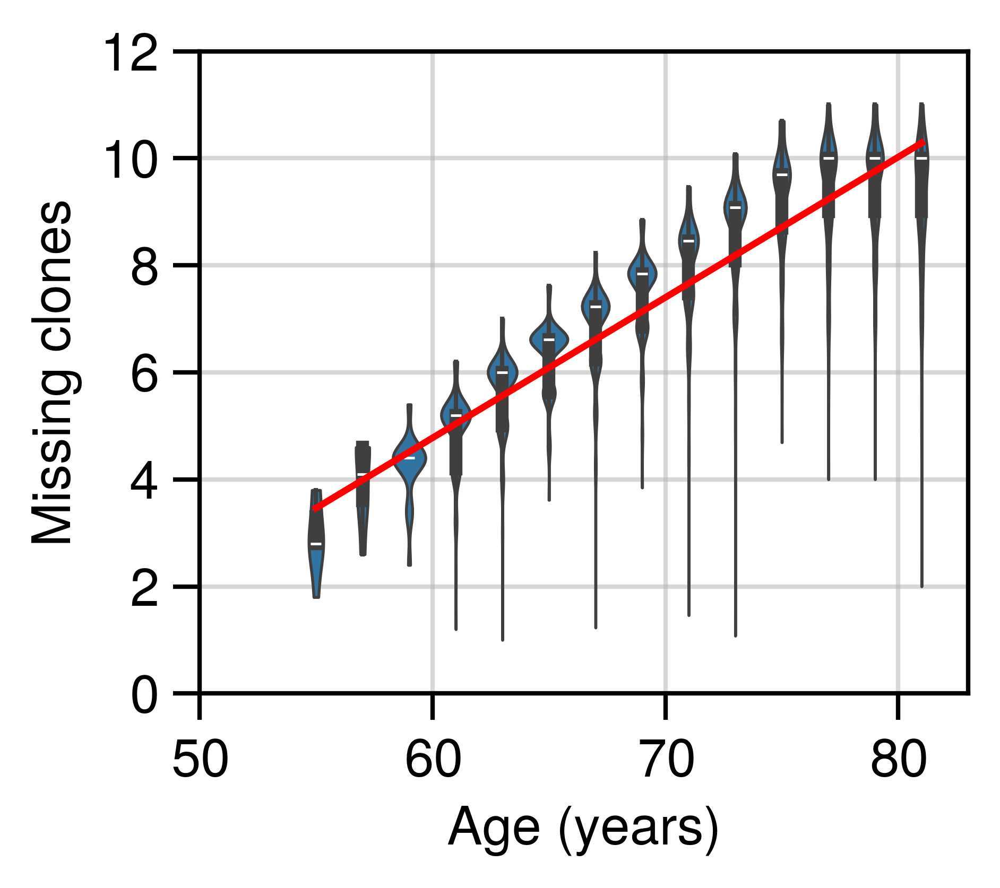

,Age,median_sim_clones,Id,Detected clones,Number of missing clones
0,61.0,6.200000,SardID_260,2,4.200000
1,65.0,7.615385,SardID_260,2,5.615385
2,67.0,8.230769,SardID_260,3,5.230769
3,71.0,9.461538,SardID_260,5,4.461538
4,75.0,10.692308,SardID_260,6,4.692308
...,...,...,...,...,...
3715,81.0,11.000000,719,1,10.000000
3716,81.0,11.000000,3218,1,10.000000
3717,71.0,9.461538,793,1,8.461538
3718,81.0,11.000000,404,1,10.000000


In [56]:
## get the number of clones
df = data.loc[
    data.Age <= clones_mitchell["age"].max(), ["Id", "Age", "Detected clones"]
].drop_duplicates()
# interpolate to find the fn
median_sim_clones = pd.DataFrame(
    [
        df.Age.unique(),
        np.interp(
            x=df.Age.unique(),
            xp=clones_mitchell["age"],
            fp=clones_mitchell["median_sim_clones"],
        ),
    ]
).T.rename(columns={0: "Age", 1: "median_sim_clones"})
df = pd.merge(
    right=df, left=median_sim_clones, on="Age", how="right", validate="one_to_many"
)
df["Number of missing clones"] = df["median_sim_clones"] - df["Detected clones"]
fig, ax = plt.subplots(1, 1, figsize=(3.3, 2.95), layout="tight")
sns.violinplot(
    data=df,
    x="Age",
    y="Number of missing clones",
    linewidth=0.65,
    inner="box",
    native_scale=True,
    ax=ax,
    cut=0,
)
g = df[["Age", "Number of missing clones"]].groupby("Age").mean()
x = g.index.to_numpy()
y = g["Number of missing clones"].to_numpy()
A = np.vstack([x, np.ones(len(x))]).T
m, c = np.linalg.lstsq(A, y)[0]
# ax.plot(x, m*x + c, 'r', label='Fitted line')
print(m)
ax.set_ylim([0, 12])
ax.set_xlim([50, df.Age.max() + 2])
ax.set_xlabel("Age (years)")
ax.set_ylabel("Missing clones")
plt.savefig("missing_clones.png", dpi=600)
plt.show()

df.to_csv("missing_clones.csv", index=False)
pd.read_csv("./missing_clones.csv")

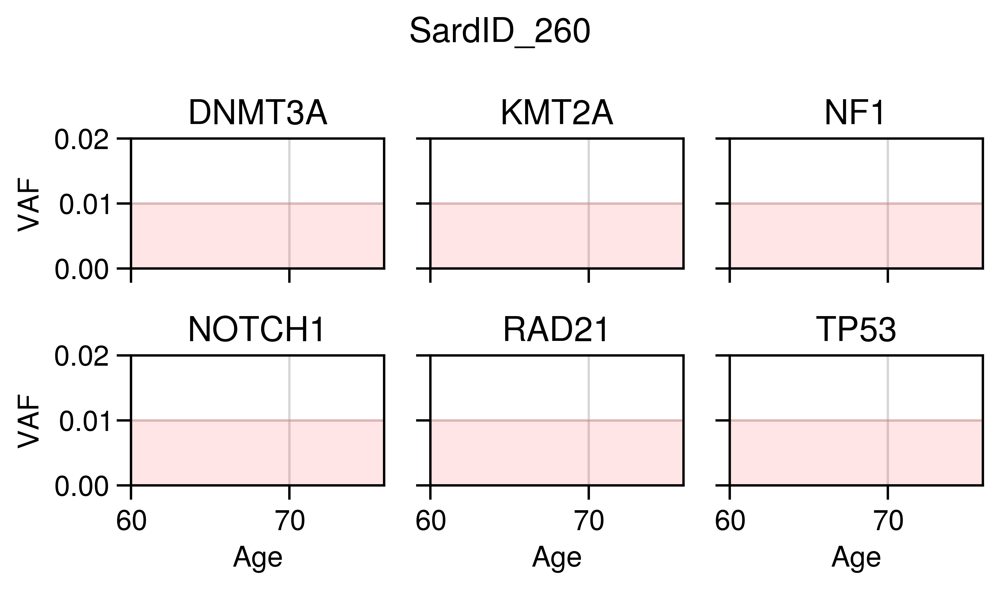

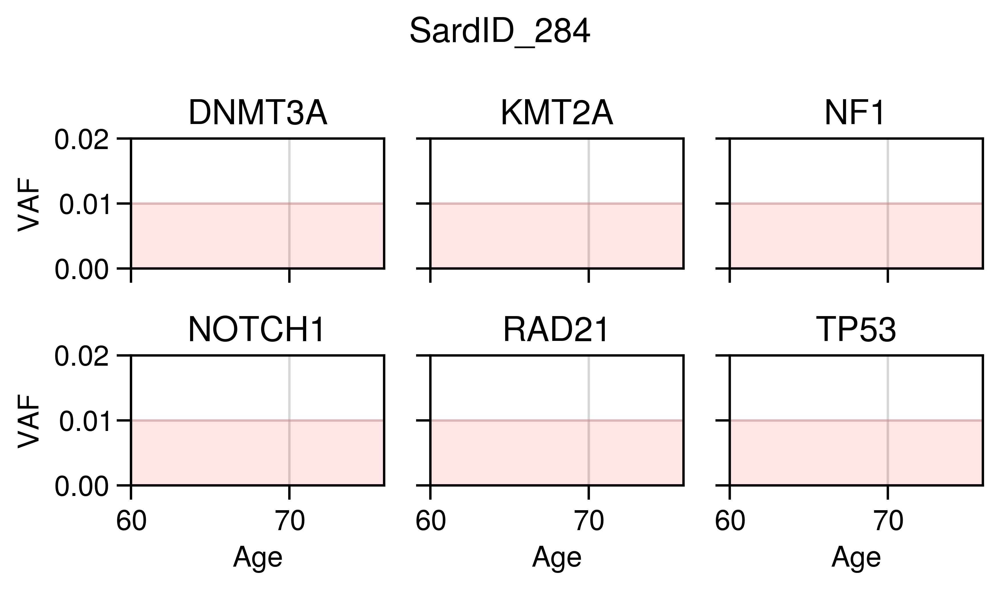

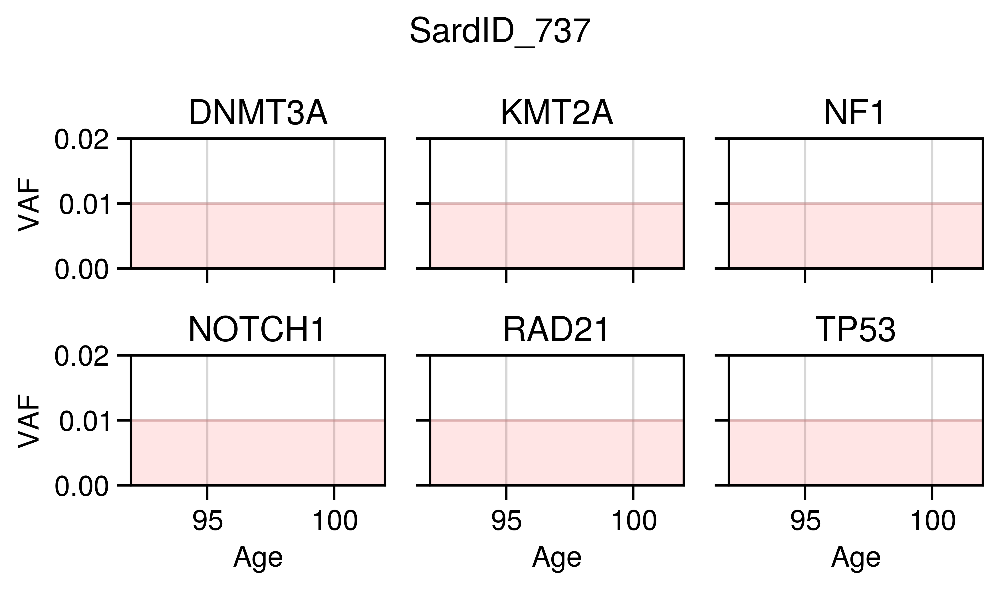

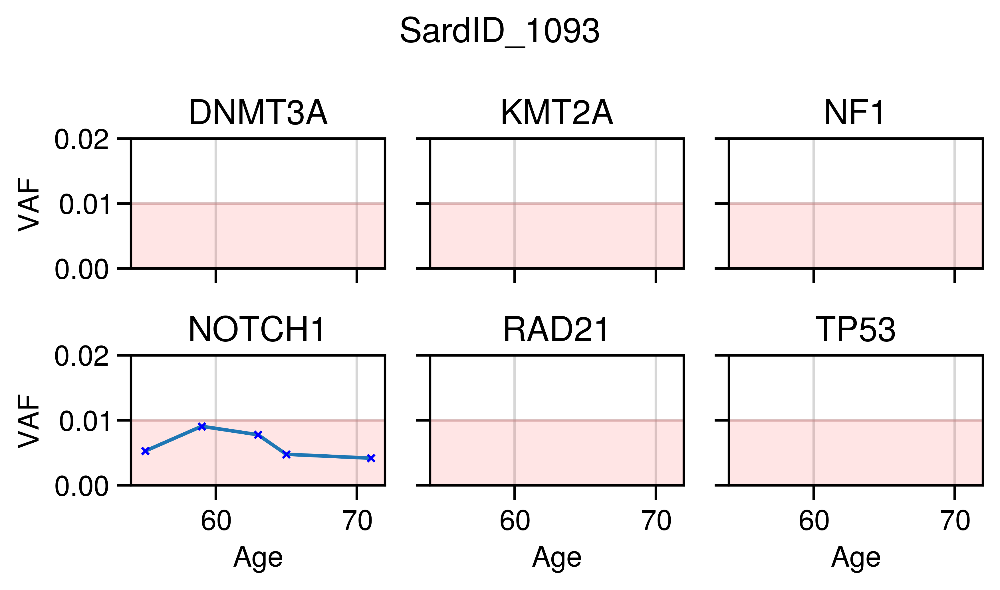

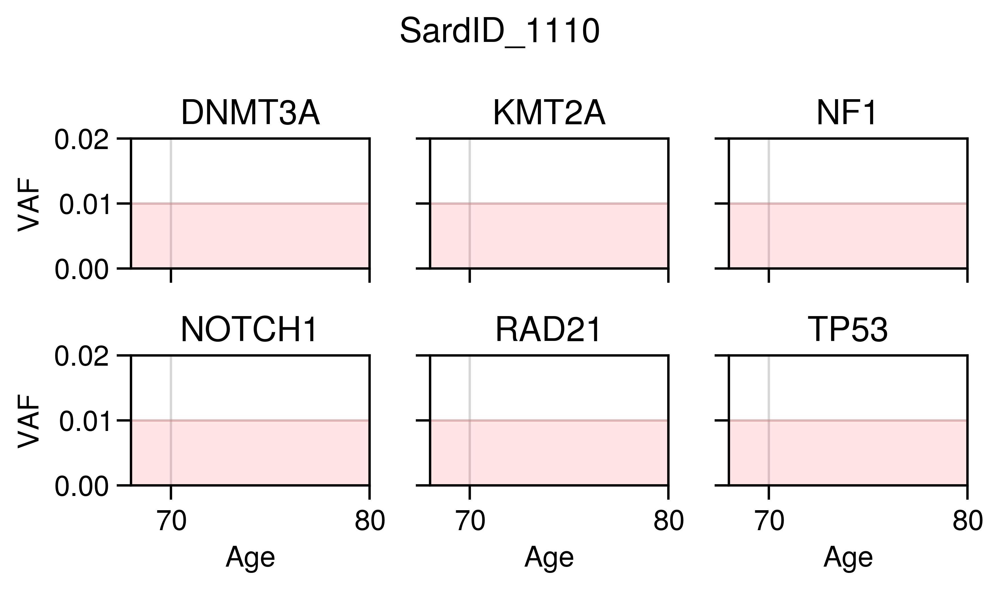

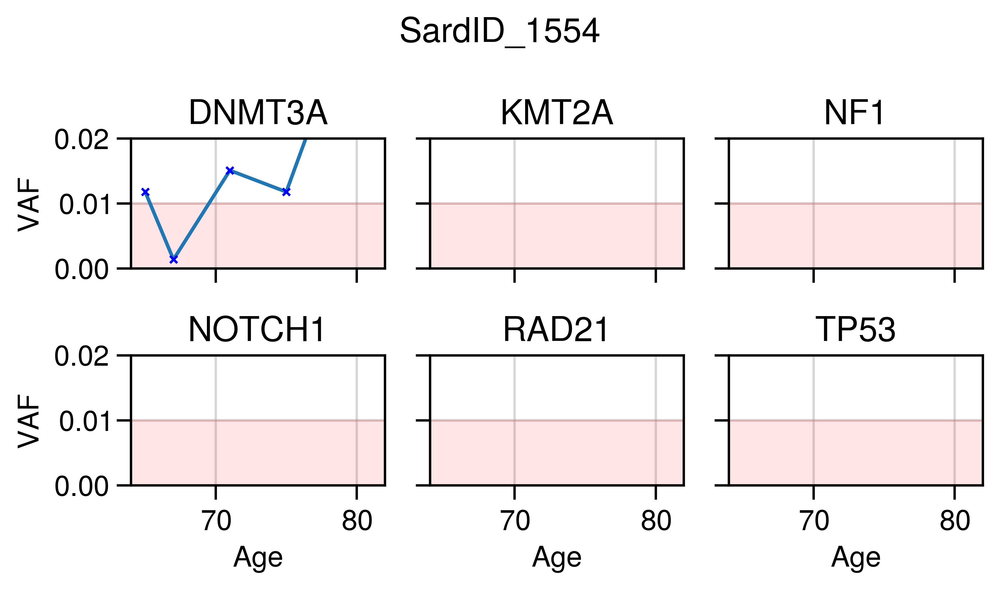

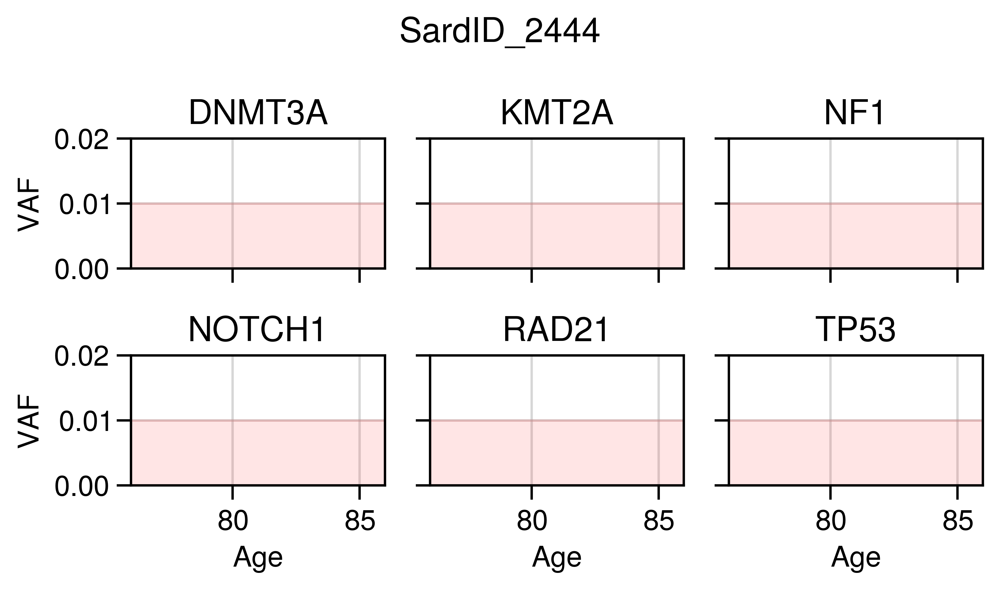

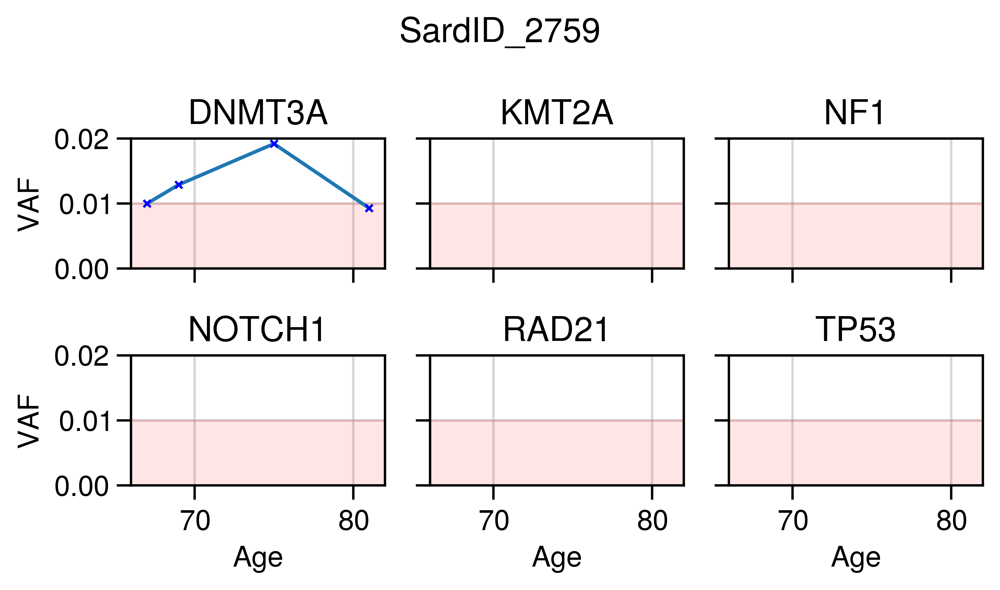

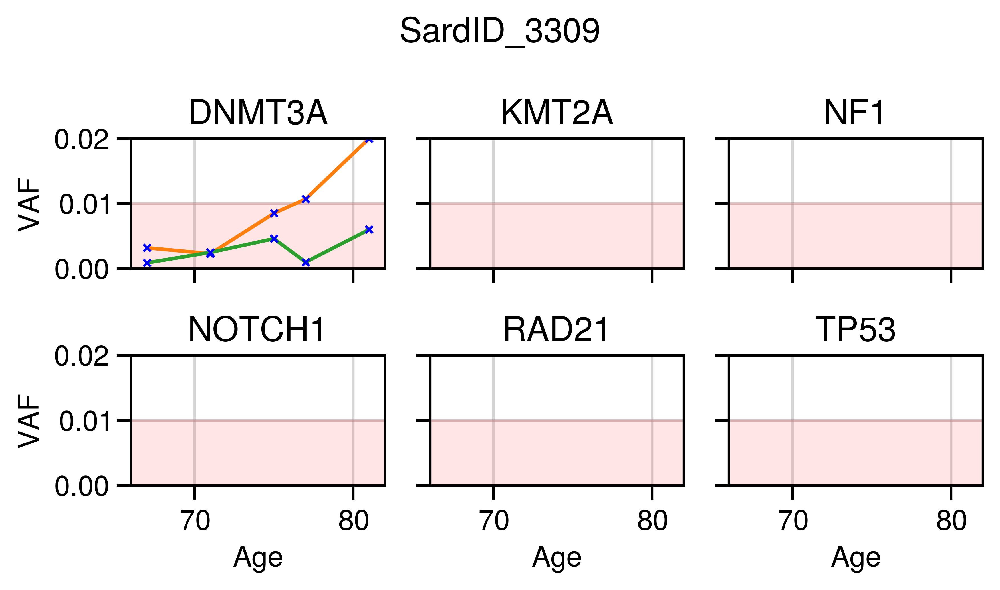

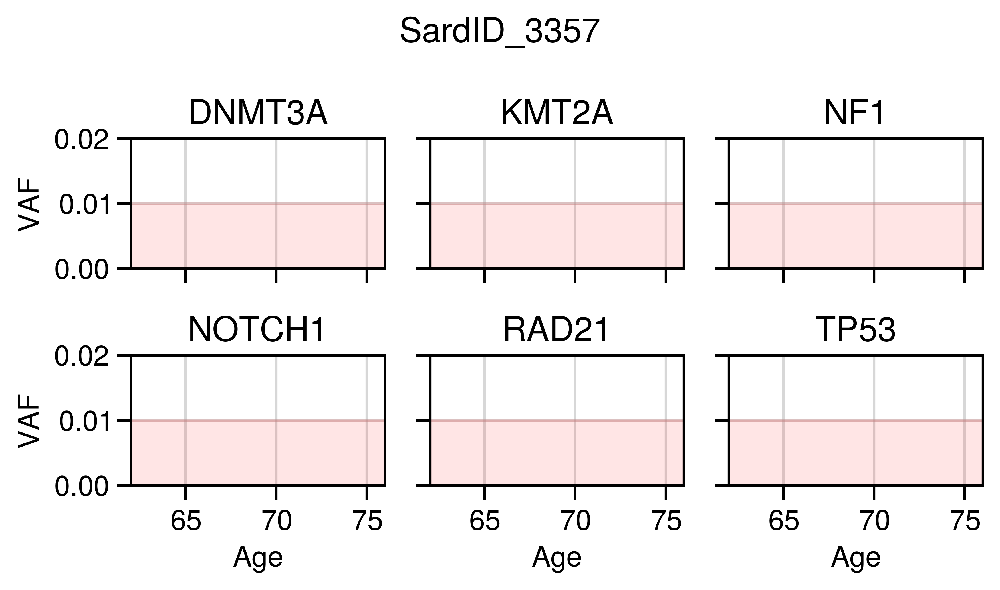

In [57]:
genes = sorted(["KMT2A", "DNMT3A", "NOTCH1", "TP53", "NF1", "RAD21"])
for participant in data.loc[data.cohort == "Sard", "Id"].unique()[:10]:
    xlims = (
        data.loc[data["Id"] == participant, "Age"].min() - 1,
        data.loc[data["Id"] == participant, "Age"].max() + 1,
    )
    fig, axes = plt.subplots(
        2, 3, figsize=(6, 3.5), layout="tight", sharey=True, sharex=True
    )
    tmp = data.loc[
        (data["Id"] == participant) & (data["Gene"].isin(genes)),
        ["VAF", "AAChange", "Age", "Gene"],
    ]
    ylims = 0, VALID_VARIANT_AF
    for gene, ax in zip(genes, axes.ravel()):
        sns.lineplot(
            data=tmp[tmp.Gene == gene],
            x="Age",
            y="VAF",
            hue="AAChange",
            marker="x",
            markersize=3,
            markeredgewidth=1,
            markeredgecolor="blue",
            legend=False,
            ax=ax,
        )
        ax.set_title(gene)
        ax.set_ylim(ylims)
        ax.set_xlim(xlims)
        ax.fill_between(
            x=np.arange(xlims[0], xlims[1] + 1),
            y1=0,
            y2=0.01,
            color="red",
            alpha=0.1,
            edgecolor="face",
        )
    fig.suptitle(participant)
    plt.show()

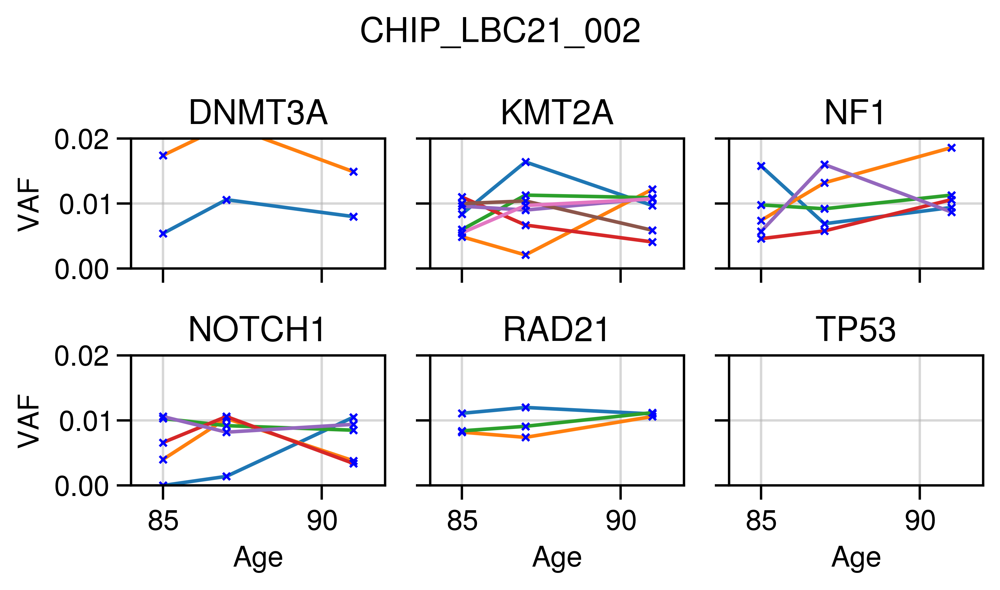

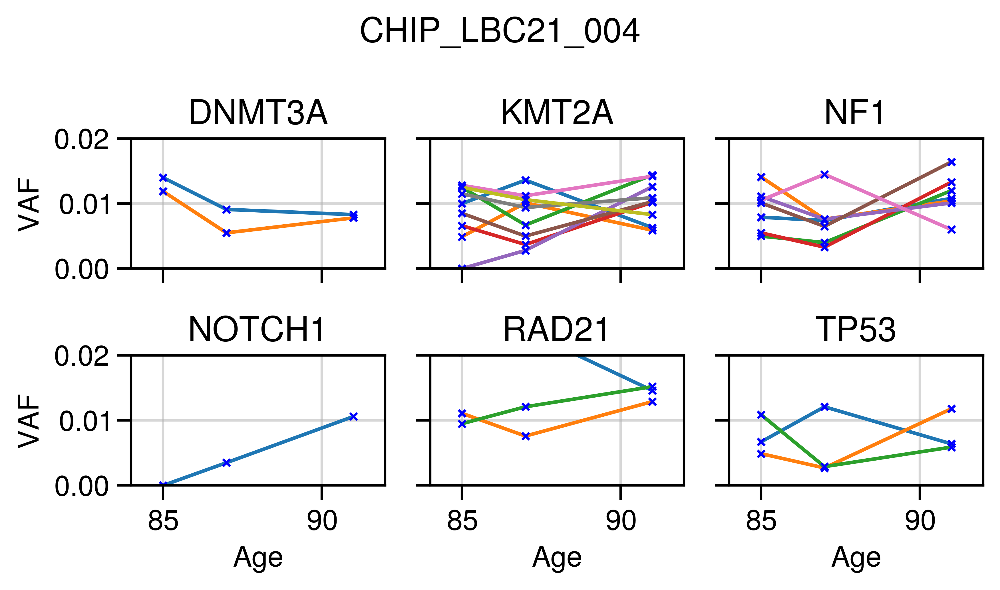

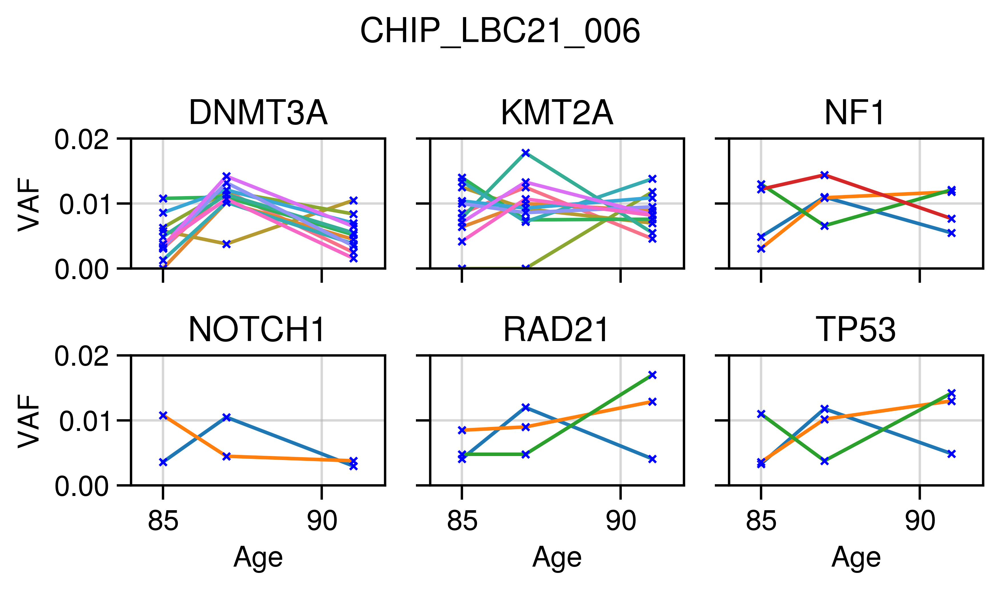

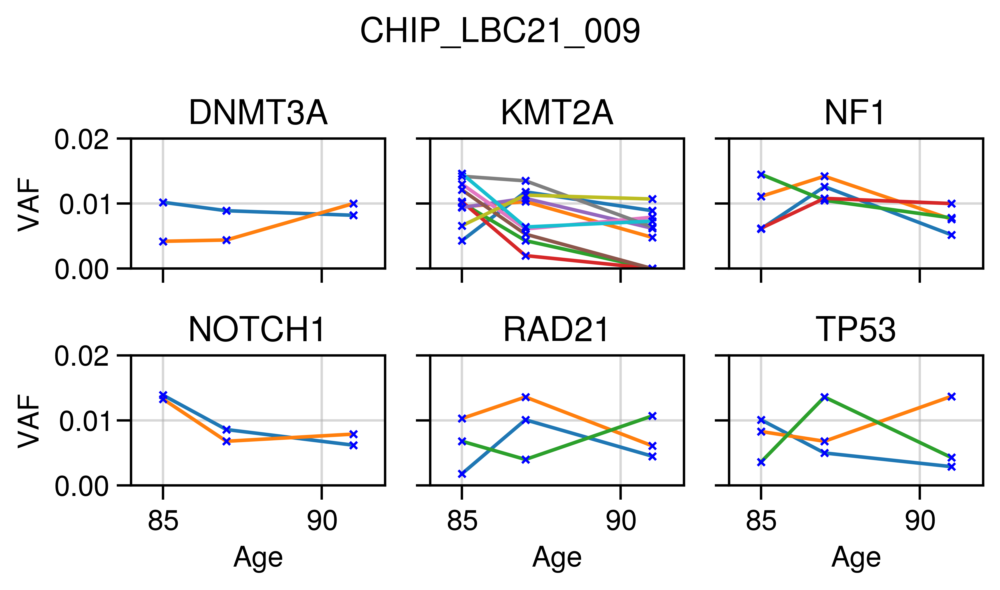

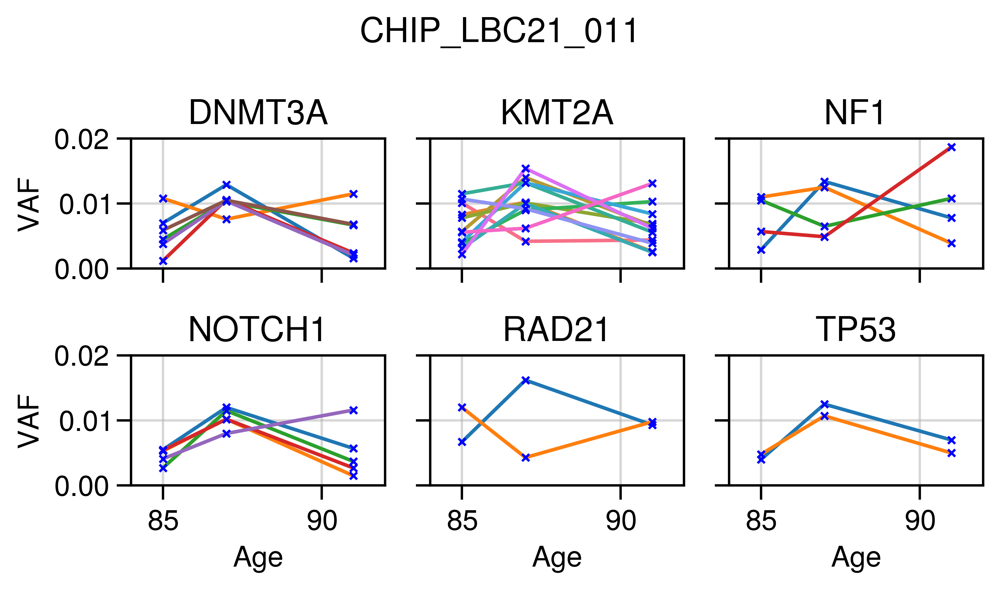

...

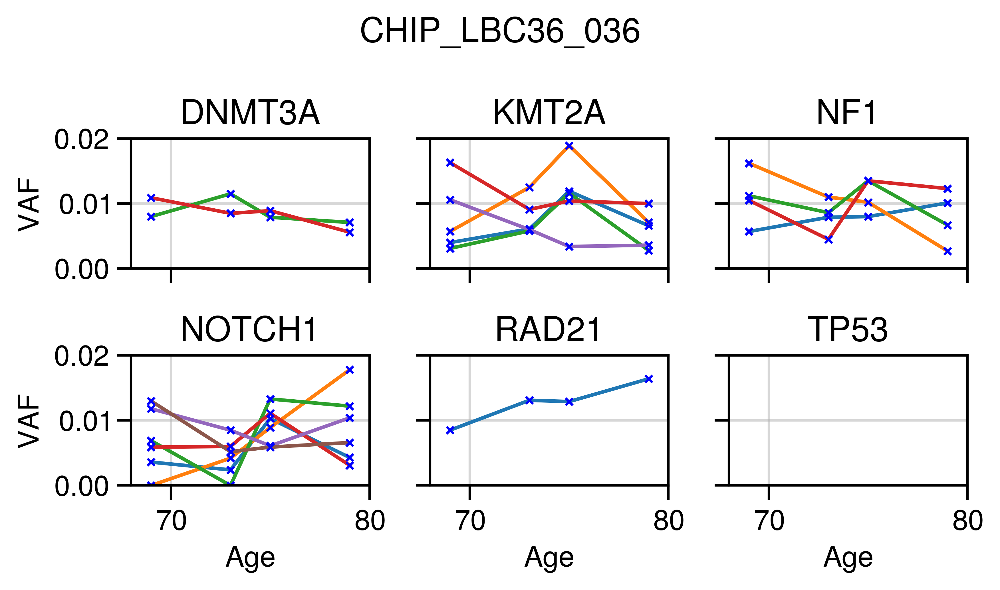

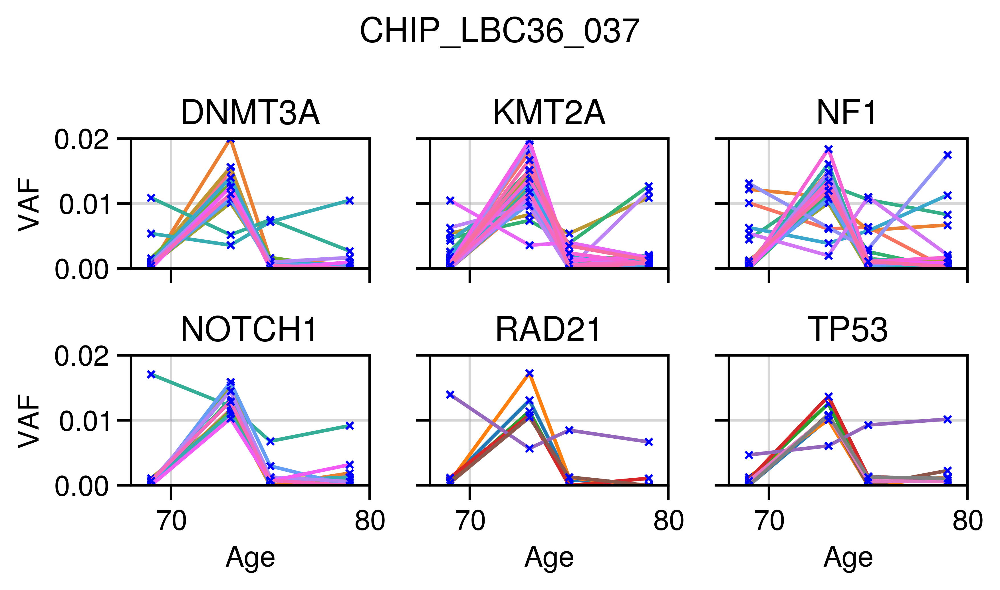

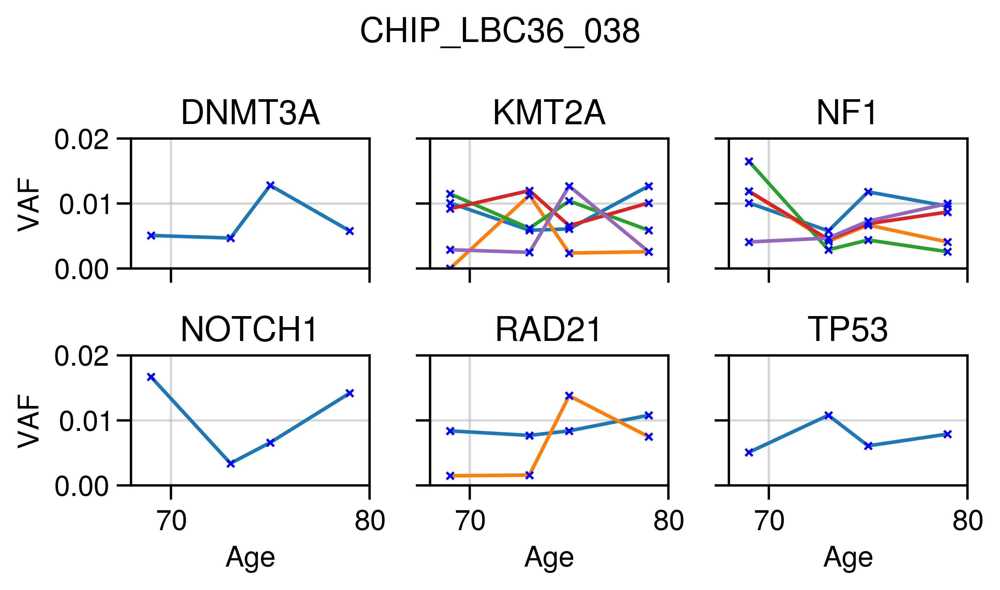

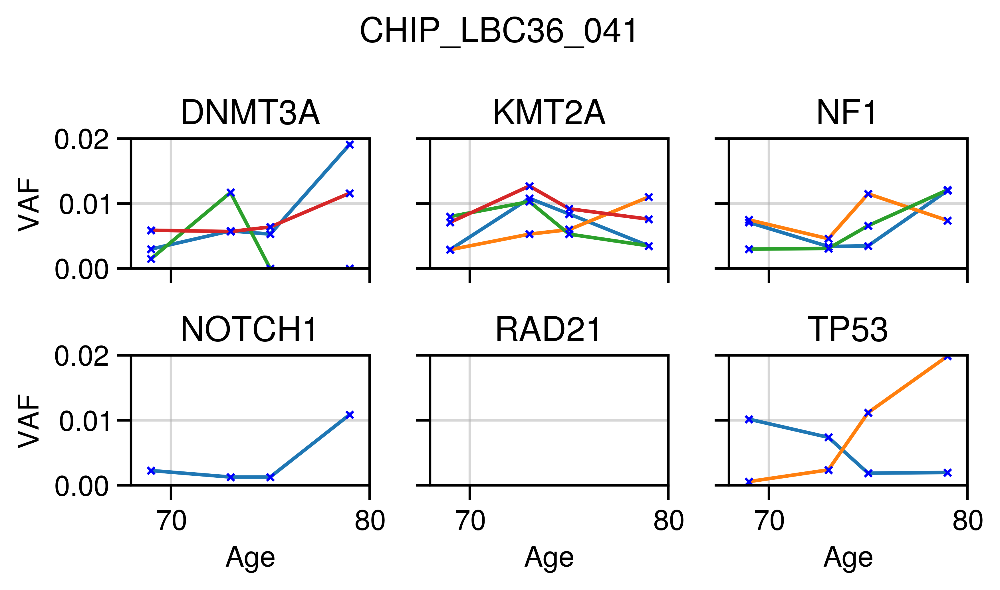

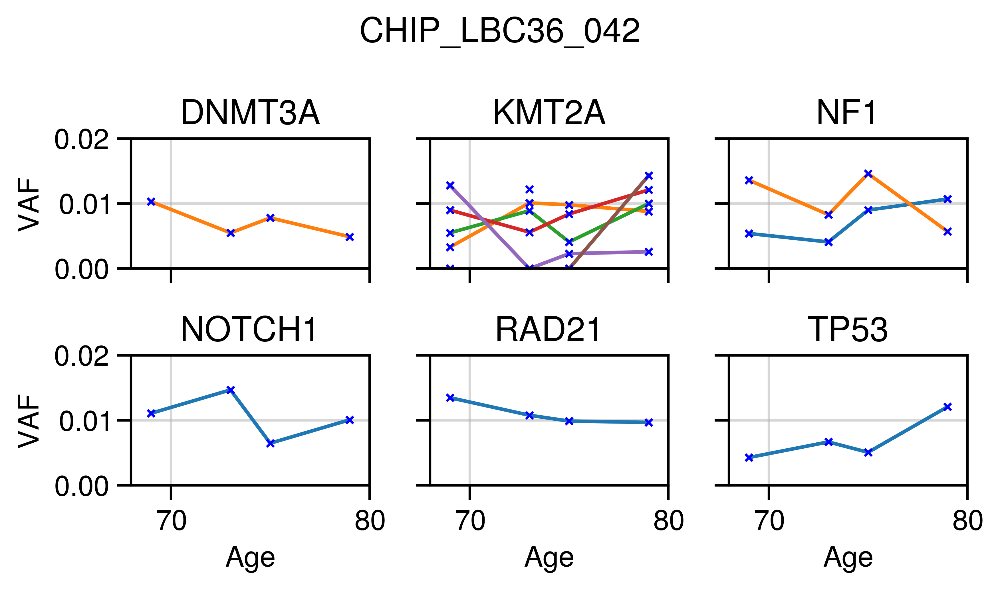

In [58]:
# hitchhiking: how can we distinguish between hichhikers and clones?
# this is probably not hitchhiking otherwise we would observe that also
# with higher AF, which is not the case.
# Based on this we discard all variants with AF < 0.02 for the largest clones
# genes = {"NF1", "NOTCH1", "TP53"}
genes = sorted(["KMT2A", "DNMT3A", "NOTCH1", "TP53", "NF1", "RAD21"])
for participant in data.loc[data["Detected clones with artefacts"] > 30, "Id"].unique():
    xlims = (
        data.loc[data["Id"] == participant, "Age"].min() - 1,
        data.loc[data["Id"] == participant, "Age"].max() + 1,
    )
    fig, axes = plt.subplots(
        2, 3, figsize=(6, 3.5), layout="tight", sharey=True, sharex=True
    )
    tmp = data.loc[
        (data["Id"] == participant) & (data["Gene"].isin(genes)),
        ["VAF", "AAChange", "Age", "Gene"],
    ]
    ylims = 0, VALID_VARIANT_AF
    for gene, ax in zip(genes, axes.ravel()):
        sns.lineplot(
            data=tmp[tmp.Gene == gene],
            x="Age",
            y="VAF",
            hue="AAChange",
            marker="x",
            markersize=3,
            markeredgewidth=1,
            markeredgecolor="blue",
            legend=False,
            ax=ax,
        )
        ax.set_title(gene)
        ax.set_ylim(ylims)
        ax.set_xlim(xlims)
    fig.suptitle(participant)
    plt.savefig(f'{str("_").join(genes)}_{participant}.png', dpi=600)
    plt.show()

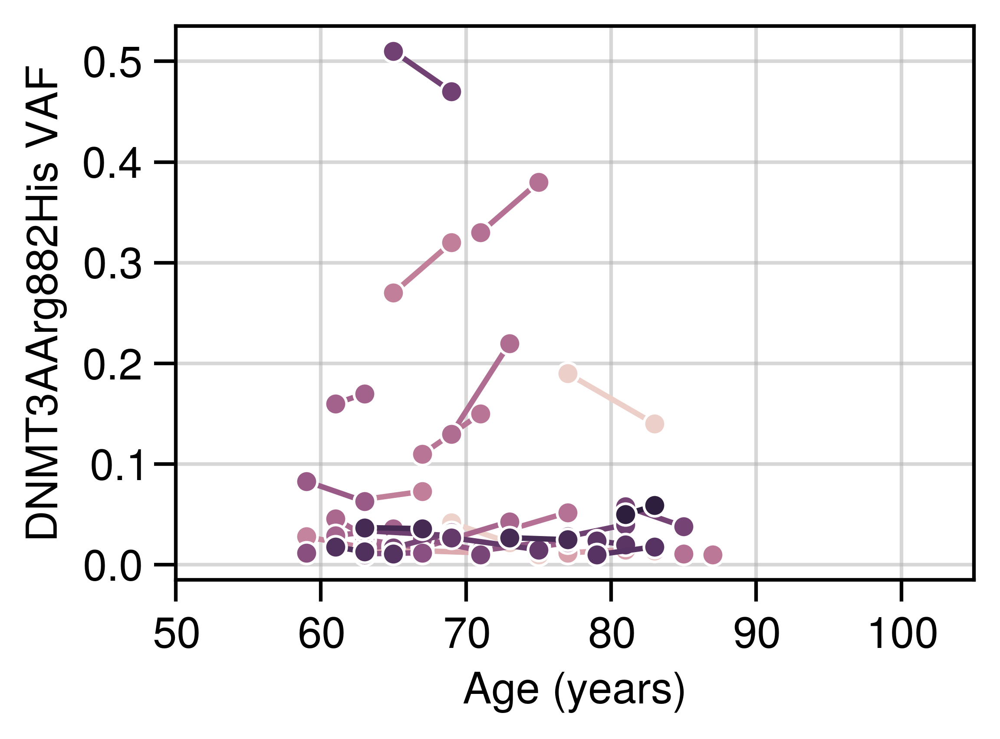

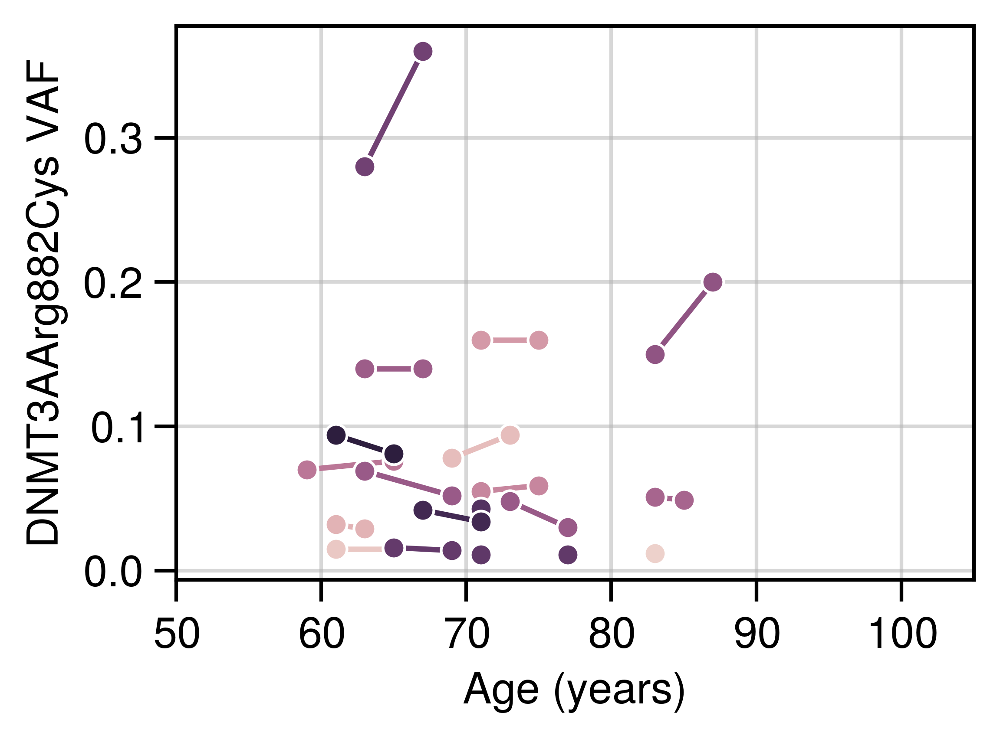

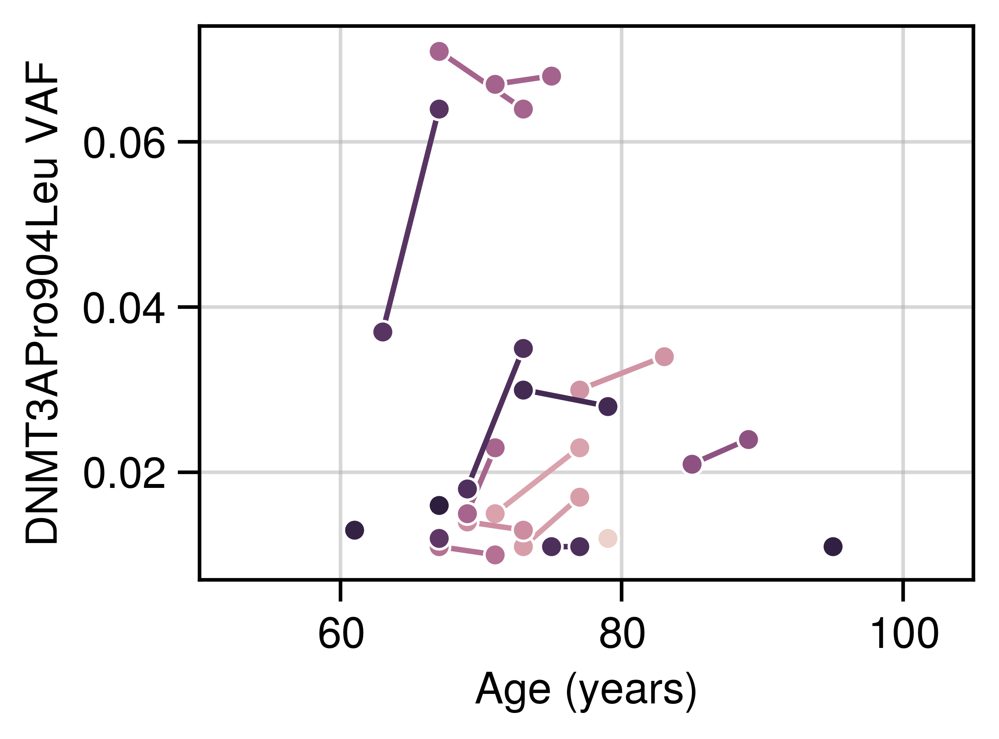

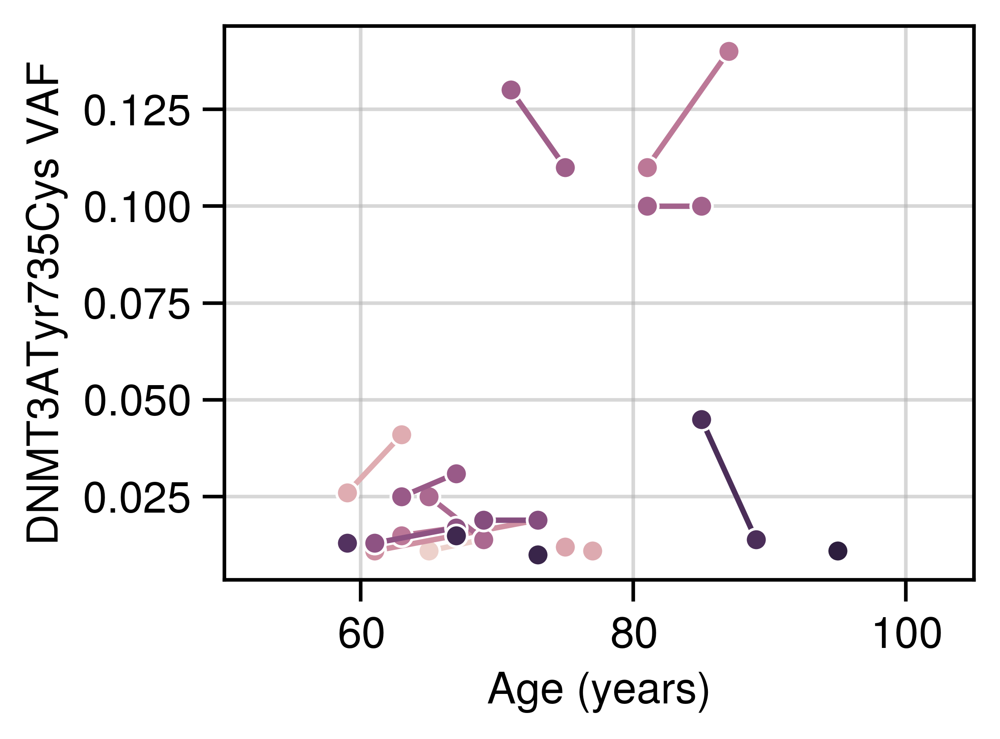

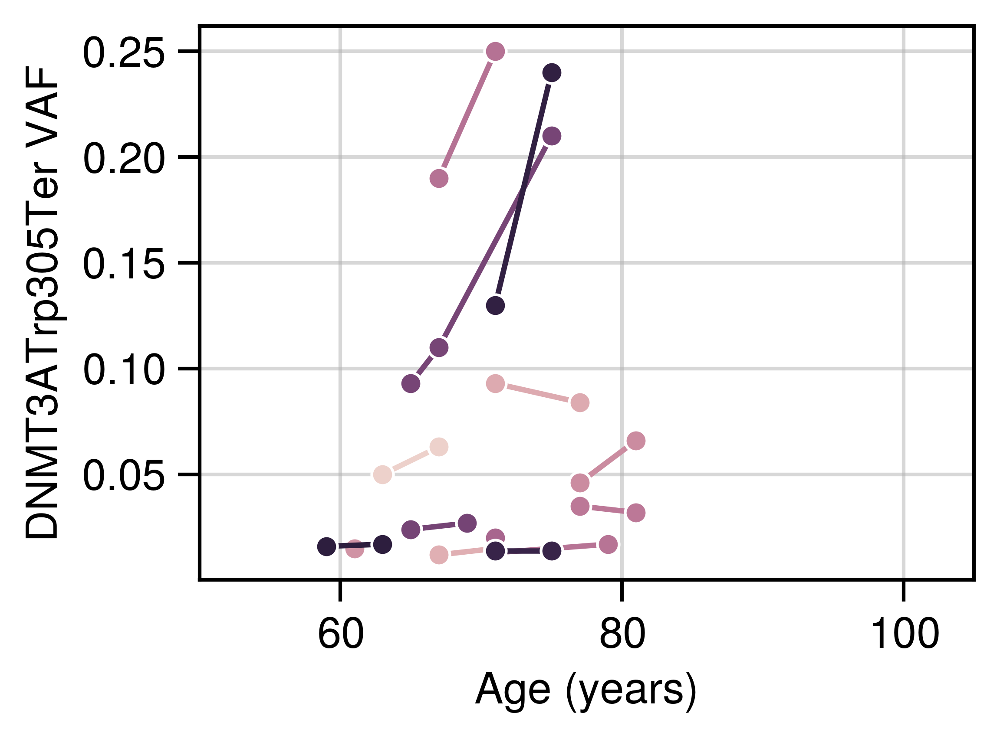

...

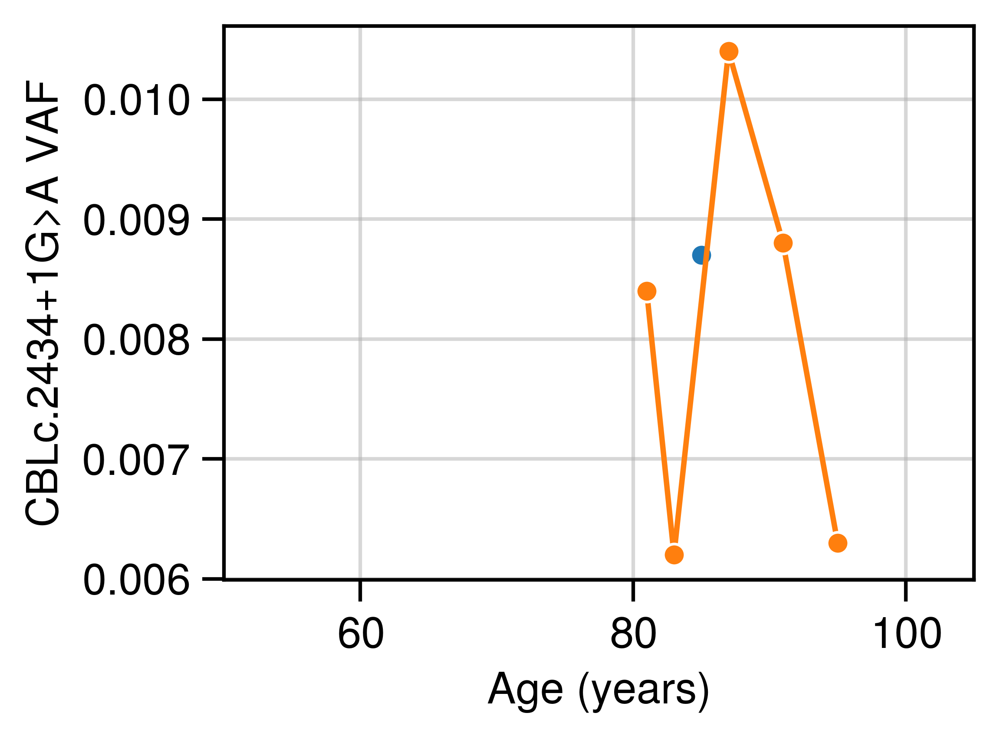

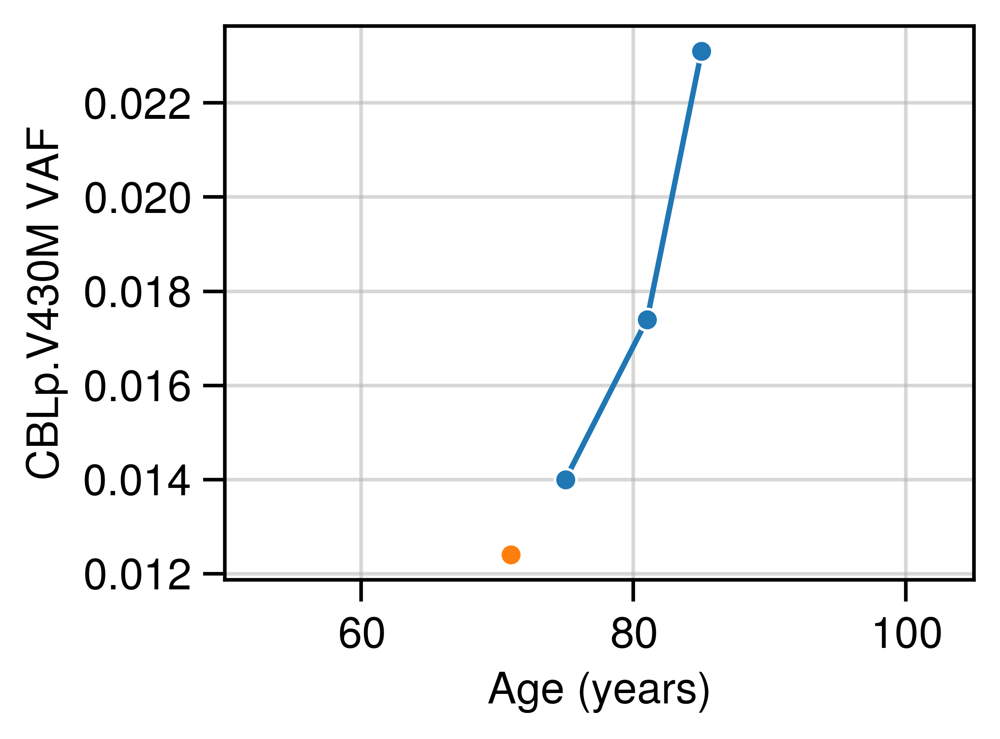

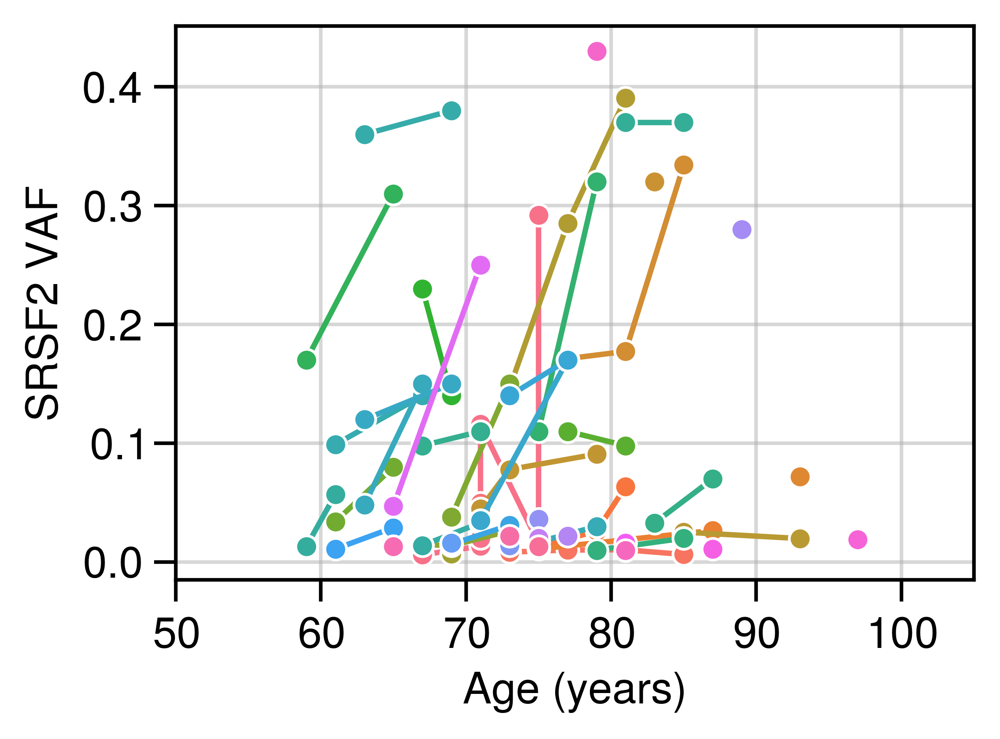

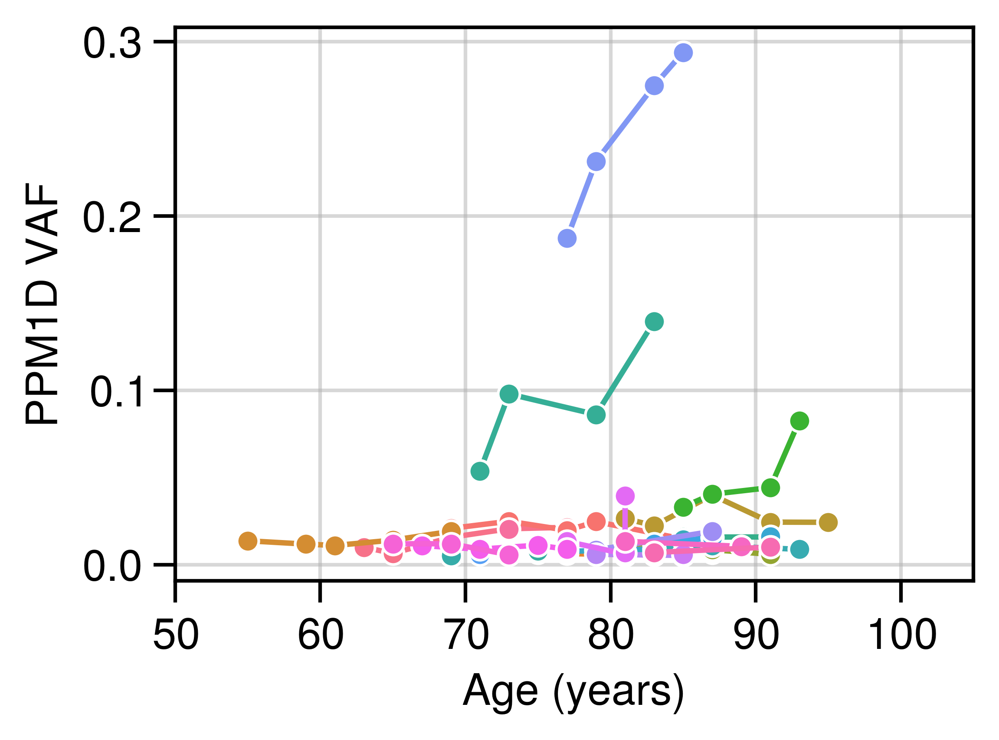

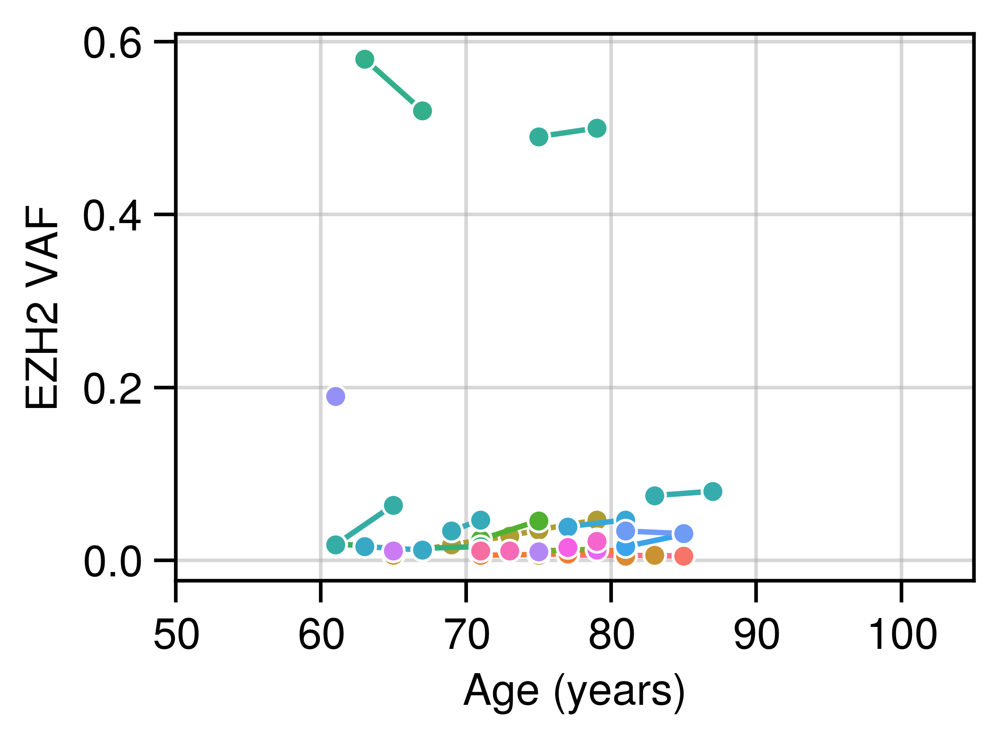

In [59]:
for gene in (
    data.loc[~data.is_sequencing_artefact].Gene.value_counts().head(n=10).index.tolist()
):
    gene_level = data.loc[(data["Gene"] == gene) & (~data.is_sequencing_artefact)]
    if gene_level.shape[0] > 100:
        muts2plot = (
            data.loc[(data["Gene"] == gene) & (~data.is_sequencing_artefact)]
            .AAChange.value_counts()
            .head()
            .index
        )
        toplot = [
            (
                gene_level[gene_level.AAChange == ele],
                gene + ele.rsplit(":", maxsplit=1)[-1] + " VAF",
            )
            for ele in muts2plot
        ]
    else:
        toplot = [(gene_level, gene + " VAF")]
    for toplt, lab in toplot:
        if toplt.shape[0] < 4:
            continue
        fig, ax = plt.subplots(1, 1, layout="tight", figsize=(4, 3))
        sns.lineplot(
            toplt,
            x="Age",
            y="VAF",
            hue="Id",
            marker=".",
            markersize=12,
            ax=ax,
            legend=False,
            estimator=None,
            color="blue",
        )
        ax.set_ylabel(lab)
        ax.set_xlabel("Age (years)")
        # ax.set_ylim([0, 0.4])
        ax.set_xlim([50, 105])
        # plt.savefig(f"JAK2_vaf.png", dpi=600)
        plt.show()